In [51]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader

import torchvision.transforms as transforms
import torchvision.utils
from torchvision.utils import make_grid

import torchvision.datasets

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,6)

from tqdm import tqdm

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


# Introduction to Generative Adversarial Networks (GANs)

In this notebook you will build a GAN from scratch, grossly following the DCGAN architecture.

**Goals:**


1.   Build a GAN arhictecture from scratch
2.   Write the GAN loss function and train GAN from scratch
3.   Have experience with some of the instability problems inherent with training GANs.
4.   [Bonus] Extend the unconditional GAN into a conditional GAN.



## 1. Getting Started

We will work with the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset. It contains 60,000 images size 28x28 of handwritten digits, from 0 to 9.

## 1. Dataloading

### 1.1 Define some hyperparameters and transforms


In [52]:
batch_size = 128 # Images per batch

# Resize to 32x32 for easier upsampling/downsampling
mytransform = transforms.Compose([transforms.Resize(32),
                                  transforms.ToTensor(),
                                 transforms.Normalize((.5), (.5))]) # normalize between [-1, 1] with tanh activation

mnist_train = torchvision.datasets.MNIST(root='.', download=True, transform=mytransform)

In [53]:
dataloader = DataLoader(dataset=mnist_train,
                         batch_size=batch_size,
                         shuffle=True)

In [54]:
# plot some images
real_batch, real_labels = next(iter(dataloader))

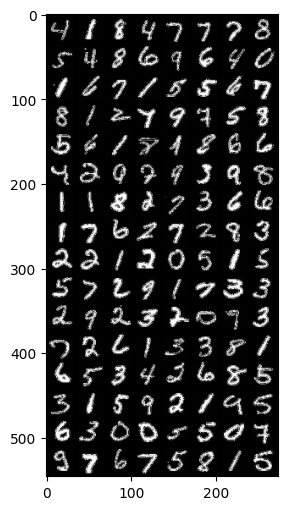

In [55]:
plt.imshow(transforms.ToPILImage()(make_grid(real_batch)))

## 2. Model Architecture

We will follow the general architecture of a DCGAN - or deep convolutional GAN. This [influential paper](https://arxiv.org/pdf/1511.06434v2.pdf) produced much of the foundation for modern GANs and how to train them.

(GANs are notoriously **hard** to train, we will try to get a feeling why in this notebook.)


Complete the function `get_upscaling_block`. Then, use the function to define our model defined as follows:

Input: Random "noise" $z$ shaped `[n_batch, n_z]`

Output: Generated image size `[n_batch, 1, 32, 32]` in range [-1, 1]

1. Reshape z into `[n_batch, n_z, 1, 1]` to make it into an "image"
2. First upscaling block $\rightarrow$ `[n_batch, ngf*4, 4, 4]`
3. Second upscaling block $\rightarrow$ `[n_batch, ngf*2, 8, 8]`
4. Third upscaling block $\rightarrow$ `[n_batch, ngf, 16, 16]`
5. Fourth (and last) upscaling block $\rightarrow$ `[n_batch, 1, 32, 32]`

## 2.1. The Generator



The generator performs subsequent upsampling blocks, transforming a latent vector shaped [batch_size, latent_size] into an image (values in [-1, 1]).

The generator block will consists of:
- Transpose Convolution
- Batch Norm
- ReLU

In [56]:
def get_upscaling_block(channels_in, channels_out, kernel, stride, padding, last_layer=False):
    '''
    Each transpose conv will be followed by BatchNorm and ReLU,
    except the last block (which is only followed by tanh)
    '''
    if last_layer:
        return nn.Sequential(
            nn.ConvTranspose2d(channels_in, channels_out, kernel, stride, padding),
            nn.Tanh()
        )
    else:
        return nn.Sequential(
            nn.ConvTranspose2d(channels_in, channels_out, kernel, stride, padding),
            nn.BatchNorm2d(channels_out),
            nn.ReLU()
        )



class Generator(nn.Module):
    def __init__(self, nz, ngf, nchannels=1):
        '''
        nz: The latent size (100 in our case)
        ngf: The channel-size before the last layer (32 our case)
        '''
        super().__init__()

        self.model = nn.Sequential(
          get_upscaling_block(nz, ngf * 4, kernel=4, stride=1, padding=0),  # Output: 4x4
          get_upscaling_block(ngf * 4, ngf * 2, kernel=4, stride=2, padding=1),  # Output: 8x8
          get_upscaling_block(ngf * 2, ngf, kernel=4, stride=2, padding=1),  # Output: 16x16
          get_upscaling_block(ngf, nchannels, kernel=4, stride=2, padding=1, last_layer=True)  # Output: 32x32
      )


    def forward(self, z):
        x = z.unsqueeze(2).unsqueeze(2) # give spatial dimensions to z
        return self.model(x)


### 2.1.3. Sanity Tests

In [57]:
nz = 1000
z = torch.randn(batch_size, nz)

In [58]:
G = Generator(nz=nz, ngf=16)
assert G(z).shape == (batch_size, 1, 32, 32)

G = Generator(nz=nz, ngf=16)
assert G(z).shape == (batch_size, 1, 32, 32)

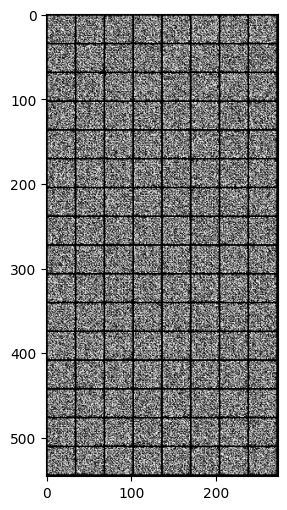

In [59]:
# visualize the output - at first it should just look like random noise!!
x_fake = G(z)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

## 2.2. The discriminator

The discriminator will be a mirror image of the generator.

The discriminator will also use a fully convolutional architecutre, with each block consisting of:
- Conv layer
- BatchNorm
- ReLU

Complete the function `get_downscaling_block` and then use it to define the following architecture for the discriminator:

Input: Image shaped `[n_batch, 1, 32, 32]` (in [-1, 1])
Output: Discriminator scores `[n_batch, 1]` in range [0, 1]

1. First downscaling block $\rightarrow$ `[n_batch, ndf, 16, 16]`
2. Second downscaling block $\rightarrow$ `[n_batch, ndf*2, 8, 8]`
3. Third downscaling block $\rightarrow$ `[n_batch, ndf*4, 4, 4]`
4. Last downscaling block $\rightarrow$ `[n_batch, 1]`

In [60]:
def get_downscaling_block(channels_in, channels_out, kernel, stride, padding, use_batch_norm=True, is_last=False):

    if is_last:
      return nn.Sequential(
          nn.Conv2d(channels_in, channels_out, kernel, stride, padding),
          nn.Sigmoid()
      )

    elif not use_batch_norm:
      return nn.Sequential(
          nn.Conv2d(channels_in, channels_out, kernel, stride, padding),
          nn.ReLU(0.2)
      )

    else:
      return nn.Sequential(
          nn.Conv2d(channels_in, channels_out, kernel, stride, padding),
          nn.BatchNorm2d(channels_out),
          nn.ReLU(0.2)
      )


class Discriminator(nn.Module):
    def __init__(self, ndf, nchannels=1):
        super().__init__()

        self.model = nn.Sequential(
            get_downscaling_block(nchannels, ndf, kernel=4, stride=2, padding=1),
            get_downscaling_block(ndf, ndf*2, kernel=4, stride=2, padding=1),
            get_downscaling_block(ndf*2, ndf*4, kernel=4, stride=2, padding=1),
            get_downscaling_block(ndf*4, 1, kernel=4, stride=1, padding=0, is_last=True)
        )

    def forward(self, x):
        return self.model(x).squeeze(1).squeeze(1) # remove spatial dimensions

### 2.2.3 Sanity Checking

In [61]:
real_batch, real_labels = next(iter(dataloader))

In [62]:
D = Discriminator(ndf=32, nchannels=1)
assert D(real_batch).shape == (real_batch.shape[0], 1)

# 3. Training

## 3.1 Loss
The essential thing to remember is that the logistic and the non-saturating logistic GAN losses can be written exclusively using the [binary cross entropy loss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html). Our GAN loss will be defined ONLY using the following criterion:



In [63]:
criterion = nn.BCELoss() # we will build off of this to make our final GAN loss!

## 3.2 Helper functions

We will need a few helper functions.
1. First, we need to continuously sample z from a Gaussian distribution.
2. Secondly, we need to make our "ground-truth" labels when using the BCE loss. This should output vectors of either 0s or 1s.

In [64]:
def sample_z(batch_size, nz):
    return torch.randn(batch_size, nz, device=device)

# this is for the real ground-truth label
def get_labels_one(batch_size):
    r = torch.ones(batch_size, 1)
    return r.to(device)

# this is for the generated ground-truth label
def get_labels_zero(batch_size):
    r = torch.zeros(batch_size, 1)
    return r.to(device)


# To initialize the weights of a GAN, the DCGAN paper found that best results are obtained
# with Gaussian initialization with mean=0; std=0.02
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# for visualization
to_pil = transforms.ToPILImage()
renorm = transforms.Normalize((-1.), (2.))

## 3.3 Creating the optimizers and hyperparameters

The original DCGAN paper shows that Adam works well in the generator and the discriminator with a learning rate of 0.0002 and Beta1 = 0.5.

Define your optimizers

In [65]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))


## 3.3 Training!

Now for the fun part, training!
Training a GAN consists in making an update to the discriminator, then the generator.
Training a GAN requires BABYSITTING!! Remember that many things can go wrong when training a GAN:
- The discriminator is too strong for the generator - the generator cannot improve.
- The generator easily fools the discriminator - cannot learn.
- Mode collapse - generator is not capable of generating diverse images.

it: 0; g_loss: 0.84345942735672; d_loss: 1.4556652307510376; avg_real_score: 0.5686994194984436; avg_fake_score: 0.4452877640724182: : 0it [00:00, ?it/s]

generated images


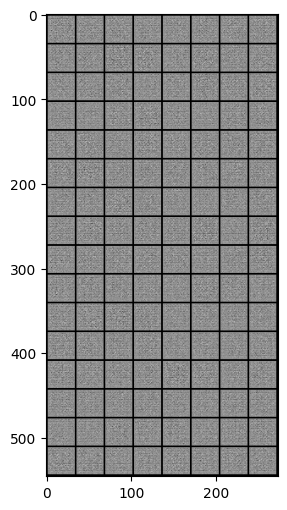

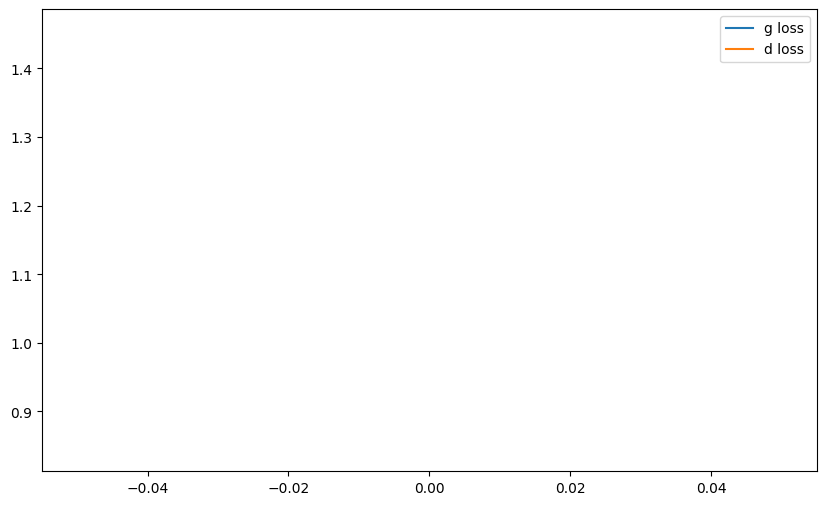

it: 200; g_loss: 2.376526355743408; d_loss: 0.24209927022457123; avg_real_score: 0.8570442199707031; avg_fake_score: 0.11200419068336487: : 200it [00:24, 11.31it/s] 

generated images


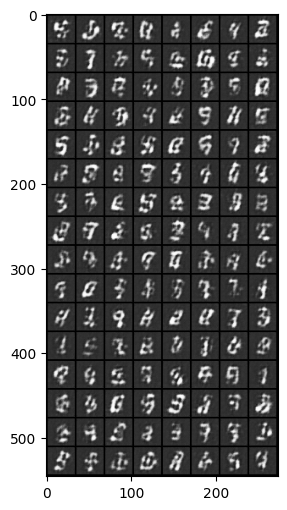

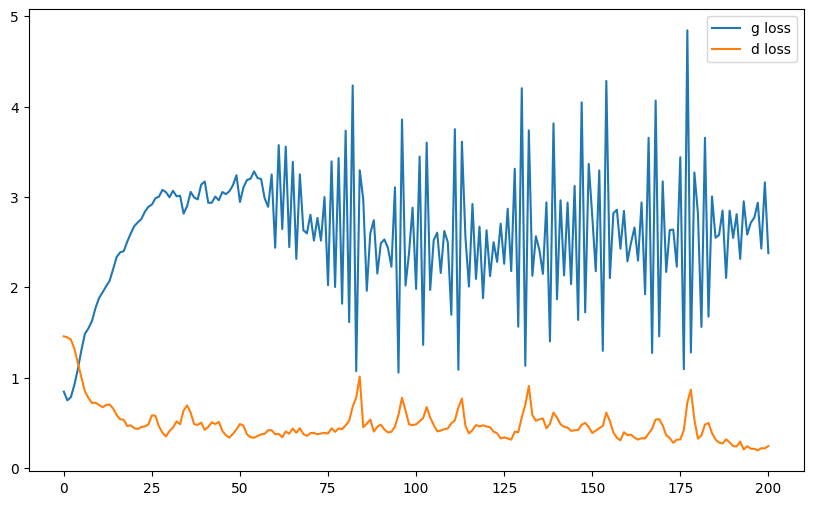

it: 400; g_loss: 2.4542574882507324; d_loss: 0.2692612111568451; avg_real_score: 0.8854146003723145; avg_fake_score: 0.1044863685965538: : 399it [00:44, 10.43it/s]  

generated images


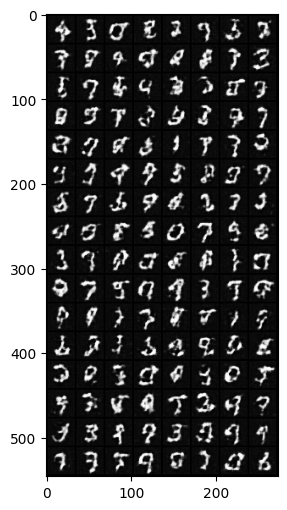

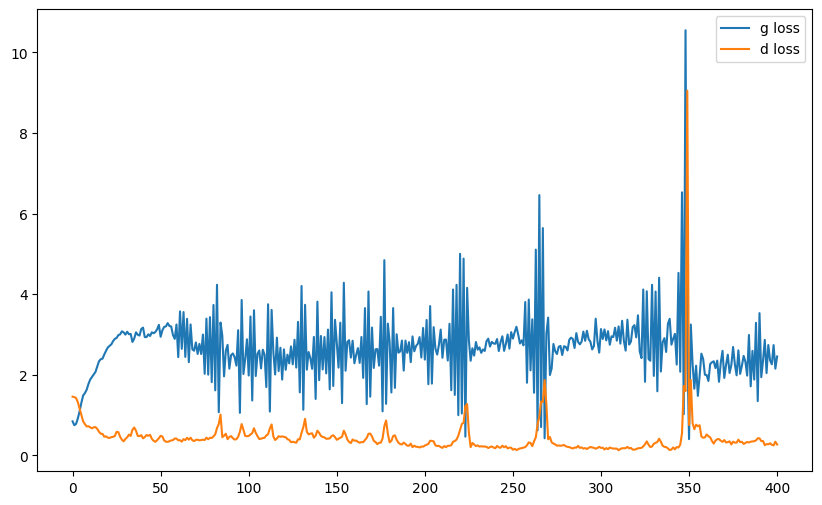

it: 468; g_loss: 1.5428580045700073; d_loss: 0.6276954412460327; avg_real_score: 0.7585223913192749; avg_fake_score: 0.23862731456756592: : 469it [00:51,  9.18it/s]
it: 469; g_loss: 1.9826277494430542; d_loss: 0.6438954472541809; avg_real_score: 0.8008533716201782; avg_fake_score: 0.1614294946193695: : 0it [00:00, ?it/s]

generated images


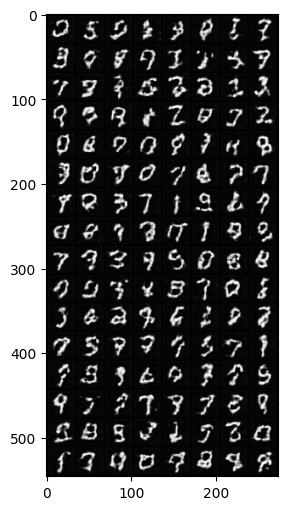

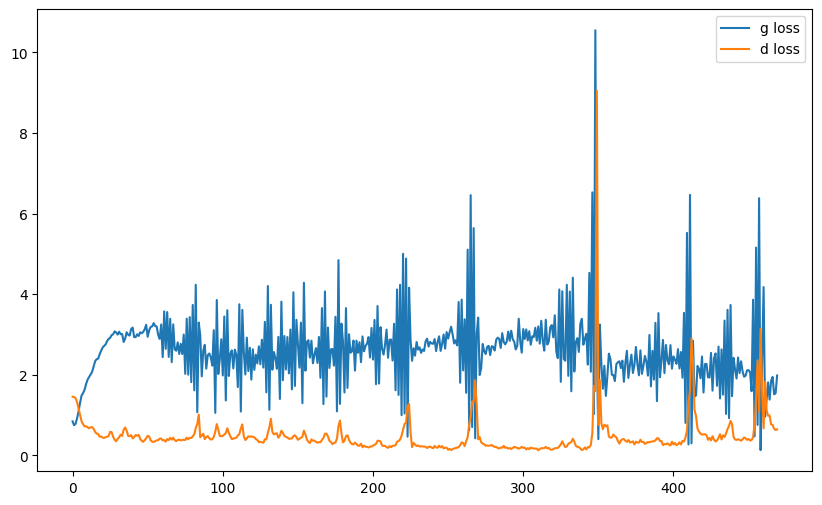

it: 669; g_loss: 1.7901310920715332; d_loss: 1.1824276447296143; avg_real_score: 0.9486821293830872; avg_fake_score: 0.19841033220291138: : 200it [00:20, 10.89it/s]

generated images


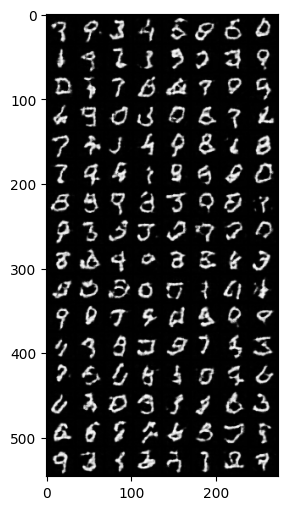

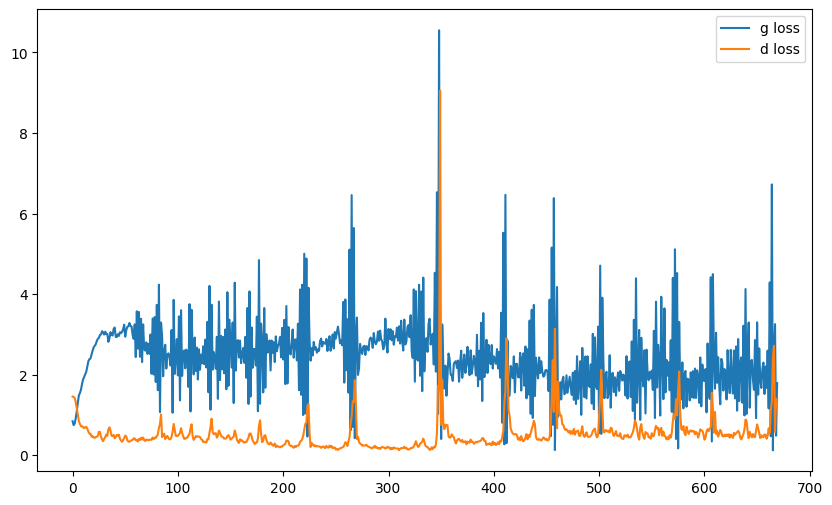

it: 869; g_loss: 1.4226975440979004; d_loss: 0.5238400101661682; avg_real_score: 0.7593645453453064; avg_fake_score: 0.280092716217041: : 400it [00:40, 10.73it/s]  

generated images


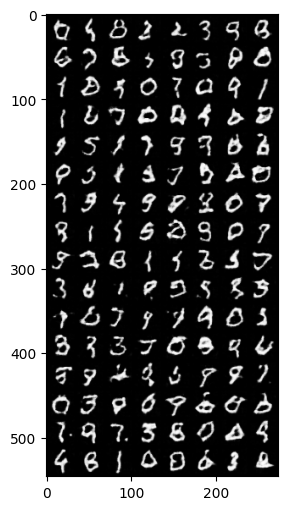

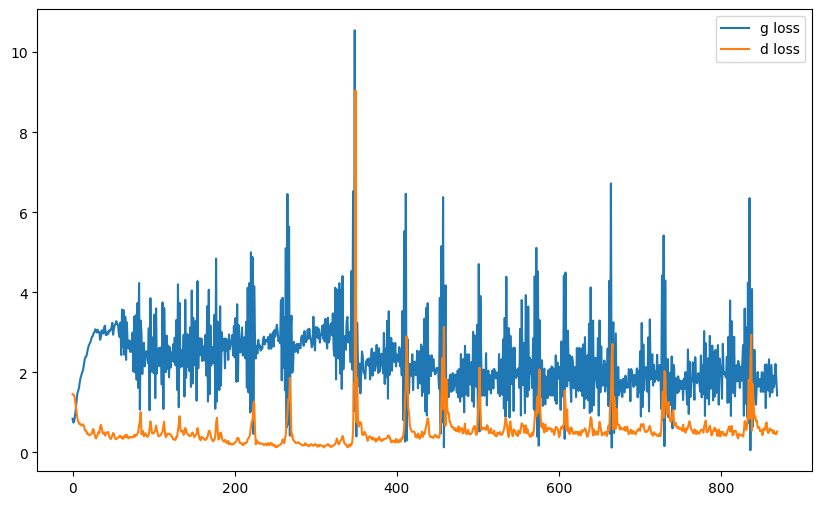

it: 937; g_loss: 2.870934009552002; d_loss: 1.7775301933288574; avg_real_score: 0.9922997355461121; avg_fake_score: 0.07366901636123657: : 469it [00:47,  9.83it/s]
it: 938; g_loss: 2.7049059867858887; d_loss: 0.6427510976791382; avg_real_score: 0.665429949760437; avg_fake_score: 0.08380282670259476: : 0it [00:00, ?it/s]

generated images


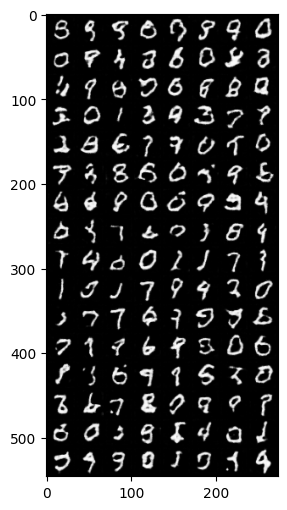

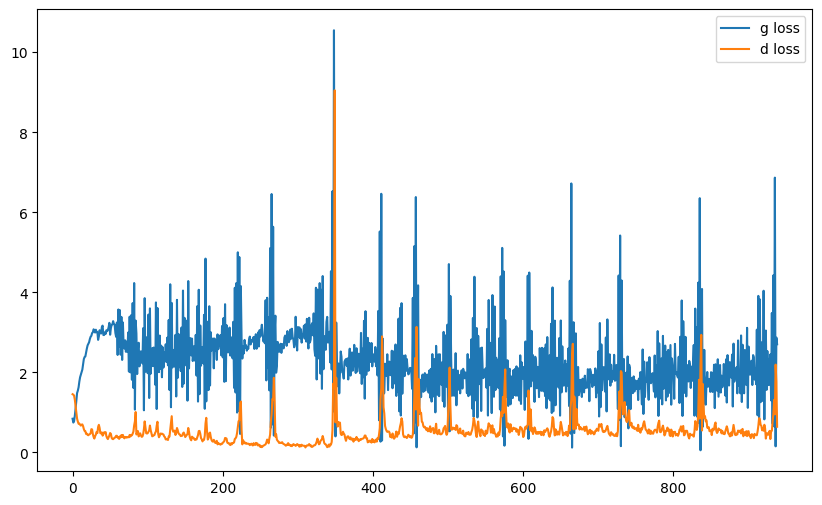

it: 1138; g_loss: 1.836394190788269; d_loss: 0.44303011894226074; avg_real_score: 0.7848365902900696; avg_fake_score: 0.20056898891925812: : 200it [00:21,  7.82it/s]

generated images


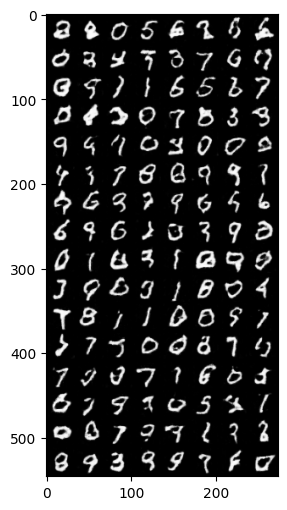

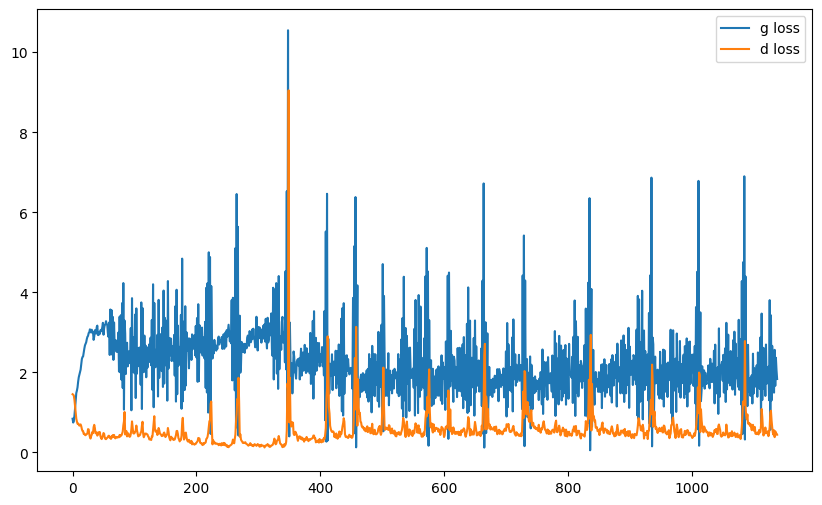

it: 1338; g_loss: 2.6994822025299072; d_loss: 0.3532060980796814; avg_real_score: 0.8351691961288452; avg_fake_score: 0.08632786571979523: : 399it [00:42, 10.13it/s]

generated images


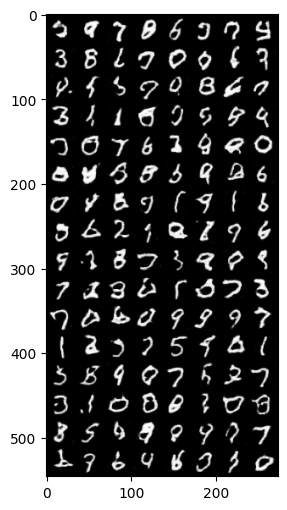

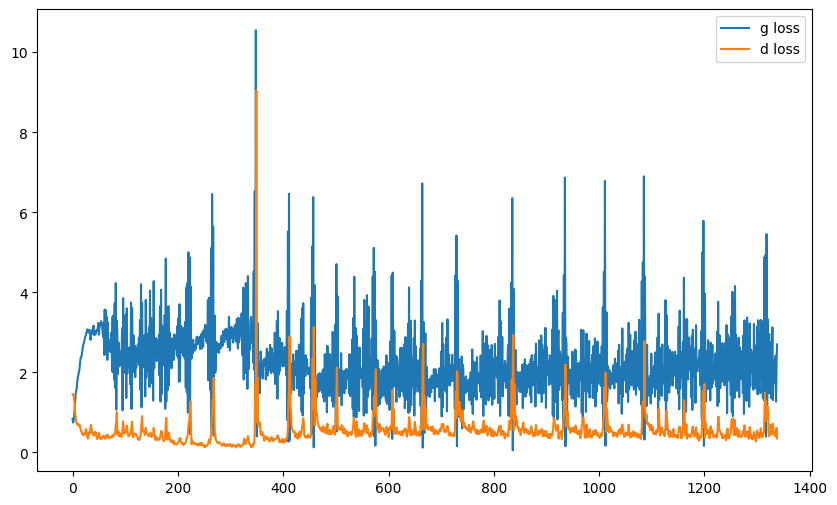

it: 1406; g_loss: 1.7136693000793457; d_loss: 0.5030768513679504; avg_real_score: 0.7393800616264343; avg_fake_score: 0.21649739146232605: : 469it [00:51,  9.19it/s]
it: 1407; g_loss: 2.1441149711608887; d_loss: 0.49711209535598755; avg_real_score: 0.8457901477813721; avg_fake_score: 0.1423557996749878: : 0it [00:00, ?it/s]

generated images


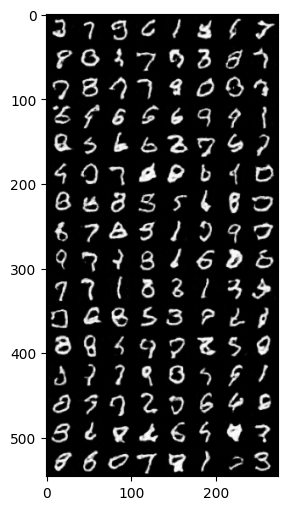

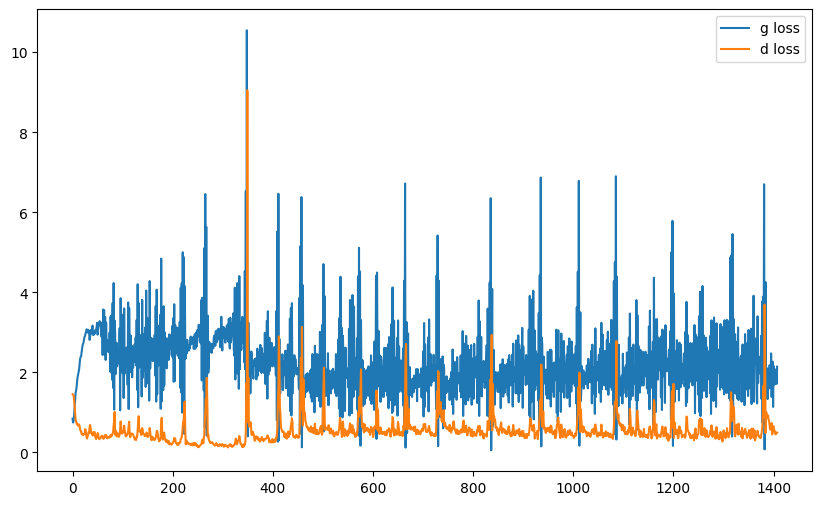

it: 1607; g_loss: 1.1974687576293945; d_loss: 0.5241173505783081; avg_real_score: 0.6600275039672852; avg_fake_score: 0.3534533381462097: : 200it [00:22,  8.19it/s] 

generated images


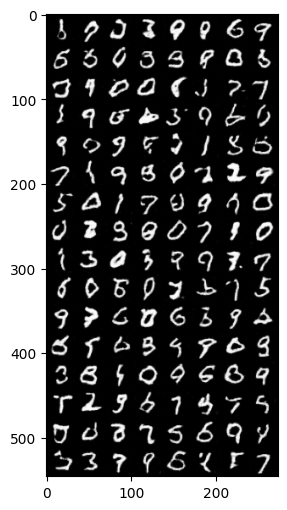

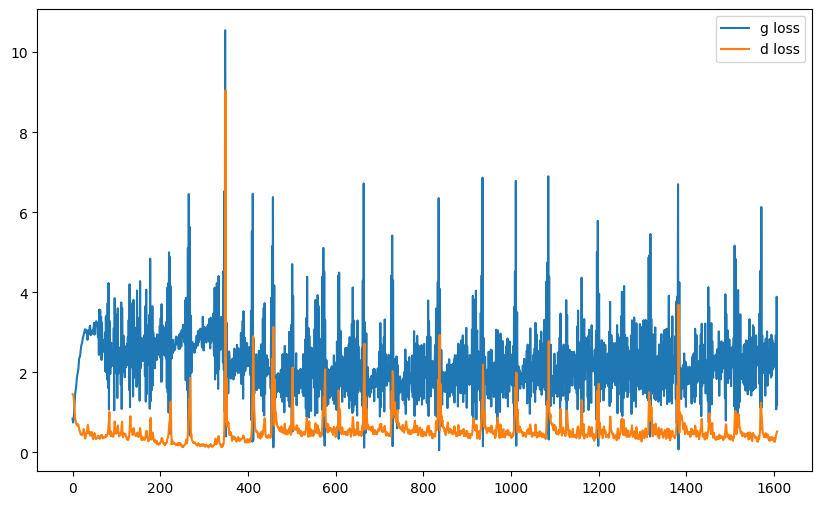

it: 1807; g_loss: 1.708366870880127; d_loss: 0.4054957330226898; avg_real_score: 0.7978023886680603; avg_fake_score: 0.22425836324691772: : 400it [00:46,  9.35it/s]

generated images


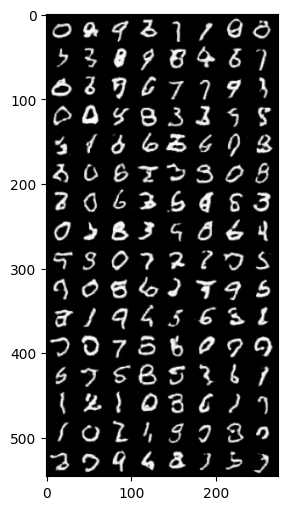

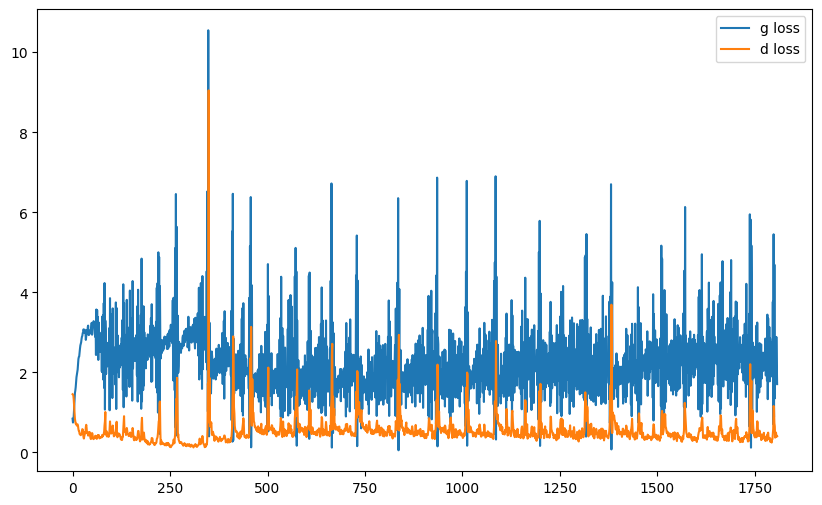

it: 1875; g_loss: 0.7118569612503052; d_loss: 1.641340732574463; avg_real_score: 0.2894969582557678; avg_fake_score: 0.5240606069564819: : 469it [00:55,  8.49it/s]
it: 1876; g_loss: 6.378572463989258; d_loss: 1.1125317811965942; avg_real_score: 0.9770102500915527; avg_fake_score: 0.0026493393816053867: : 0it [00:00, ?it/s]

generated images


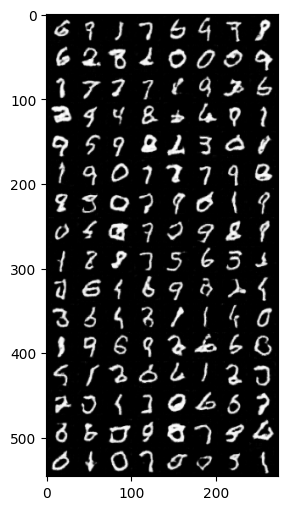

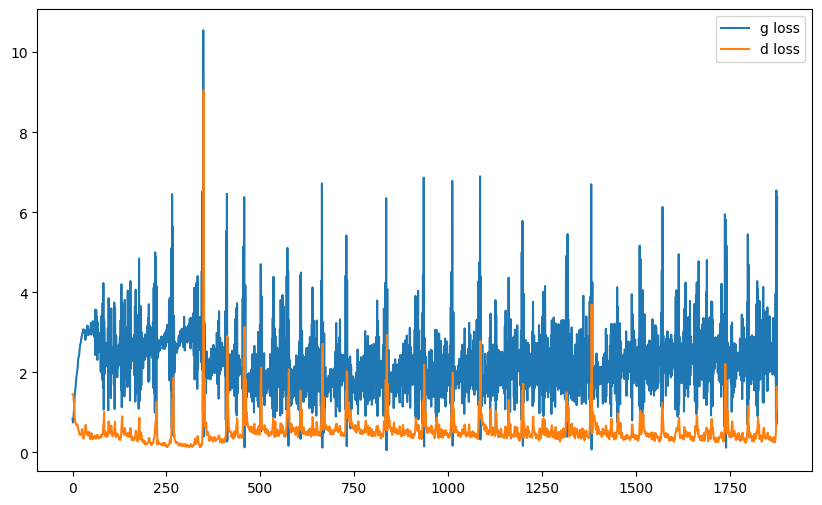

it: 2076; g_loss: 2.775895595550537; d_loss: 0.4502714276313782; avg_real_score: 0.8777526021003723; avg_fake_score: 0.08505941927433014: : 200it [00:28,  3.68it/s]  

generated images


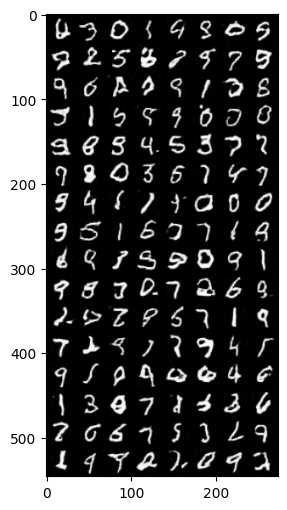

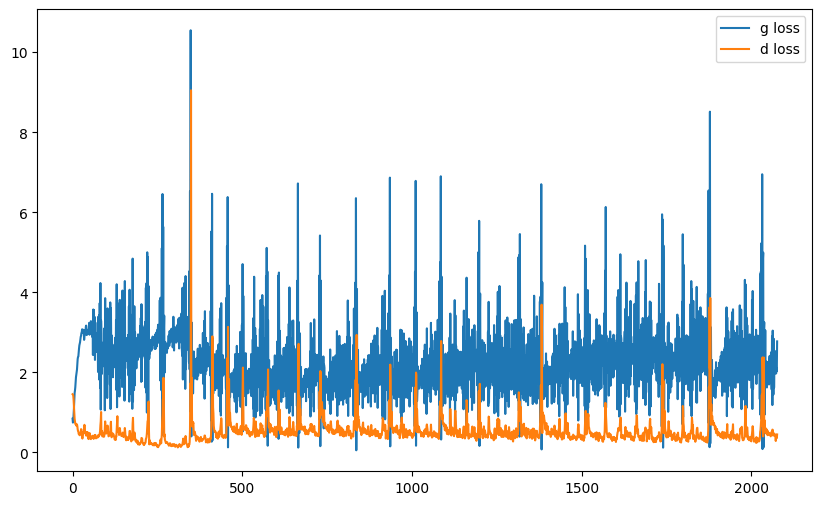

it: 2276; g_loss: 3.4590272903442383; d_loss: 0.26873016357421875; avg_real_score: 0.8644639253616333; avg_fake_score: 0.04759206622838974: : 400it [00:56,  8.84it/s]

generated images


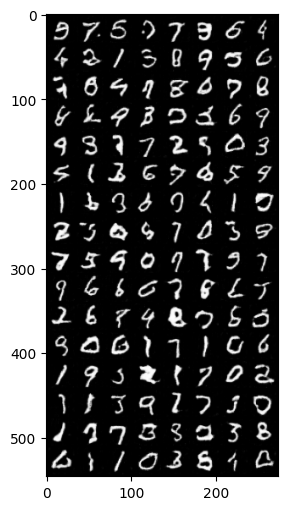

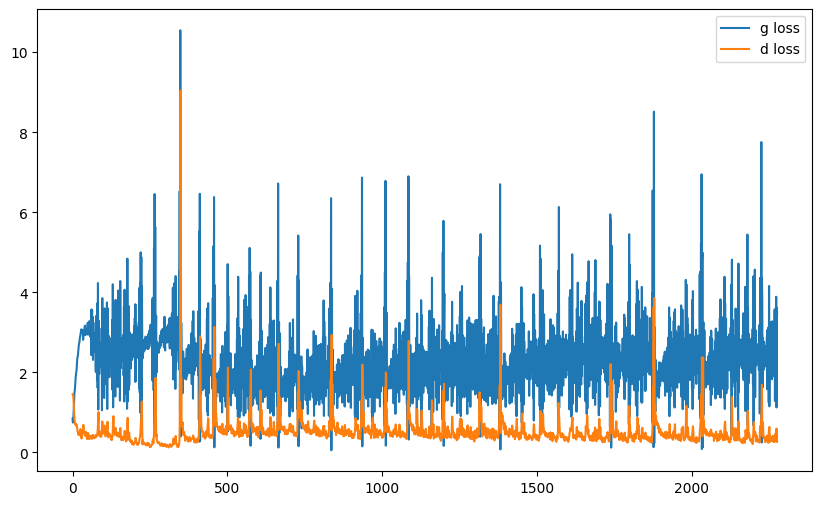

it: 2344; g_loss: 2.8060507774353027; d_loss: 0.3168303370475769; avg_real_score: 0.8623907566070557; avg_fake_score: 0.08447390794754028: : 469it [01:04,  7.25it/s]


In [66]:
torch.autograd.set_detect_anomaly(True)

nb_epochs = 5

g_losses = []
d_losses = []


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]

        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im)




        ###
        ### Discriminator
        ###

        d_loss = criterion(yhat_real, get_labels_one(cur_batch_size)) + criterion(yhat_fake, get_labels_zero(cur_batch_size))
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()


        ###
        ### Generator
        ###

        yhat_fake = netD(fake_im)

        g_loss = criterion(yhat_fake, get_labels_one(cur_batch_size))
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            #fake_im = G(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

# Question 4
*Comment on the training of of the GAN with the default settings (progress of the generations, the loss, stability, image diversity, etc.)*

---------

The training of the GAN shows a clear progression toward generating realistic MNIST digits, but it also highlights some challenges that are common in adversarial training. Initially, the generated images are almost indistinguishable from noise, reflecting the generator's lack of understanding of the data distribution. As training progresses, the generator begins to produce outputs that loosely resemble digits, and eventually, by later iterations, the image become clearer, more distinct and diverse. Most digits from 0 to 9 are represented, though certain numbers, like 1s and 7s, seem to appear more consistently or are better defined than others.

Looking at the loss curves, we observe that both the generator loss *g_loss* and discriminator loss *d_loss* oscillate throughtout the training. This oscialltoryu behavuioir is expected in GANs due to the adversaraial nature pf their optimization process, where the gernerator and discriminator are constantly competing. However, the sharp spikes in *g_loss* suggest that the generator struggles at times to produce convincing images, particularly when the discriminator becomes very effective at distinguishing real from fake. The discriminator loss, on the other hand, remains consistentlu low, indicating that it often has an easier task compared to the generator. This disparity between *g_loss* and *d_loss* is a sign that the discriminator is dominating the training, which may slow down the generator's process.

Despite these challenges, the GAN does not diverge, and the gemerated imahes continue to improve in quality. The overall stability of training is acceptable, but there is a noticeable imbalance between the generator and discriminator. The discriminator appears to classify real images with very high confidence, as indicated by the consistently high average real scre, while it confidently rejkects fake images with a low average fake score. This dominance of the discriminatory may explain the relatively high generator loss throughout the training.

In terms of the final results, the GAN produces images that are recognizable and diverse. By the later stages of training, the outputs are well-formed digits, demonstrating that the generator has successfully learned the data distribution. However, some digits remain slightly blurry or malformed, and there is room for improvement in overall sharpness and consistency.

In conclusion, while the GAN achieves its goal of generating realistic MNIST digits, the training process could be fine-tuned to achieve faster convergence, reduced oscillations in the loss curves and improved image quality. With these adjustments, the GAN could more effectively balance the adversarial game and yield even better results.


# Question 5

*Comment on the diverse experiences that you have performed with the suggestions above. In particular, comment on the stability on training, the losses, the diversity of generated images, etc.*

------

## Modifying ngf or ndf. In particular reduce or increase one of the two significantly

it: 0; g_loss: 0.8990357518196106; d_loss: 1.8107998371124268; avg_real_score: 0.32220709323883057; avg_fake_score: 0.418664813041687: : 0it [00:00, ?it/s]

generated images


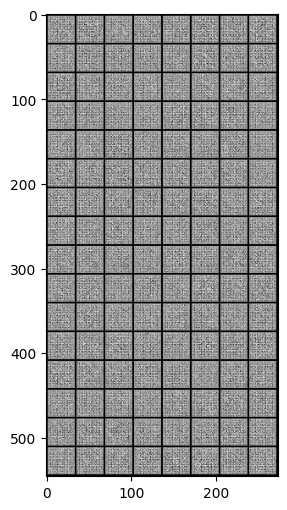

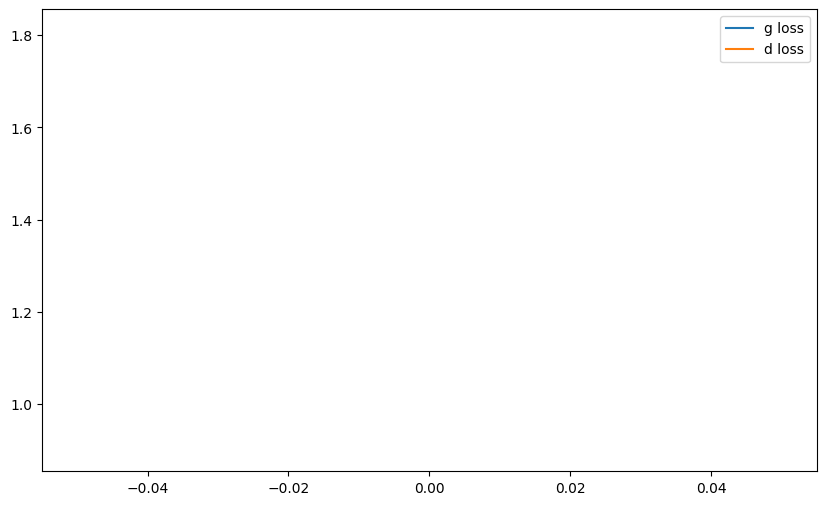

it: 200; g_loss: 1.2167876958847046; d_loss: 1.0428814888000488; avg_real_score: 0.544424295425415; avg_fake_score: 0.3149094581604004: : 199it [00:22,  9.66it/s]

generated images


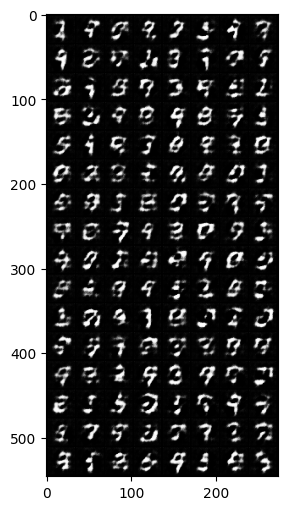

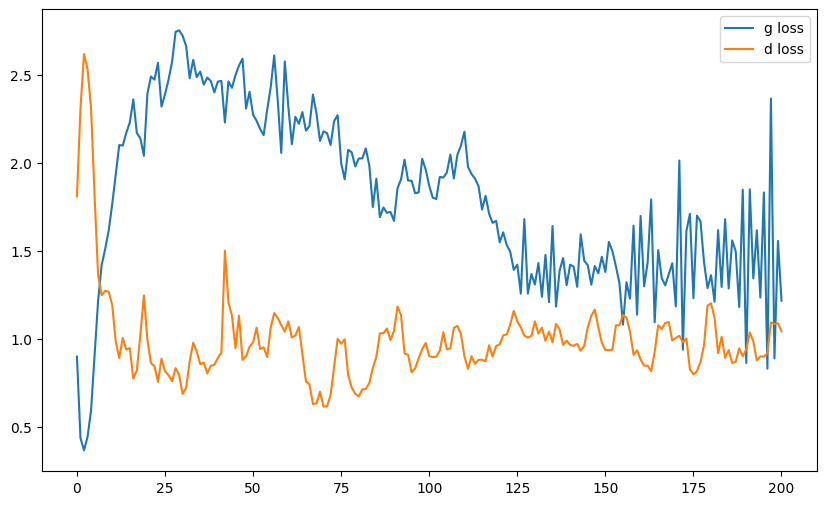

it: 400; g_loss: 1.2312191724777222; d_loss: 0.8976422548294067; avg_real_score: 0.544313907623291; avg_fake_score: 0.3067030906677246: : 400it [00:44,  9.43it/s]  

generated images


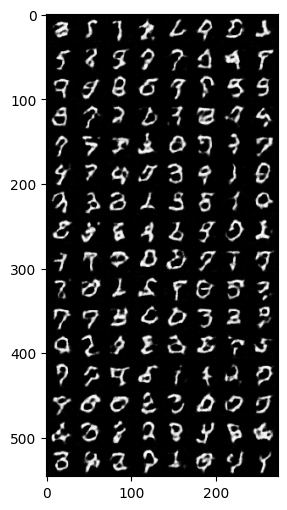

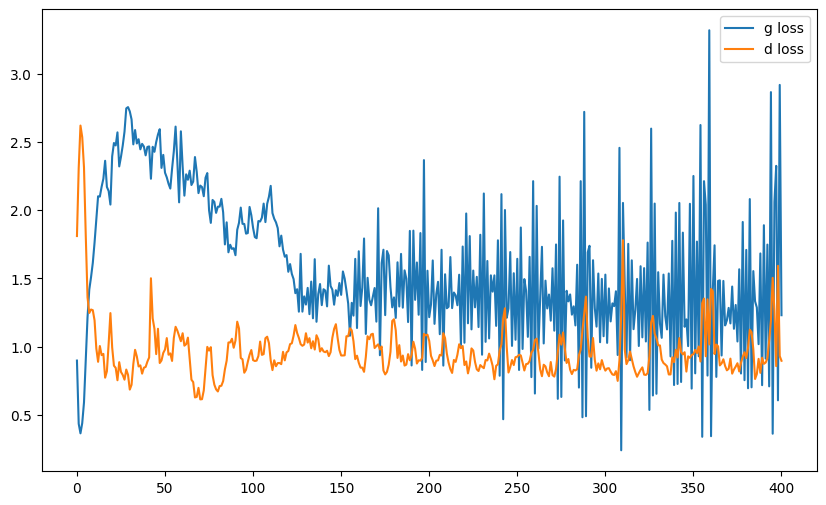

it: 468; g_loss: 1.067408561706543; d_loss: 0.7433750629425049; avg_real_score: 0.638105571269989; avg_fake_score: 0.3610057830810547: : 469it [00:53,  8.84it/s]
it: 469; g_loss: 1.5320589542388916; d_loss: 0.8538690209388733; avg_real_score: 0.7544552087783813; avg_fake_score: 0.23278729617595673: : 0it [00:00, ?it/s]

generated images


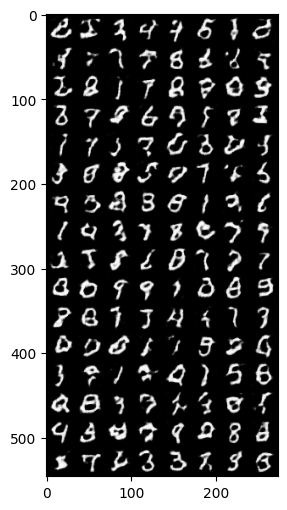

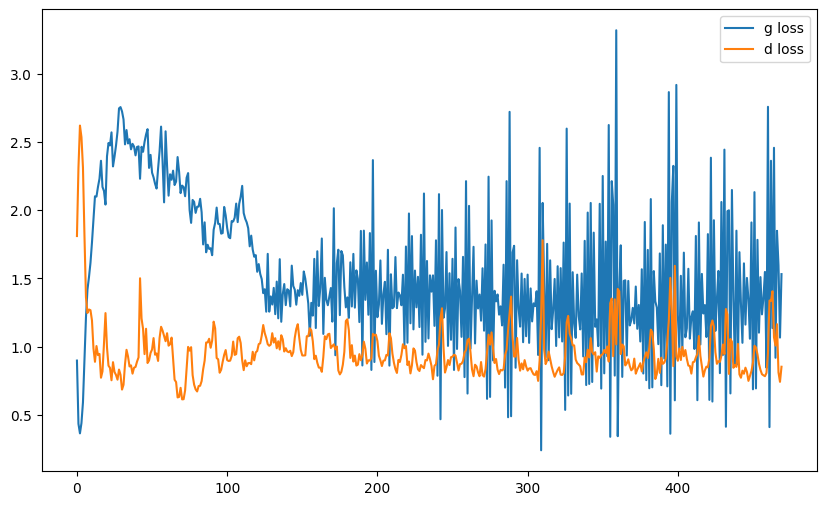

it: 669; g_loss: 1.9880976676940918; d_loss: 0.9285811185836792; avg_real_score: 0.8332350850105286; avg_fake_score: 0.15408045053482056: : 200it [00:24,  6.74it/s]

generated images


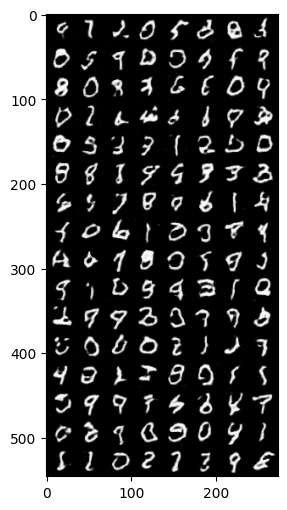

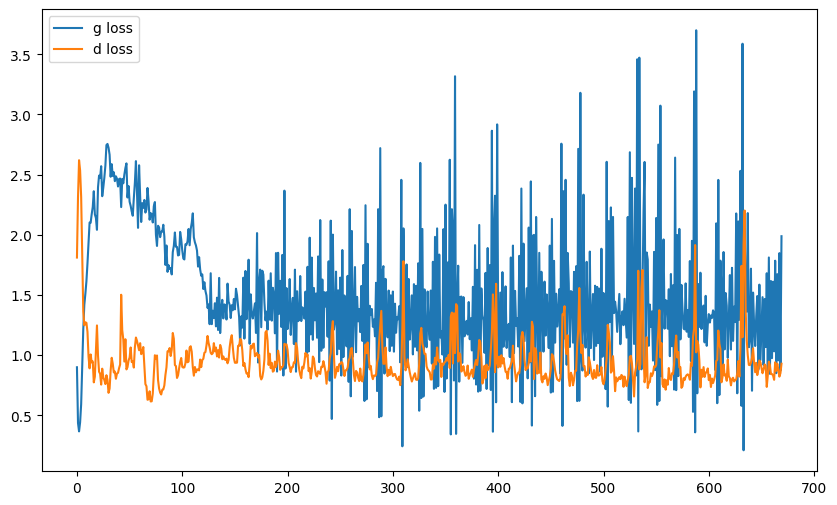

it: 869; g_loss: 0.8490380048751831; d_loss: 0.7295898795127869; avg_real_score: 0.6021682620048523; avg_fake_score: 0.4537641406059265: : 400it [00:49,  8.52it/s] 

generated images


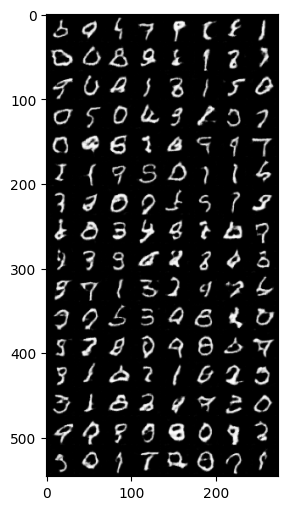

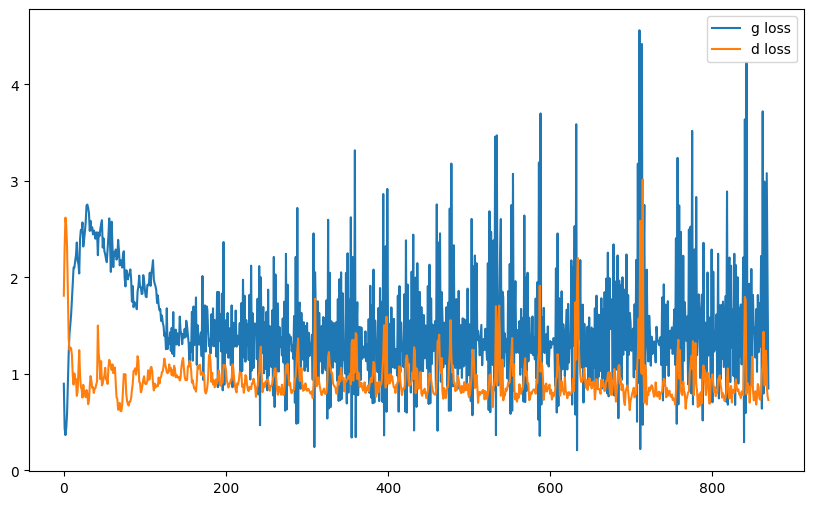

it: 937; g_loss: 1.4114131927490234; d_loss: 0.8808602690696716; avg_real_score: 0.5716566443443298; avg_fake_score: 0.26693910360336304: : 469it [00:58,  8.00it/s]
it: 938; g_loss: 1.0215764045715332; d_loss: 0.9441100358963013; avg_real_score: 0.5662339329719543; avg_fake_score: 0.3825463652610779: : 0it [00:00, ?it/s]

generated images


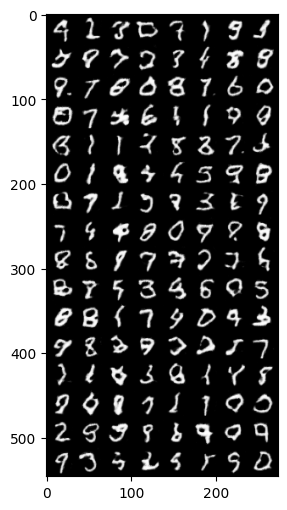

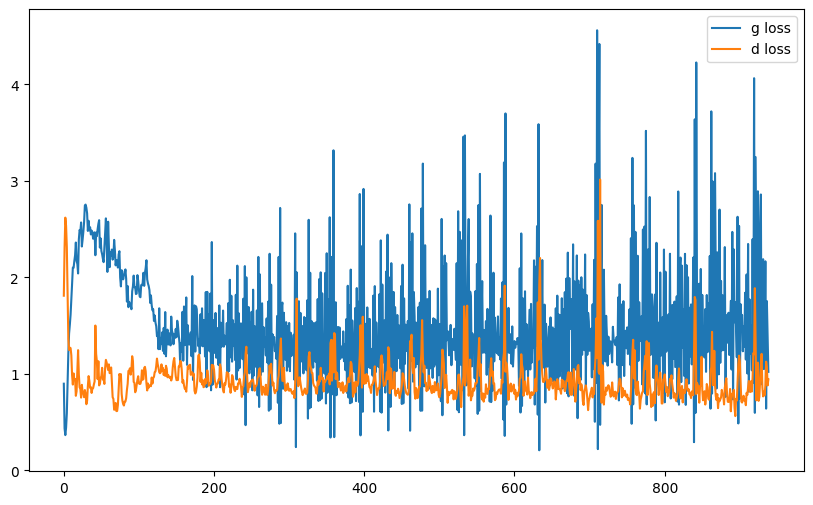

it: 1138; g_loss: 2.0735528469085693; d_loss: 0.8002568483352661; avg_real_score: 0.7561113238334656; avg_fake_score: 0.1423543244600296: : 200it [00:25,  9.00it/s]

generated images


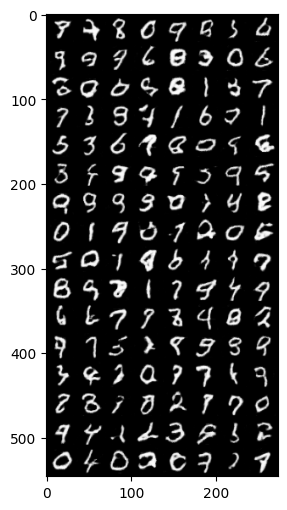

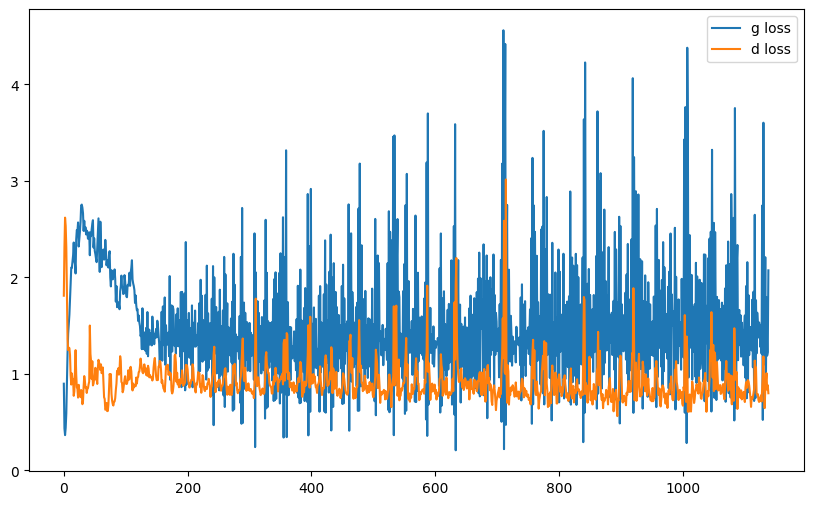

it: 1338; g_loss: 0.9534323215484619; d_loss: 0.8828030228614807; avg_real_score: 0.5571409463882446; avg_fake_score: 0.4174080491065979: : 400it [00:49,  8.72it/s]

generated images


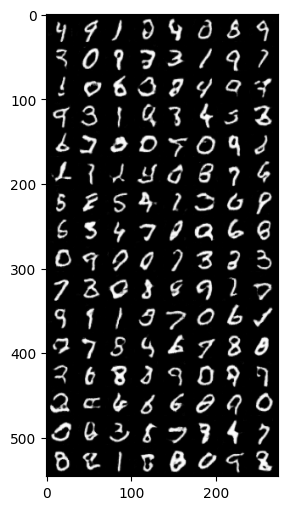

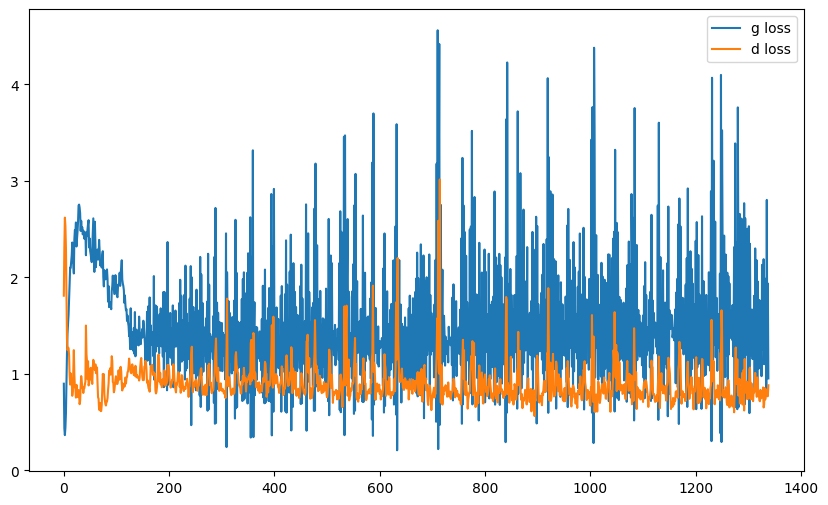

it: 1406; g_loss: 1.5972363948822021; d_loss: 0.8564704656600952; avg_real_score: 0.7966535091400146; avg_fake_score: 0.23353368043899536: : 469it [00:58,  8.02it/s]
it: 1407; g_loss: 1.944807529449463; d_loss: 0.5817603468894958; avg_real_score: 0.74347984790802; avg_fake_score: 0.1668289601802826: : 0it [00:00, ?it/s]

generated images


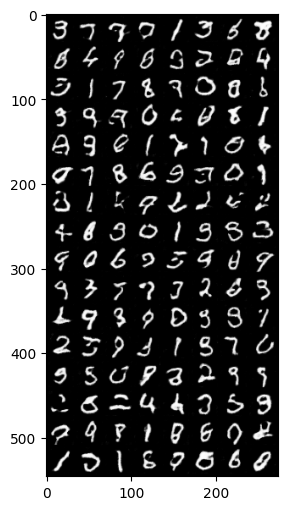

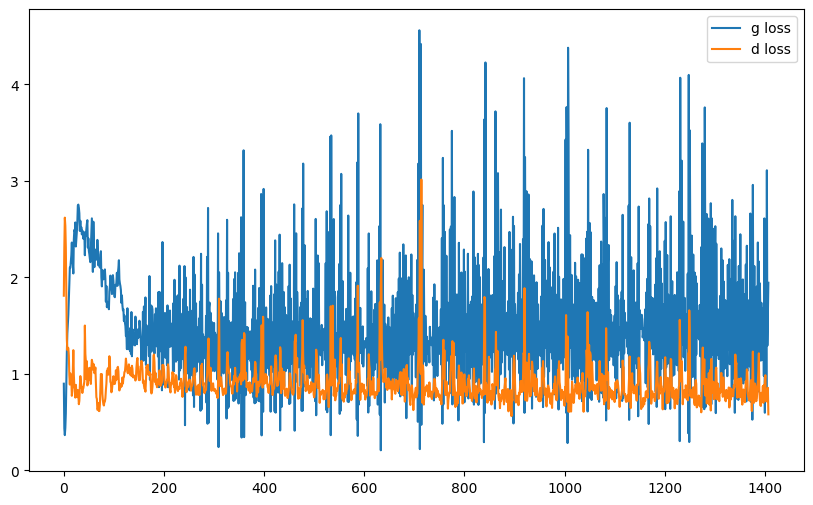

it: 1607; g_loss: 1.2055432796478271; d_loss: 0.7249009609222412; avg_real_score: 0.6797806024551392; avg_fake_score: 0.3270450532436371: : 200it [00:25,  8.55it/s] 

generated images


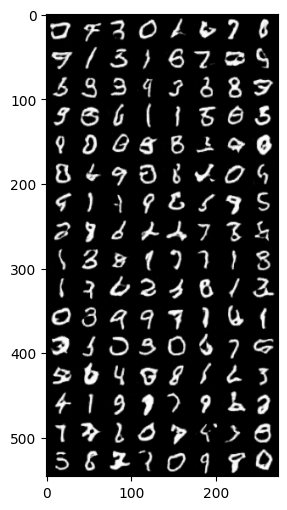

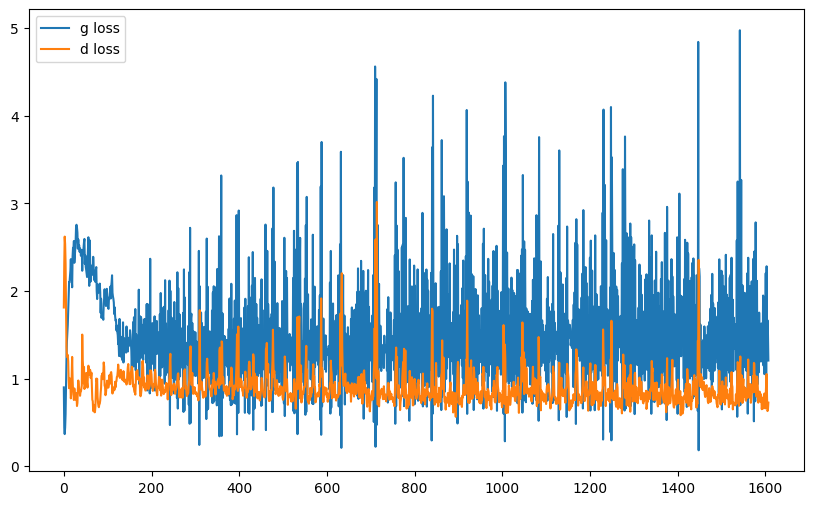

it: 1807; g_loss: 1.9674556255340576; d_loss: 0.7043505907058716; avg_real_score: 0.7303407192230225; avg_fake_score: 0.16389606893062592: : 400it [00:51,  8.44it/s]

generated images


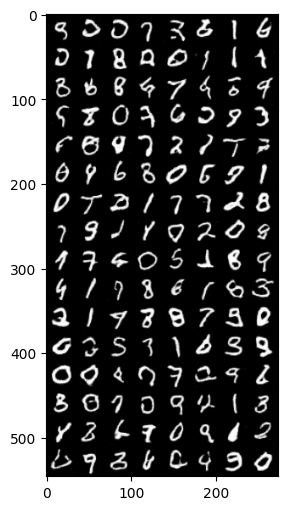

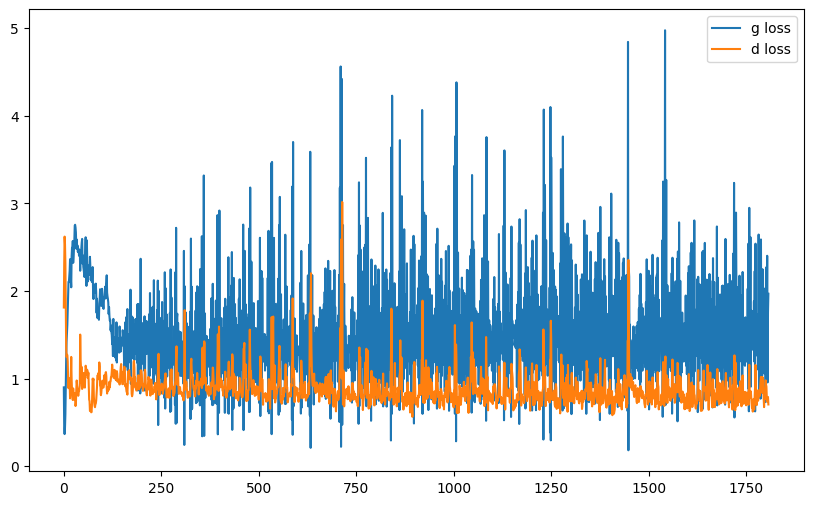

it: 1875; g_loss: 2.093409538269043; d_loss: 0.9853116273880005; avg_real_score: 0.7972326278686523; avg_fake_score: 0.1490284651517868: : 469it [01:01,  7.66it/s]
it: 1876; g_loss: 2.722141981124878; d_loss: 0.7284443378448486; avg_real_score: 0.7732989192008972; avg_fake_score: 0.07975725829601288: : 0it [00:00, ?it/s]

generated images


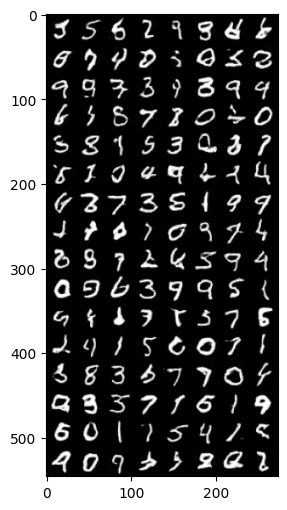

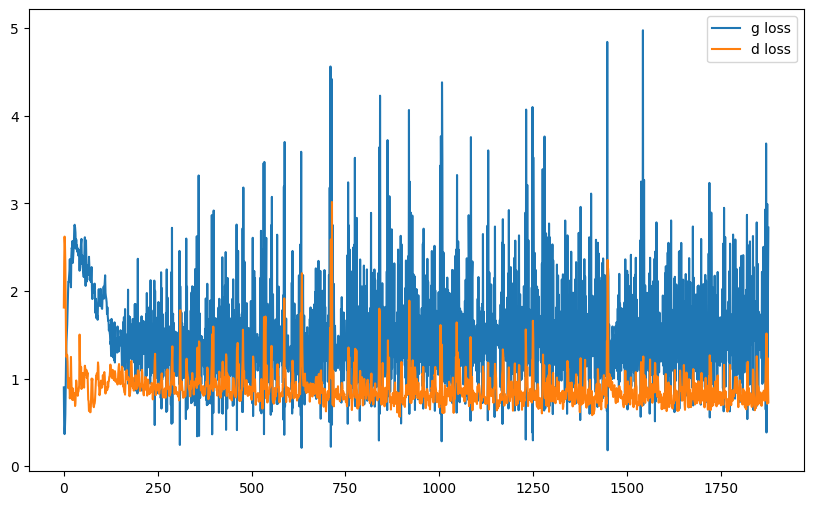

it: 2076; g_loss: 2.2033753395080566; d_loss: 0.69025719165802; avg_real_score: 0.7955913543701172; avg_fake_score: 0.13125059008598328: : 200it [00:26,  8.13it/s]  

generated images


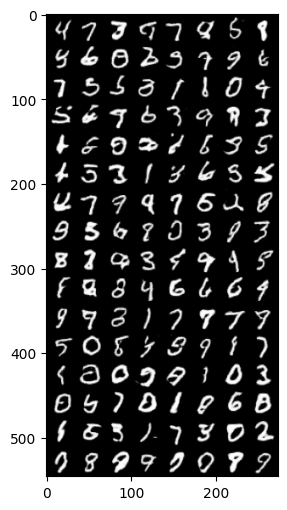

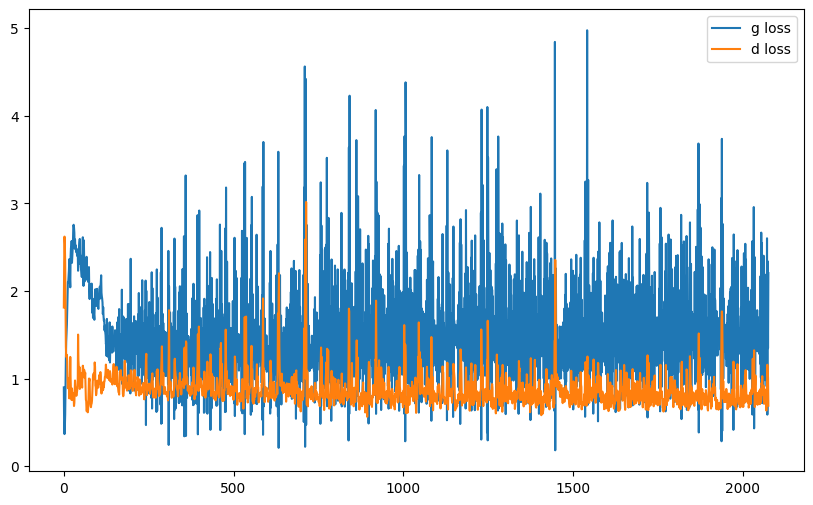

it: 2276; g_loss: 1.1651008129119873; d_loss: 0.773716151714325; avg_real_score: 0.6412932276725769; avg_fake_score: 0.34648269414901733: : 400it [00:52,  6.19it/s]

generated images


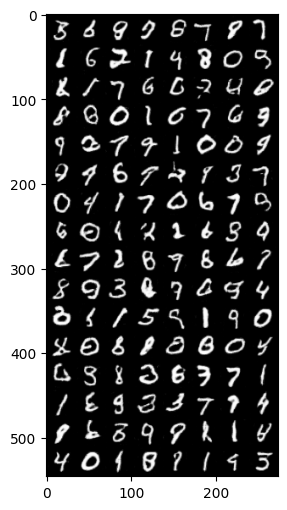

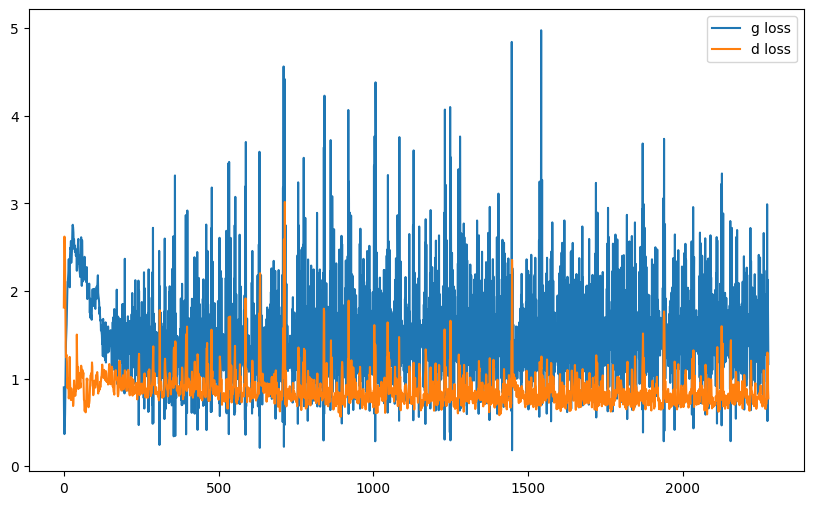

it: 2344; g_loss: 0.818392276763916; d_loss: 0.8565133810043335; avg_real_score: 0.532904863357544; avg_fake_score: 0.46290943026542664: : 469it [01:01,  7.59it/s]


In [67]:
nz = 100
ngf = 128
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

torch.autograd.set_detect_anomaly(True)

nb_epochs = 5

g_losses = []
d_losses = []


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]

        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im)




        ###
        ### Discriminator
        ###

        d_loss = criterion(yhat_real, get_labels_one(cur_batch_size)) + criterion(yhat_fake, get_labels_zero(cur_batch_size))
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()


        ###
        ### Generator
        ###

        yhat_fake = netD(fake_im)

        g_loss = criterion(yhat_fake, get_labels_one(cur_batch_size))
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            #fake_im = G(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

In this case (increasing ngf a lot - 128 - and leaving ndf at 32) the generator produces sharper and more detailed digits. This is especially evident in the clean and well-formed shapes of numbers like 3, 5 and 8.

Moreover the loss curves show relatively smaller oscillation in the generator loss indicating that the generator has more capacity to learn effectively and keep up with the discriminator.

The discriminator loss remains low, suggesting the discriminator is still able to classify real and fake images confidently but doesn't overpower the generator.

Increasing ngf significantly in fact boosts the generator's capacity, enabling it to model more complex patterns and produce higher-quality outputs.
In this way we're getting high-quality digits with minimal artifacts and the training appears more stable, as shown by the smoother loss curves. On the other hand computational cost increases due to the large generator.

## Replace the custom weight initialization with pytorch’s default initialization.

it: 0; g_loss: 0.74986732006073; d_loss: 1.4765175580978394; avg_real_score: 0.5434361696243286; avg_fake_score: 0.47853410243988037: : 0it [00:00, ?it/s]

generated images


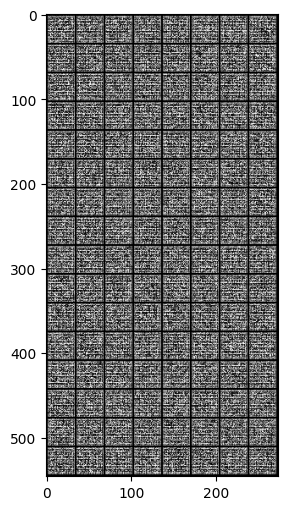

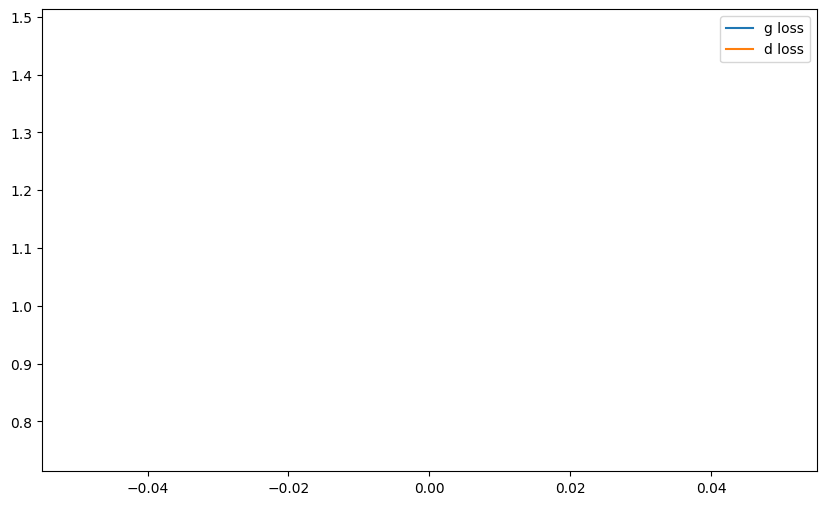

it: 200; g_loss: 1.470920205116272; d_loss: 0.5703716278076172; avg_real_score: 0.6997960805892944; avg_fake_score: 0.250557541847229: : 199it [00:19, 11.12it/s]   

generated images


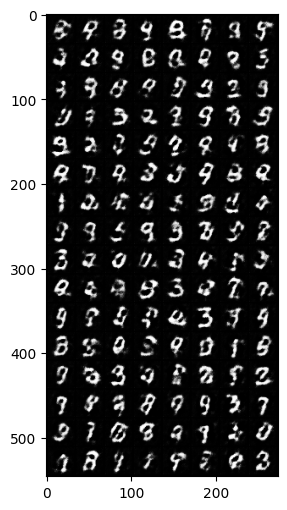

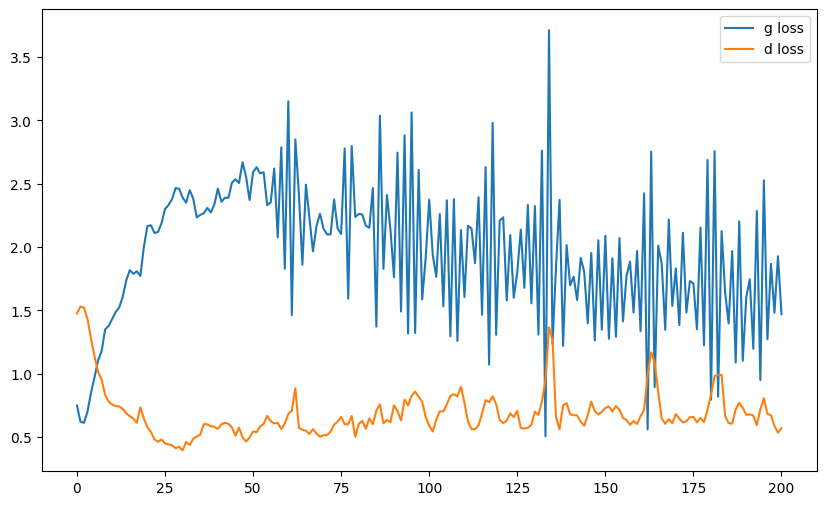

it: 400; g_loss: 0.987160325050354; d_loss: 0.5909298658370972; avg_real_score: 0.6542199850082397; avg_fake_score: 0.4028348922729492: : 399it [00:39, 11.03it/s]  

generated images


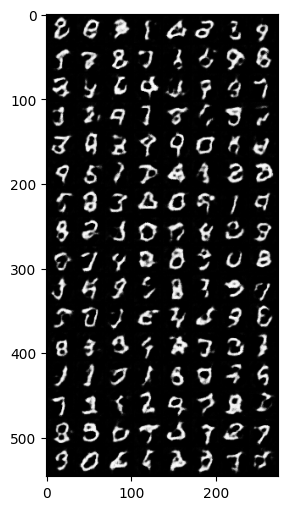

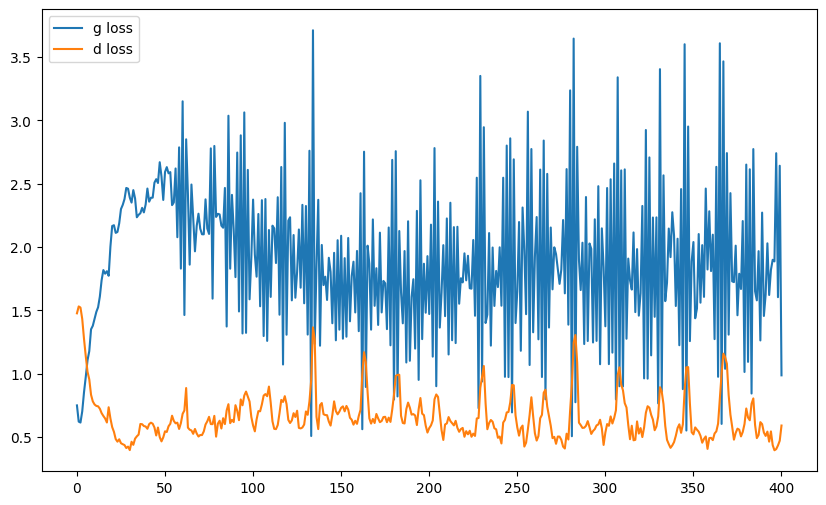

it: 468; g_loss: 1.8637454509735107; d_loss: 0.5892850160598755; avg_real_score: 0.8444806337356567; avg_fake_score: 0.1801881492137909: : 469it [00:47,  9.95it/s]
it: 469; g_loss: 2.1894848346710205; d_loss: 0.5449263453483582; avg_real_score: 0.7790341973304749; avg_fake_score: 0.1320105791091919: : 0it [00:00, ?it/s]

generated images


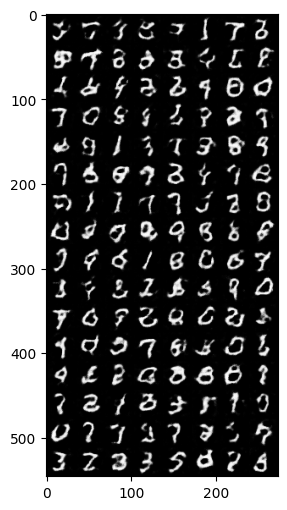

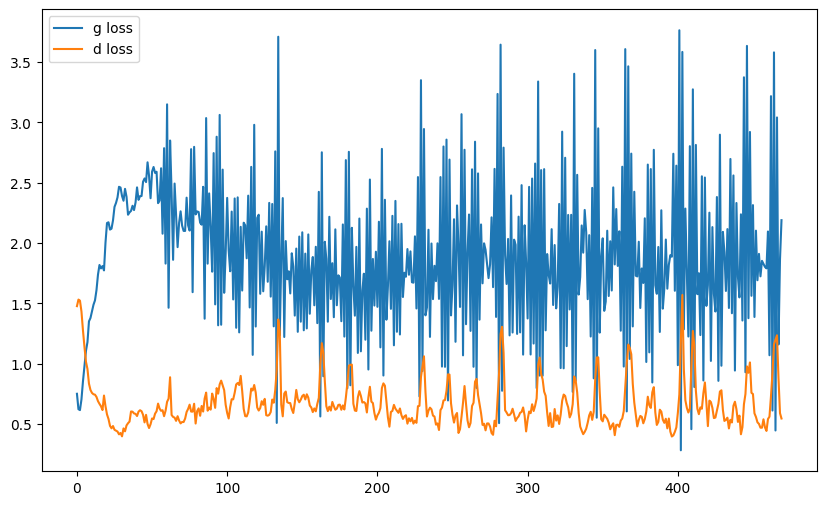

it: 669; g_loss: 1.0957585573196411; d_loss: 0.6234682202339172; avg_real_score: 0.6232937574386597; avg_fake_score: 0.36455753445625305: : 199it [00:21,  8.52it/s]

generated images


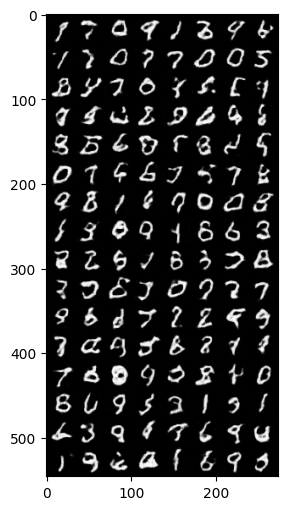

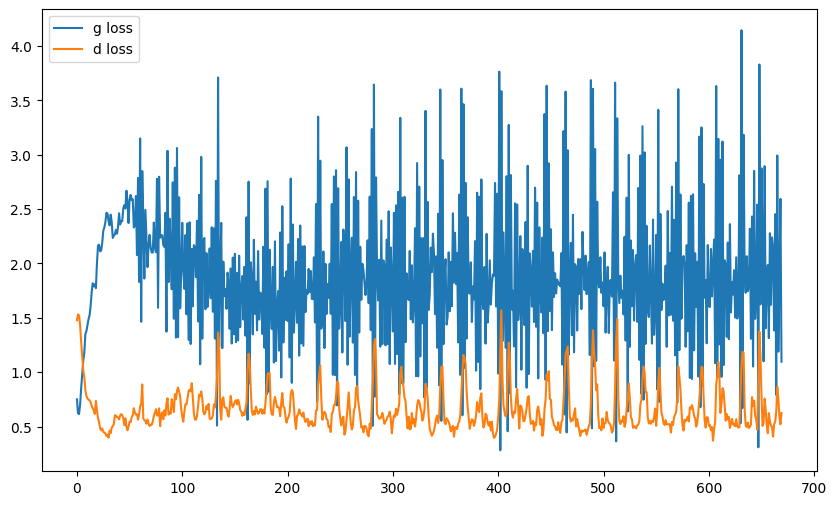

it: 869; g_loss: 1.8580771684646606; d_loss: 0.45756566524505615; avg_real_score: 0.8004879951477051; avg_fake_score: 0.18417829275131226: : 399it [00:42, 10.73it/s]

generated images


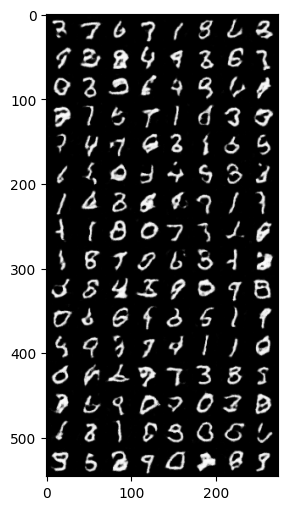

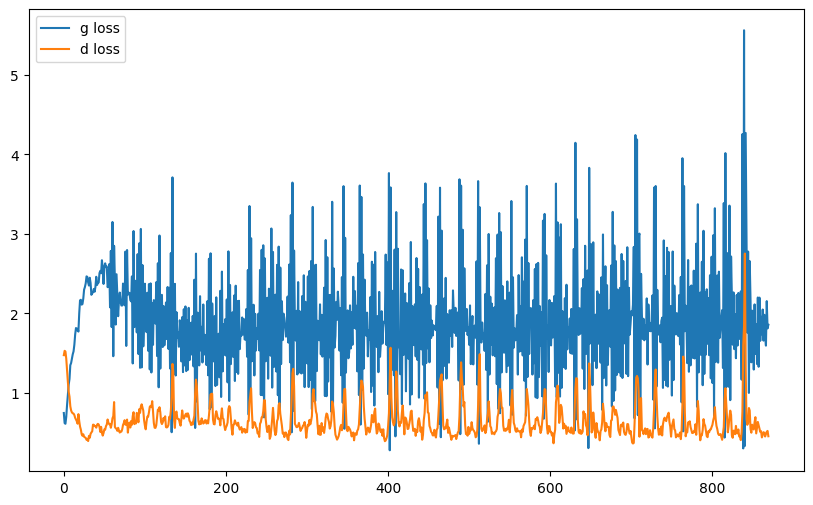

it: 937; g_loss: 2.8800554275512695; d_loss: 0.43256092071533203; avg_real_score: 0.8778545260429382; avg_fake_score: 0.07108031213283539: : 469it [00:50,  9.31it/s]
it: 938; g_loss: 0.8169367909431458; d_loss: 0.5916380286216736; avg_real_score: 0.6486036777496338; avg_fake_score: 0.47854042053222656: : 0it [00:00, ?it/s]

generated images


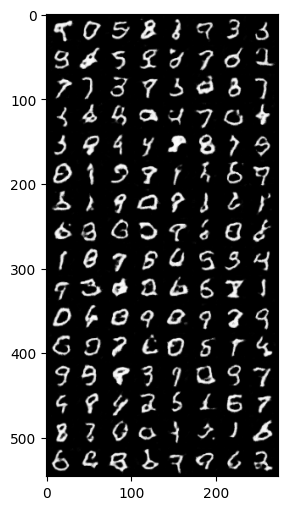

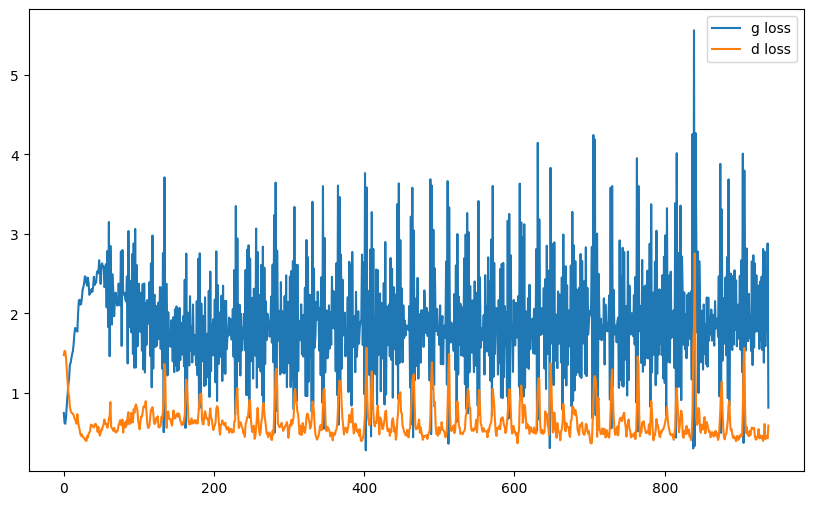

it: 1138; g_loss: 2.733187198638916; d_loss: 0.4319436848163605; avg_real_score: 0.8785004615783691; avg_fake_score: 0.08075951039791107: : 200it [00:20,  9.15it/s]  

generated images


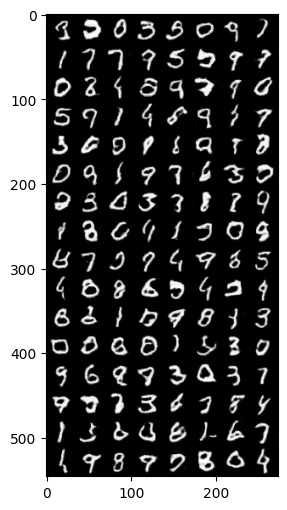

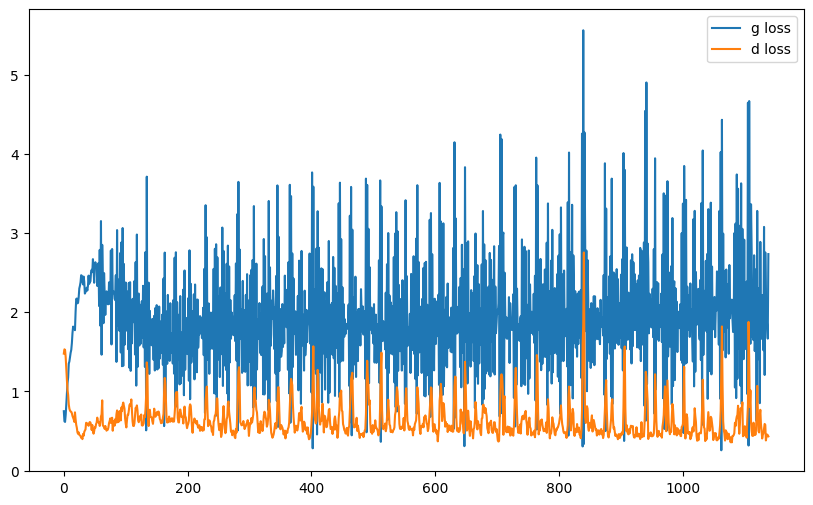

it: 1338; g_loss: 2.710695505142212; d_loss: 0.43674802780151367; avg_real_score: 0.8832287788391113; avg_fake_score: 0.08869415521621704: : 400it [00:43,  9.24it/s]

generated images


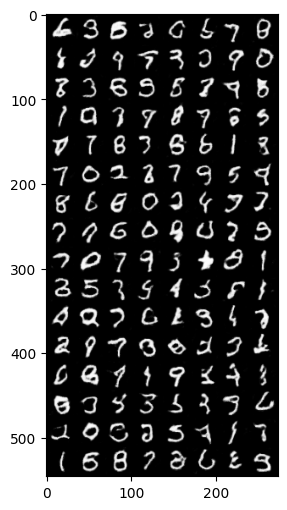

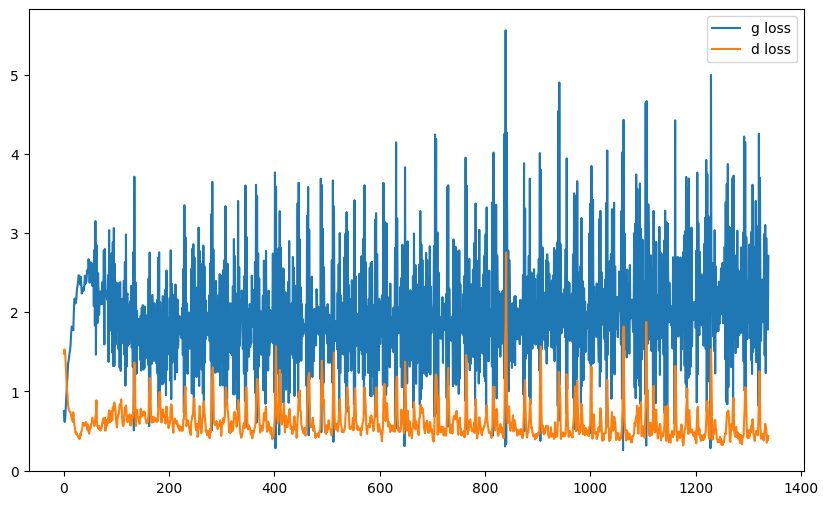

it: 1406; g_loss: 1.901106595993042; d_loss: 0.37591180205345154; avg_real_score: 0.8433383703231812; avg_fake_score: 0.1854550540447235: : 469it [00:52,  9.00it/s]
it: 1407; g_loss: 3.2963900566101074; d_loss: 0.44521844387054443; avg_real_score: 0.9235764741897583; avg_fake_score: 0.05695224925875664: : 0it [00:00, ?it/s]

generated images


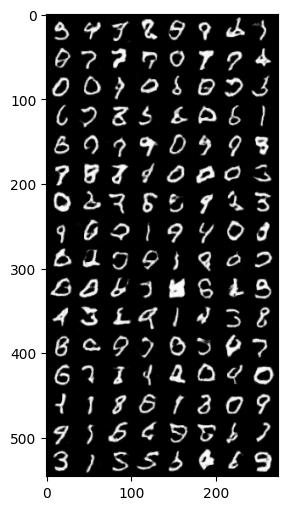

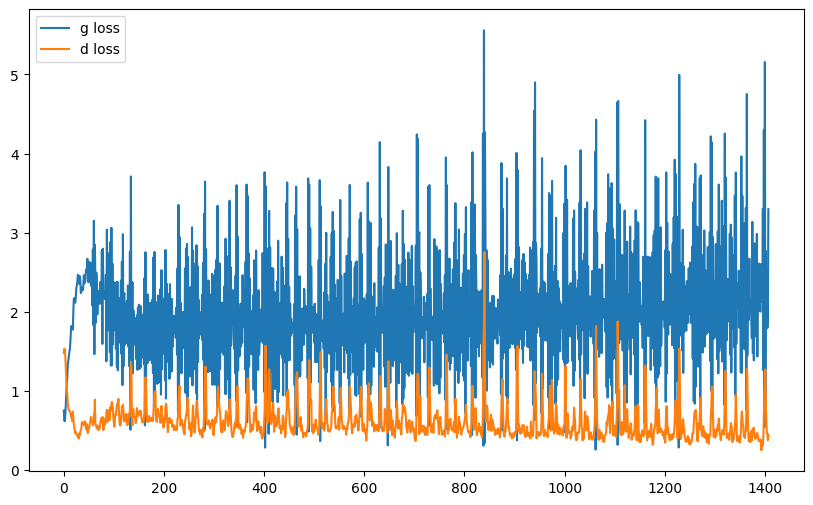

it: 1607; g_loss: 2.8364858627319336; d_loss: 0.6127538681030273; avg_real_score: 0.9753003120422363; avg_fake_score: 0.08066970109939575: : 200it [00:23,  9.15it/s] 

generated images


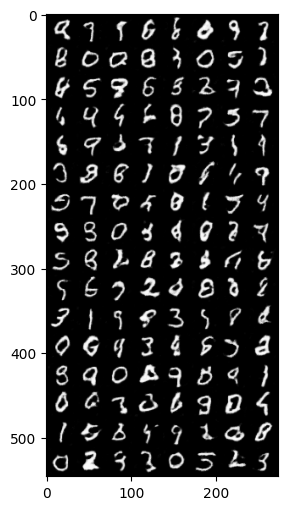

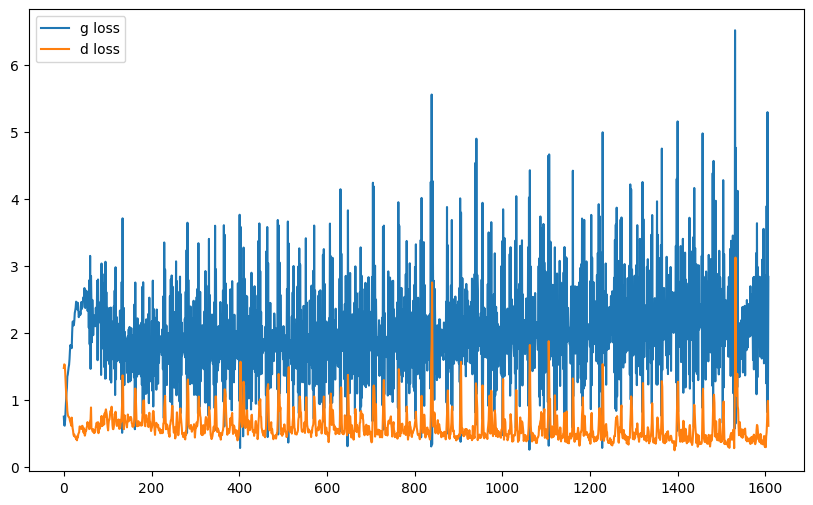

it: 1807; g_loss: 2.4144444465637207; d_loss: 0.3185417652130127; avg_real_score: 0.8462674021720886; avg_fake_score: 0.1189790889620781: : 400it [00:47,  8.94it/s] 

generated images


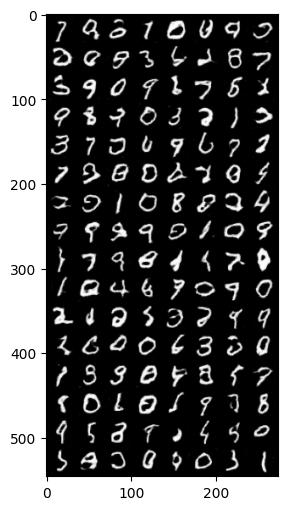

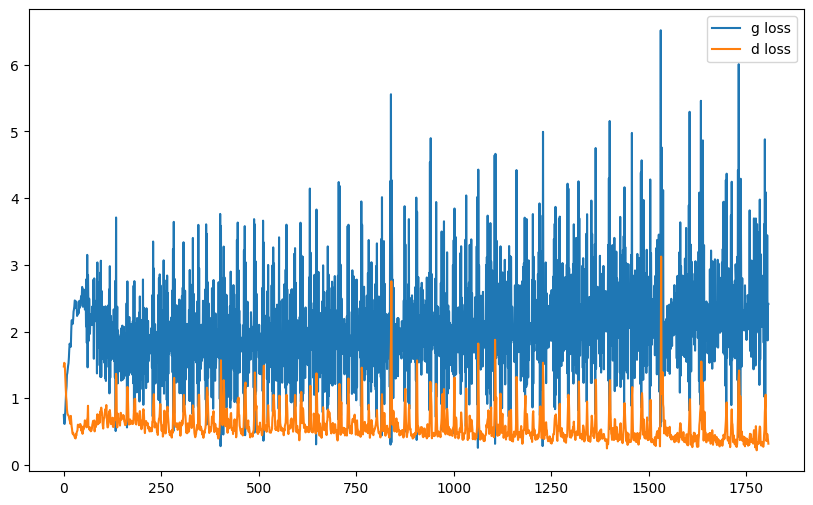

it: 1875; g_loss: 2.1624550819396973; d_loss: 0.6760875582695007; avg_real_score: 0.5709526538848877; avg_fake_score: 0.15011444687843323: : 469it [00:56,  8.31it/s]
it: 1876; g_loss: 1.6130692958831787; d_loss: 0.34788668155670166; avg_real_score: 0.8476492166519165; avg_fake_score: 0.2393457442522049: : 0it [00:00, ?it/s]

generated images


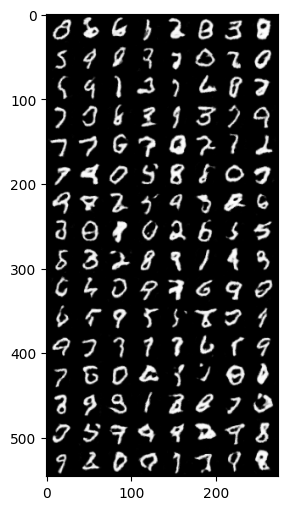

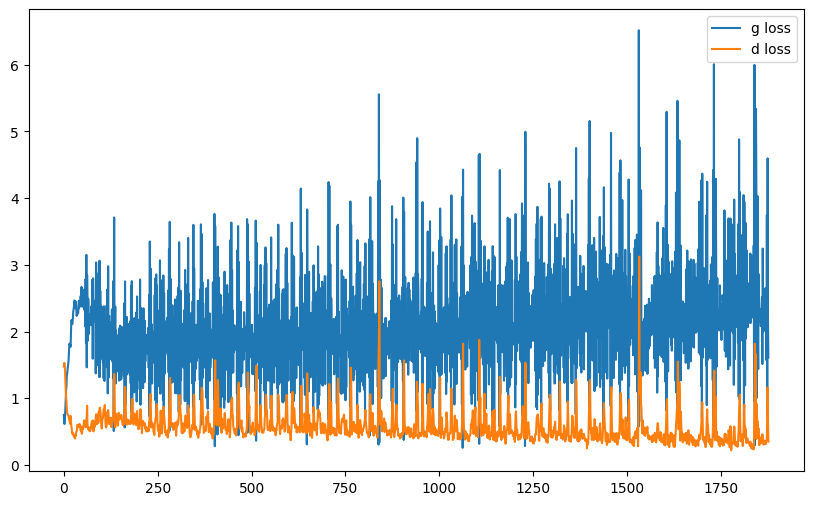

it: 2076; g_loss: 2.4673304557800293; d_loss: 0.25108855962753296; avg_real_score: 0.8301740884780884; avg_fake_score: 0.11182958632707596: : 200it [00:24,  7.27it/s]

generated images


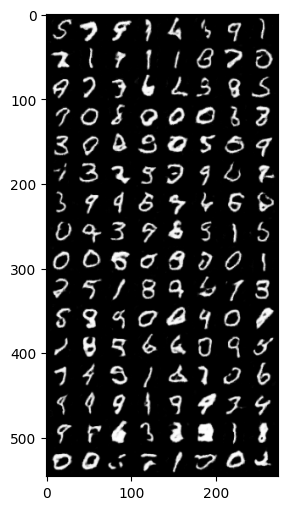

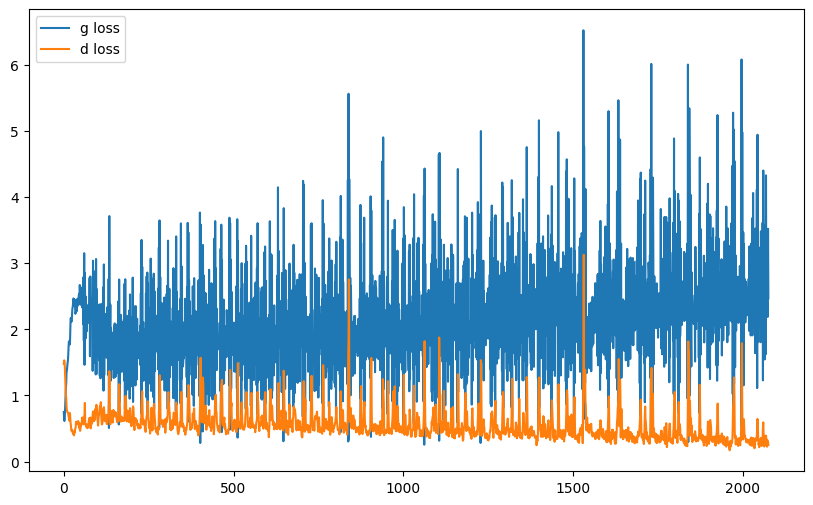

it: 2276; g_loss: 2.787374973297119; d_loss: 0.2155342698097229; avg_real_score: 0.88883376121521; avg_fake_score: 0.08520745486021042: : 400it [00:49,  8.87it/s]    

generated images


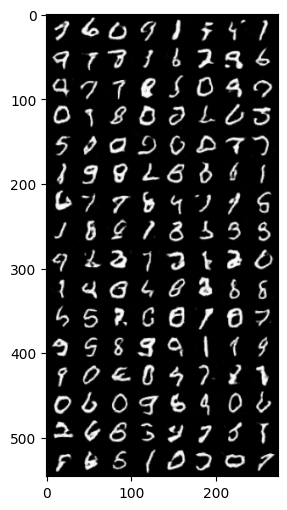

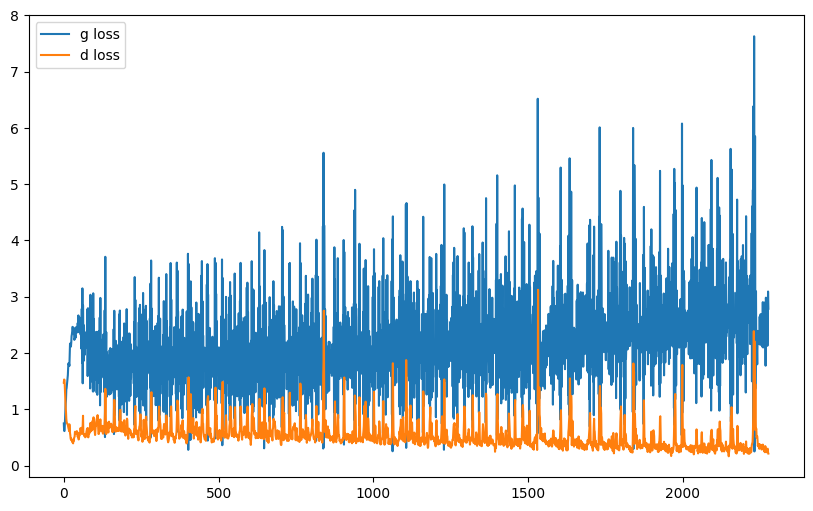

it: 2344; g_loss: 3.7378787994384766; d_loss: 0.20732273161411285; avg_real_score: 0.9512667059898376; avg_fake_score: 0.03566310554742813: : 469it [00:58,  8.04it/s]


In [68]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

torch.autograd.set_detect_anomaly(True)

nb_epochs = 5

g_losses = []
d_losses = []


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]

        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im)




        ###
        ### Discriminator
        ###

        d_loss = criterion(yhat_real, get_labels_one(cur_batch_size)) + criterion(yhat_fake, get_labels_zero(cur_batch_size))
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()


        ###
        ### Generator
        ###

        yhat_fake = netD(fake_im)

        g_loss = criterion(yhat_fake, get_labels_one(cur_batch_size))
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            #fake_im = G(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

In this case the generated digits are reasonably well-formed, with some variability in quality. Overall the images seem to be slightly less sharp compared to the custom initialization.

Also the generator loss is different and it shows smoother oscillation, tending to remain slightly higher compared to the custom initialization. This my indicate that the generator is taking longer to produce convincing imgaes.

We can hence say that the custom weight initialization gives the generator and discriminator a better starting point for modeling their respective tasks. In fact the default initialization is designed to be general-purpose and works well, but it may not be as effective in adversarial settings where small imbalances can significanlty impact training dynamics.

## Learn for longer (ex : 30 epochs) even if it seems that the model already generates correct images.

it: 0; g_loss: 0.9073832035064697; d_loss: 1.4485803842544556; avg_real_score: 0.5217970609664917; avg_fake_score: 0.41954120993614197: : 0it [00:00, ?it/s]

generated images


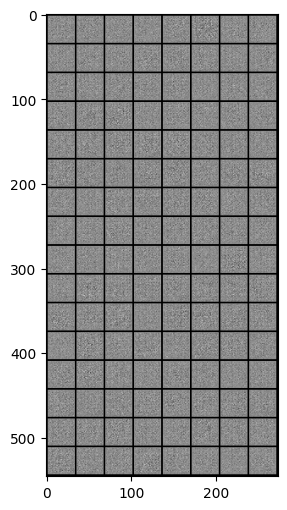

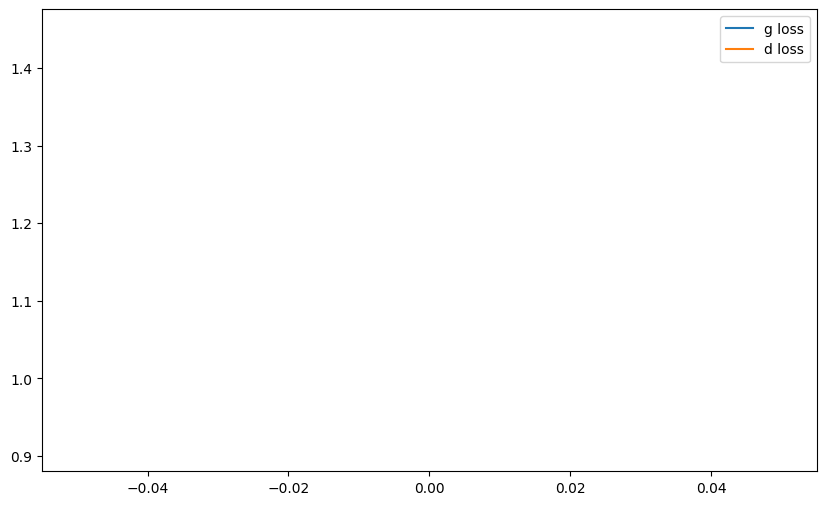

it: 200; g_loss: 5.066454887390137; d_loss: 0.6231690049171448; avg_real_score: 0.9635700583457947; avg_fake_score: 0.008097352460026741: : 200it [00:20, 11.49it/s]

generated images


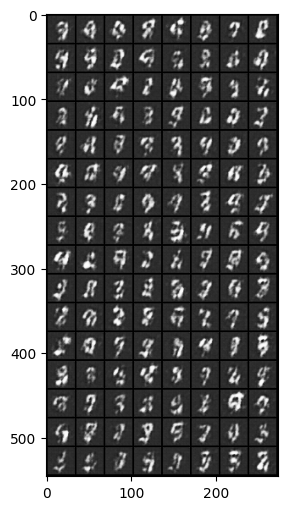

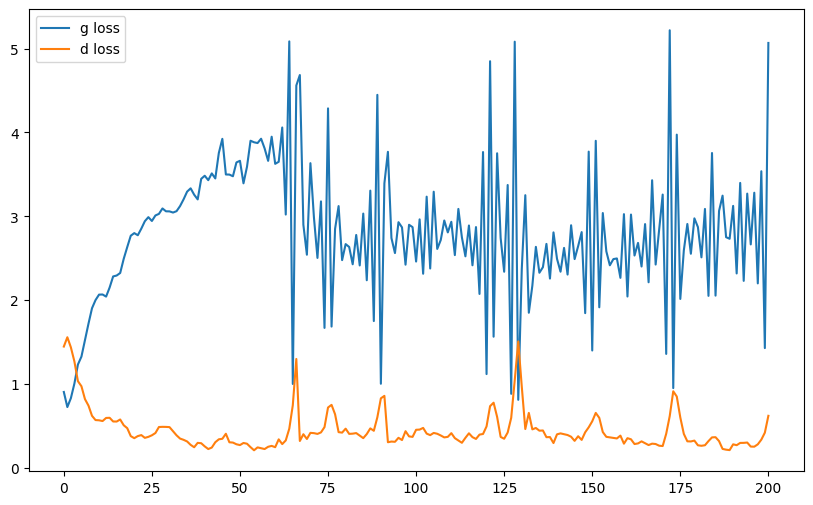

it: 400; g_loss: 1.7678908109664917; d_loss: 0.5173118114471436; avg_real_score: 0.7540580034255981; avg_fake_score: 0.18712234497070312: : 400it [00:42, 11.34it/s]

generated images


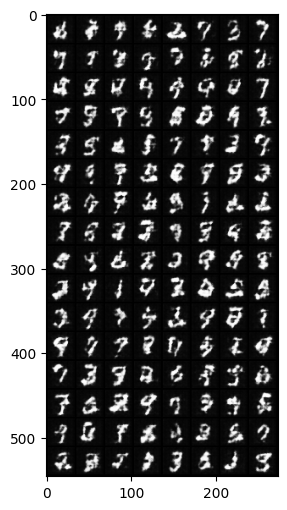

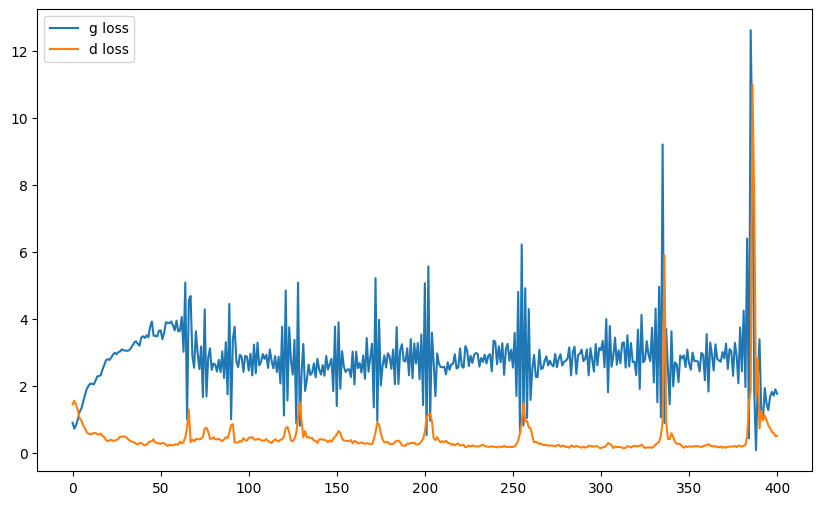

it: 468; g_loss: 0.5930512547492981; d_loss: 2.5610969066619873; avg_real_score: 0.13086391985416412; avg_fake_score: 0.6011074781417847: : 469it [00:49,  9.49it/s]
it: 469; g_loss: 6.628496170043945; d_loss: 1.3178142309188843; avg_real_score: 0.9897265434265137; avg_fake_score: 0.001981431385502219: : 0it [00:00, ?it/s]

generated images


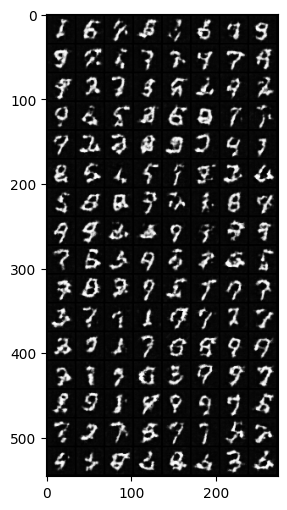

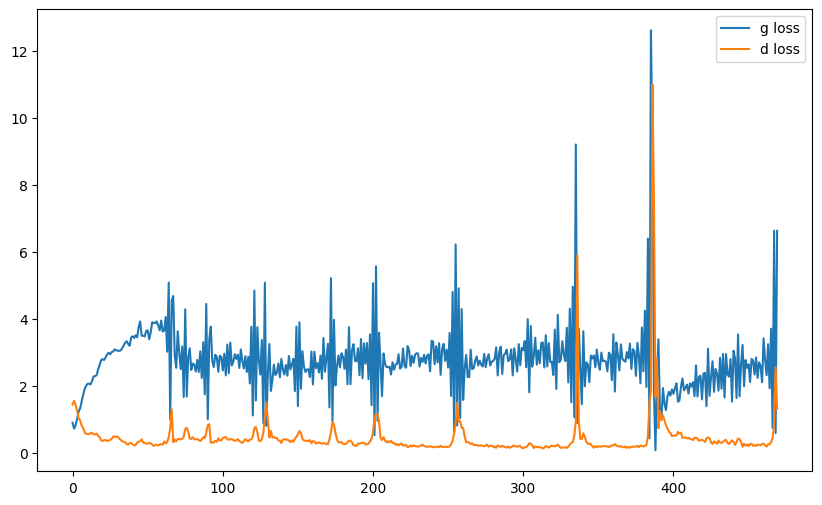

it: 669; g_loss: 2.378345012664795; d_loss: 0.4226725995540619; avg_real_score: 0.8242764472961426; avg_fake_score: 0.11140500009059906: : 200it [00:20, 10.85it/s] 

generated images


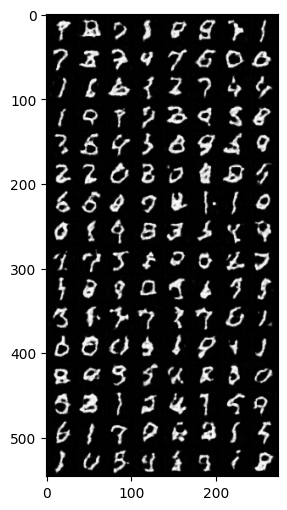

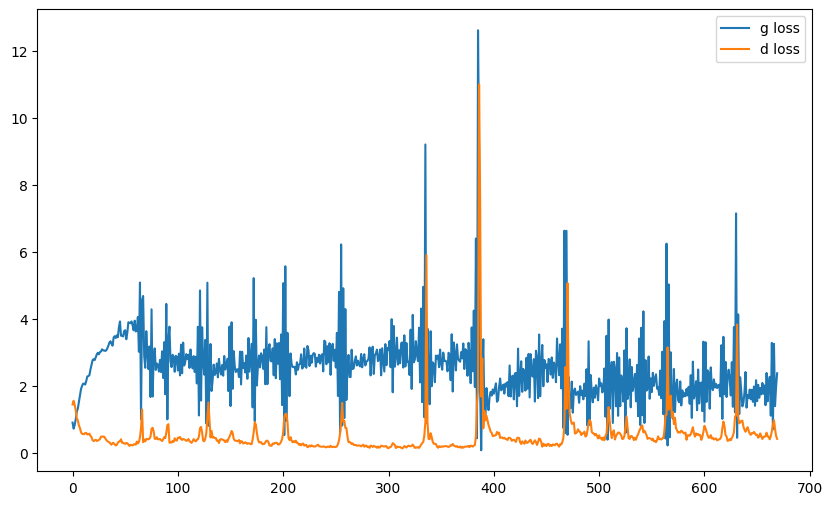

it: 869; g_loss: 0.3653402328491211; d_loss: 1.287312626838684; avg_real_score: 0.3502119481563568; avg_fake_score: 0.7173415422439575: : 399it [00:41, 10.38it/s]  

generated images


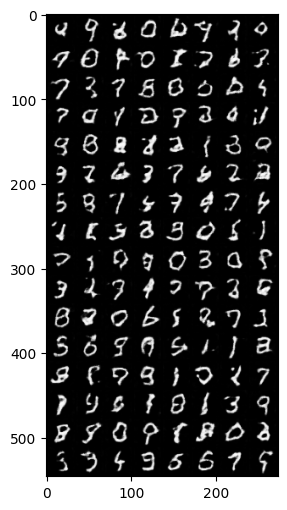

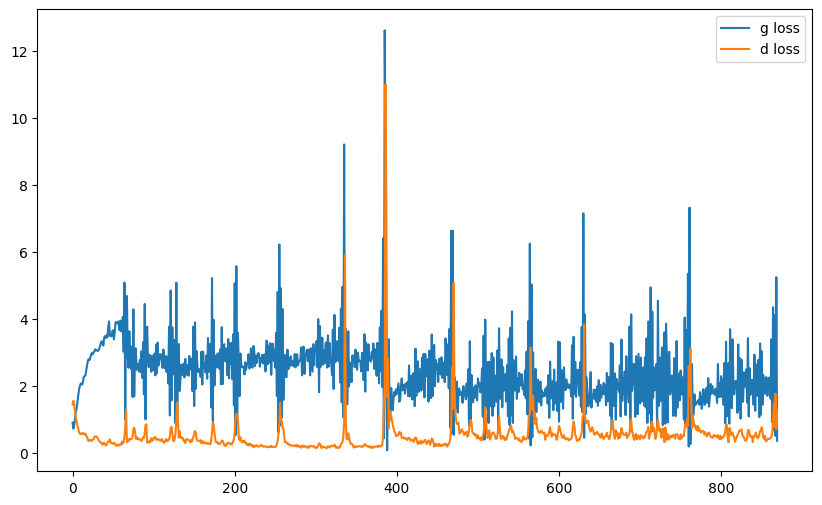

it: 937; g_loss: 2.643775701522827; d_loss: 0.44269630312919617; avg_real_score: 0.8737146854400635; avg_fake_score: 0.08650614321231842: : 469it [00:48,  9.66it/s]
it: 938; g_loss: 2.364469051361084; d_loss: 0.34628432989120483; avg_real_score: 0.8204833269119263; avg_fake_score: 0.11968556046485901: : 0it [00:00, ?it/s]

generated images


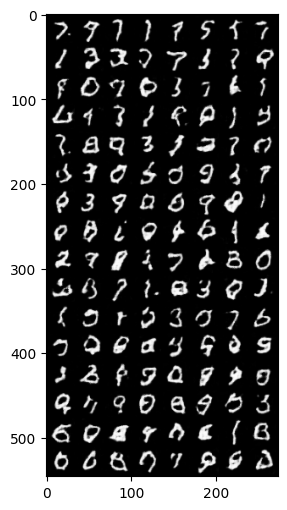

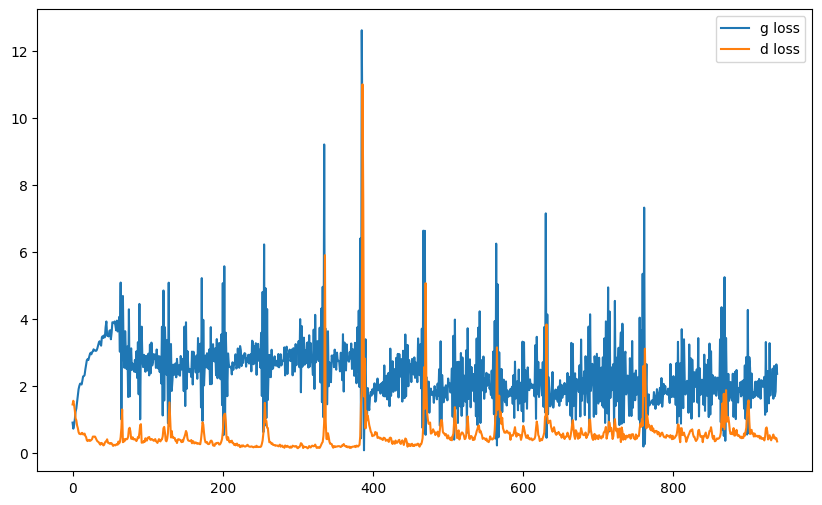

it: 1138; g_loss: 2.8182926177978516; d_loss: 0.4163110554218292; avg_real_score: 0.8887573480606079; avg_fake_score: 0.0802394300699234: : 199it [00:21, 10.55it/s]  

generated images


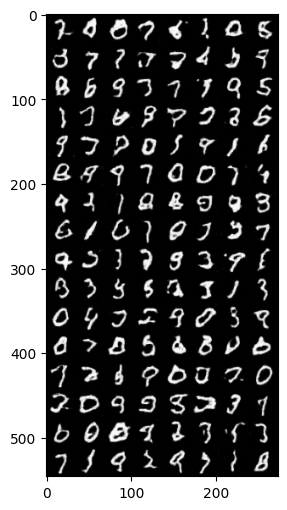

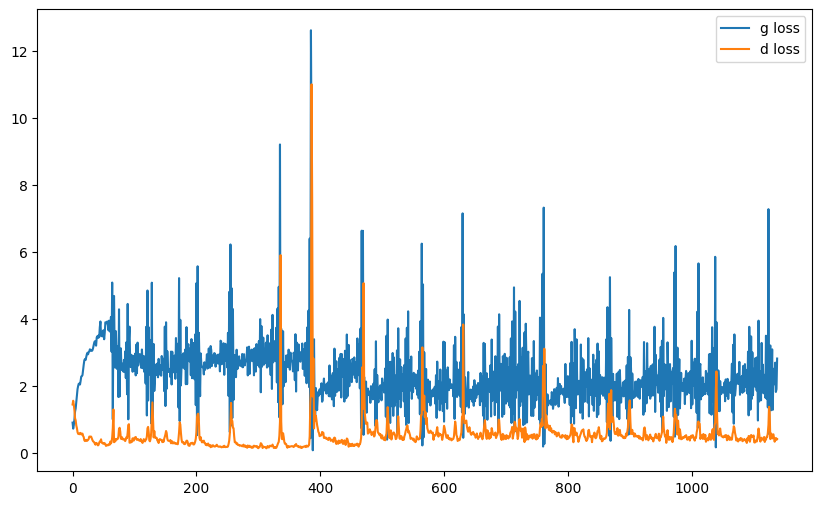

it: 1338; g_loss: 2.4921822547912598; d_loss: 0.47452327609062195; avg_real_score: 0.7251143455505371; avg_fake_score: 0.1078605204820633: : 400it [00:43,  7.44it/s]

generated images


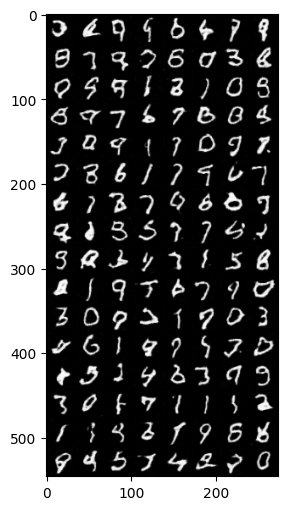

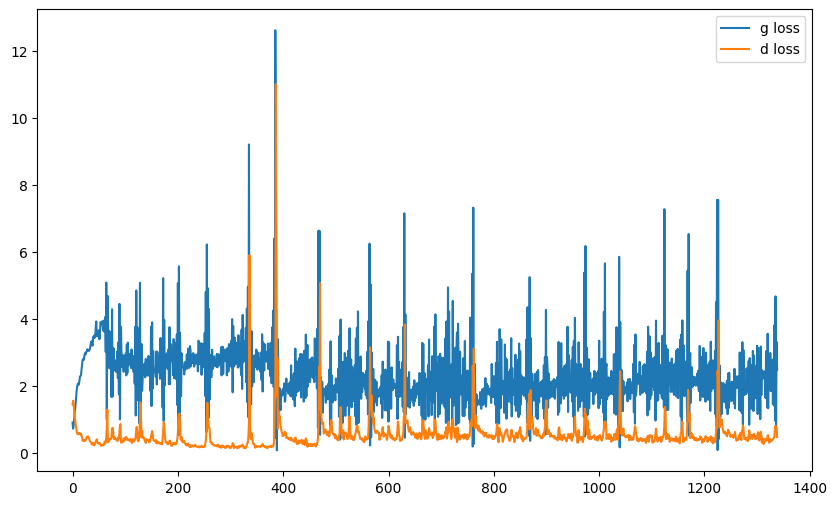

it: 1406; g_loss: 2.5155255794525146; d_loss: 0.272766649723053; avg_real_score: 0.8846785426139832; avg_fake_score: 0.10546912252902985: : 469it [00:50,  9.24it/s]
it: 1407; g_loss: 1.4974644184112549; d_loss: 0.3480416536331177; avg_real_score: 0.781070351600647; avg_fake_score: 0.2729453444480896: : 0it [00:00, ?it/s]

generated images


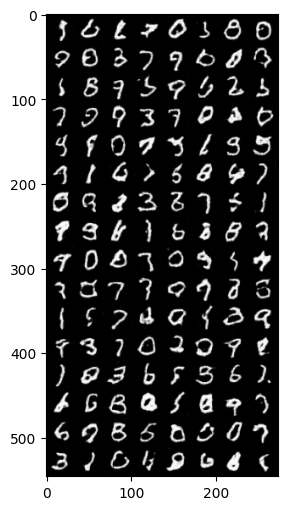

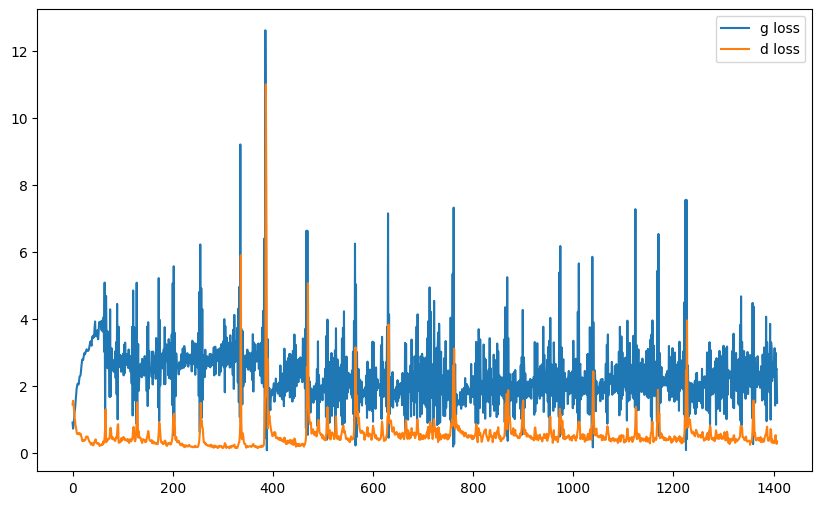

it: 1607; g_loss: 2.277371406555176; d_loss: 0.31617140769958496; avg_real_score: 0.8343450427055359; avg_fake_score: 0.13988828659057617: : 200it [00:23,  9.93it/s]

generated images


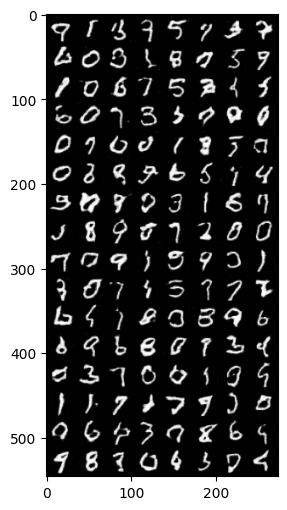

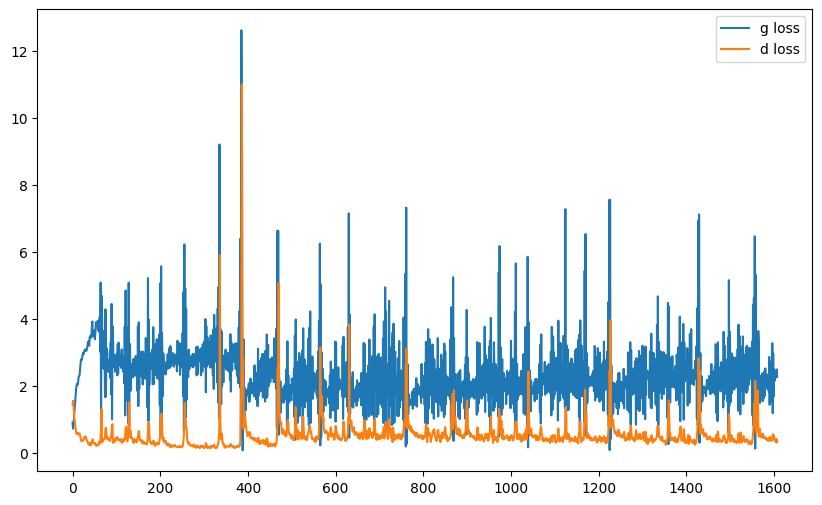

it: 1807; g_loss: 2.3388054370880127; d_loss: 0.25237467885017395; avg_real_score: 0.8477800488471985; avg_fake_score: 0.1234750747680664: : 400it [00:47,  7.07it/s]

generated images


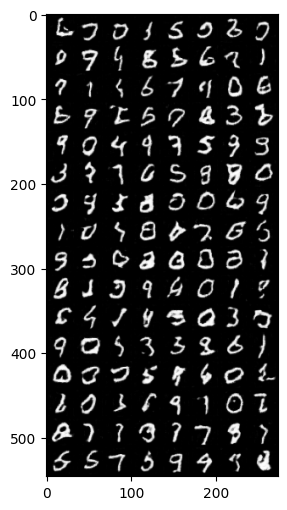

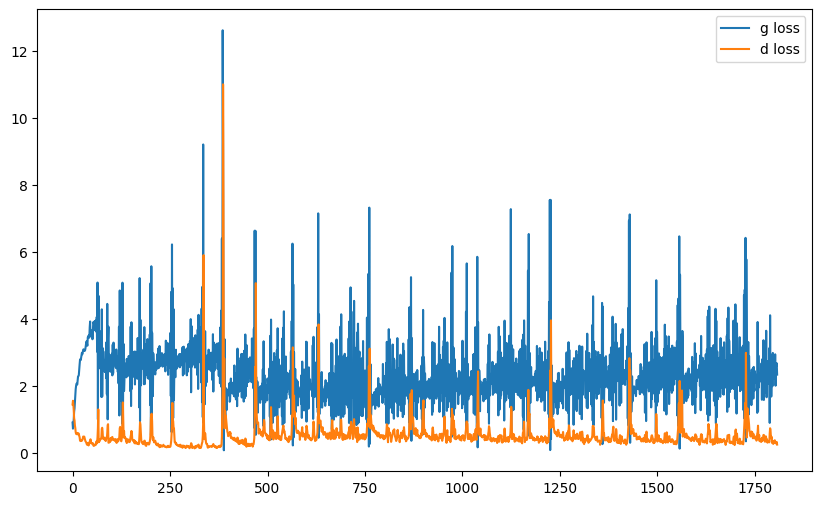

it: 1875; g_loss: 4.4264607429504395; d_loss: 0.5207992792129517; avg_real_score: 0.8540278673171997; avg_fake_score: 0.016618773341178894: : 469it [00:55,  8.41it/s]
it: 1876; g_loss: 0.9438912868499756; d_loss: 1.8823552131652832; avg_real_score: 0.23095065355300903; avg_fake_score: 0.4632728397846222: : 0it [00:00, ?it/s]

generated images


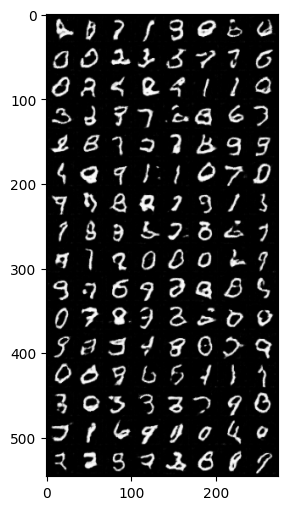

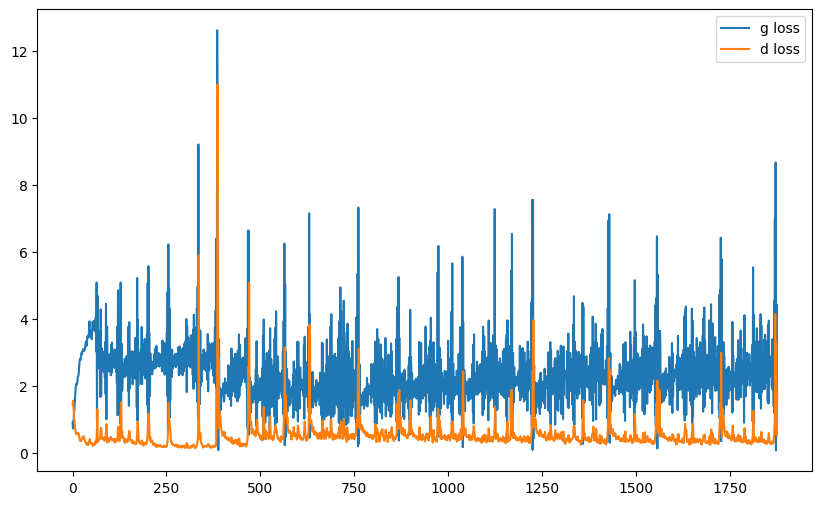

it: 2076; g_loss: 2.9557933807373047; d_loss: 0.2527783513069153; avg_real_score: 0.9137155413627625; avg_fake_score: 0.06802235543727875: : 200it [00:24,  8.69it/s]

generated images


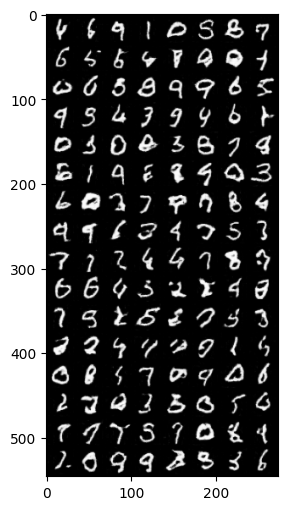

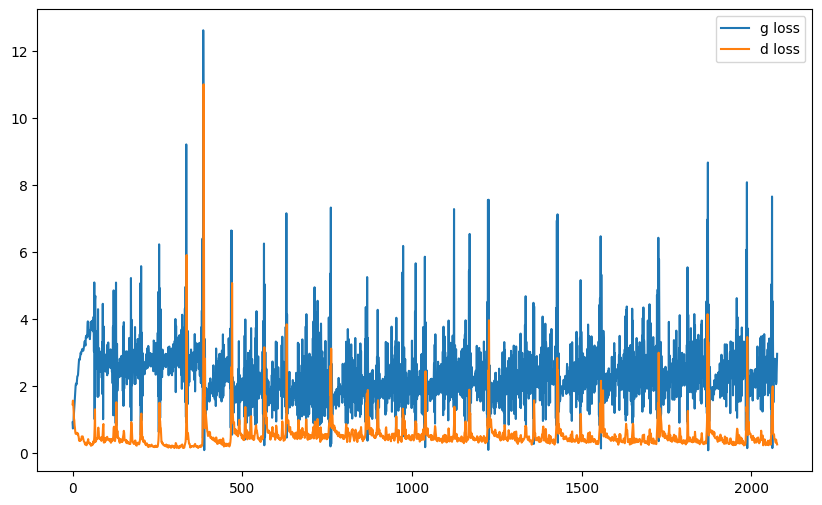

it: 2276; g_loss: 1.2997801303863525; d_loss: 0.9119806885719299; avg_real_score: 0.45772701501846313; avg_fake_score: 0.32681623101234436: : 400it [00:49,  8.73it/s]

generated images


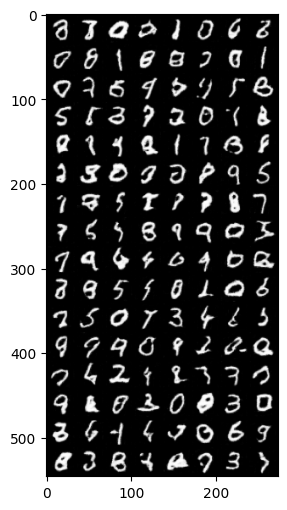

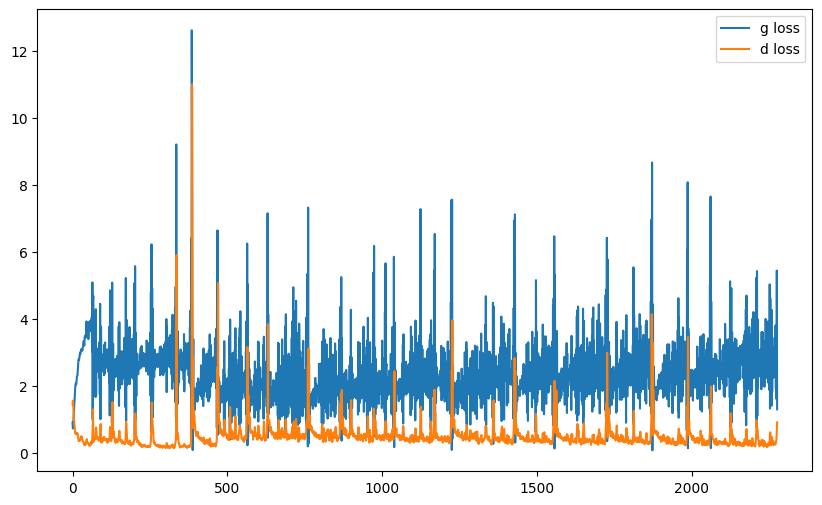

it: 2344; g_loss: 3.76619815826416; d_loss: 0.46950802206993103; avg_real_score: 0.9661011695861816; avg_fake_score: 0.03421688824892044: : 469it [00:57,  8.18it/s]
it: 2345; g_loss: 3.1295671463012695; d_loss: 0.26088064908981323; avg_real_score: 0.8194758892059326; avg_fake_score: 0.06373059004545212: : 0it [00:00, ?it/s]

generated images


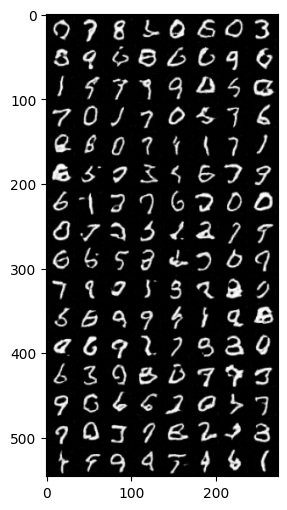

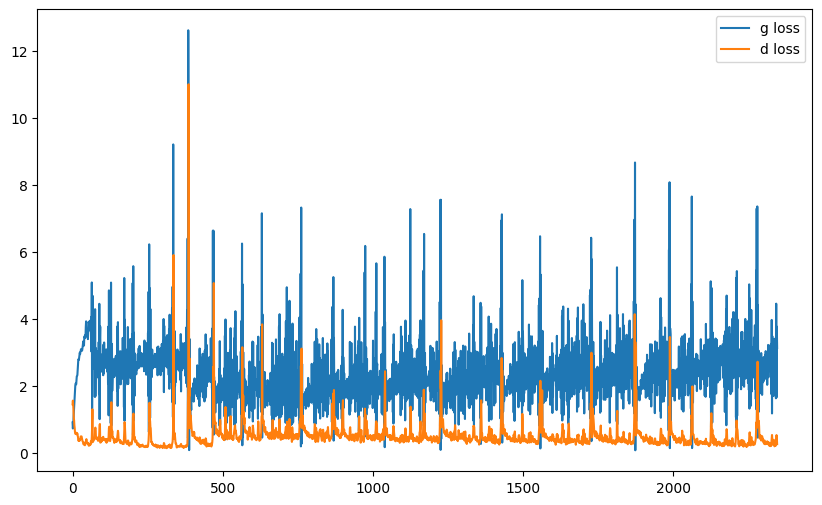

it: 2545; g_loss: 4.349870681762695; d_loss: 0.38103359937667847; avg_real_score: 0.9461004734039307; avg_fake_score: 0.020411815494298935: : 200it [00:25,  9.06it/s]

generated images


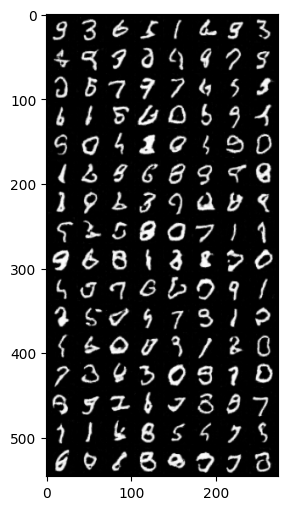

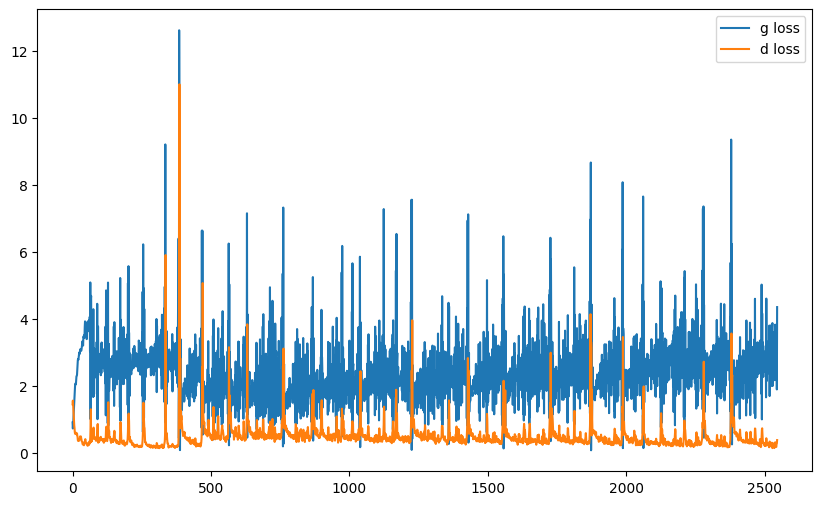

it: 2745; g_loss: 3.2425789833068848; d_loss: 0.35884541273117065; avg_real_score: 0.9722090363502502; avg_fake_score: 0.06177769601345062: : 400it [00:50,  9.23it/s]

generated images


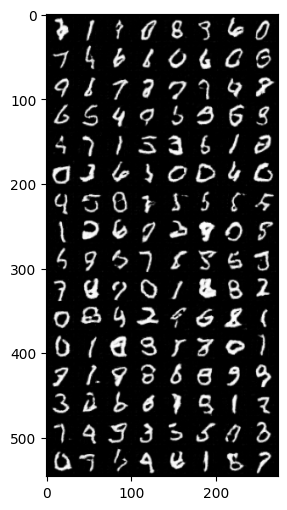

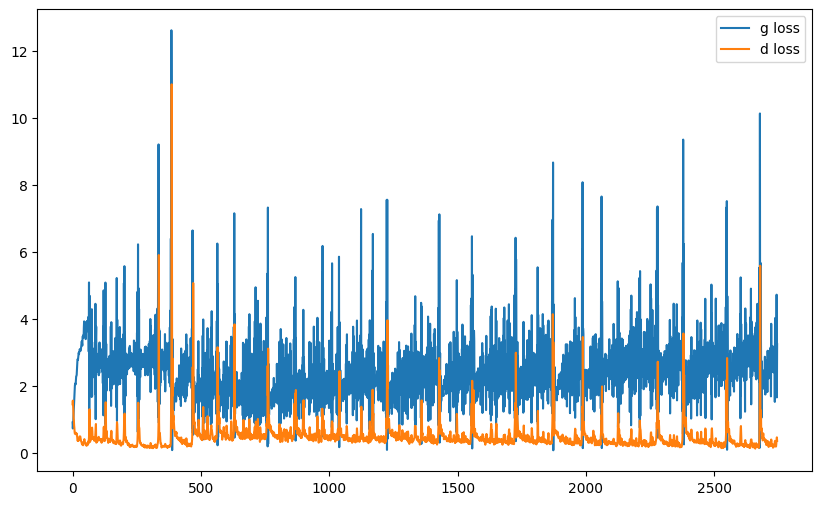

it: 2813; g_loss: 2.923884153366089; d_loss: 0.14912033081054688; avg_real_score: 0.9029414057731628; avg_fake_score: 0.07371552288532257: : 469it [00:59,  7.90it/s]
it: 2814; g_loss: 3.968801975250244; d_loss: 0.2447362095117569; avg_real_score: 0.9678546786308289; avg_fake_score: 0.030525151640176773: : 0it [00:00, ?it/s]

generated images


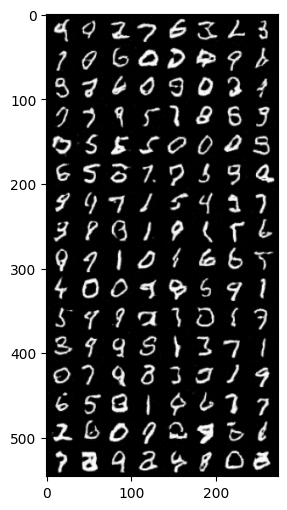

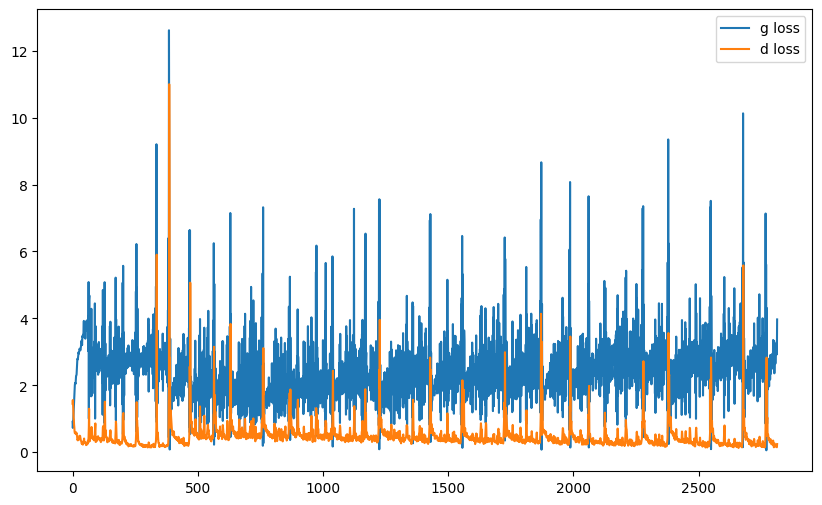

it: 3014; g_loss: 3.3184173107147217; d_loss: 0.18923935294151306; avg_real_score: 0.9097413420677185; avg_fake_score: 0.053992077708244324: : 200it [00:24,  6.90it/s]

generated images


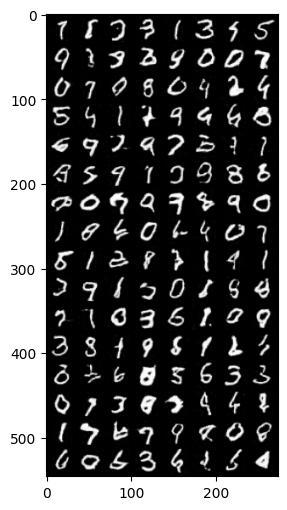

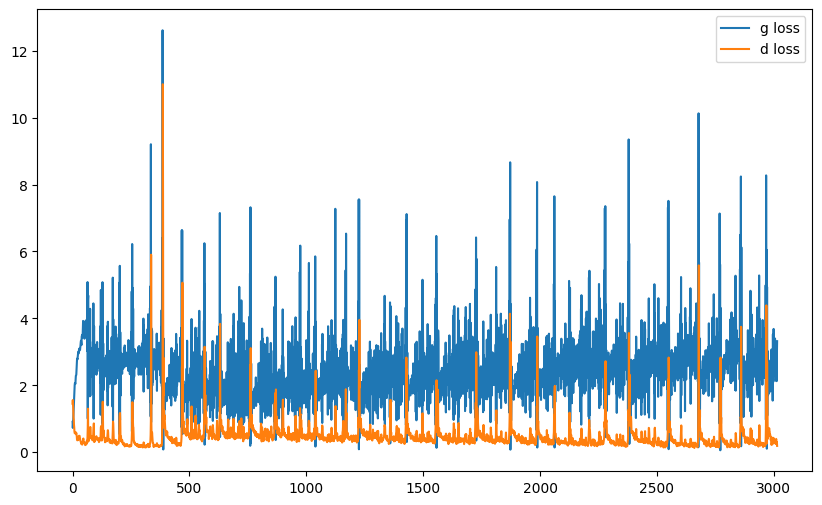

it: 3214; g_loss: 3.4768214225769043; d_loss: 0.15567117929458618; avg_real_score: 0.9250231981277466; avg_fake_score: 0.04891679435968399: : 400it [00:49,  8.84it/s]

generated images


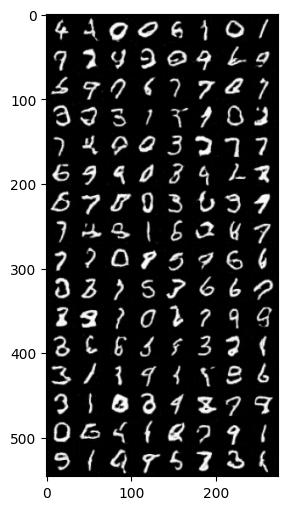

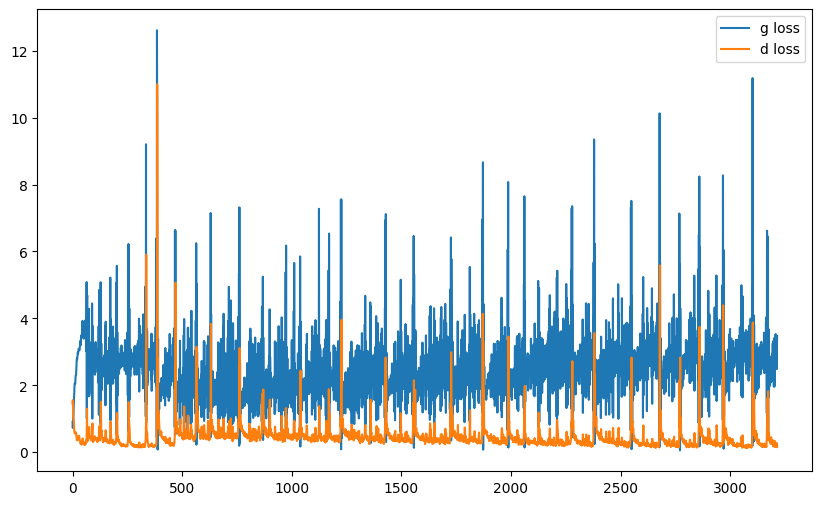

it: 3282; g_loss: 2.878844738006592; d_loss: 0.15015006065368652; avg_real_score: 0.9205174446105957; avg_fake_score: 0.07749636471271515: : 469it [00:58,  7.98it/s]
it: 3283; g_loss: 4.020366668701172; d_loss: 0.20611317455768585; avg_real_score: 0.9598130583763123; avg_fake_score: 0.026545032858848572: : 0it [00:00, ?it/s]

generated images


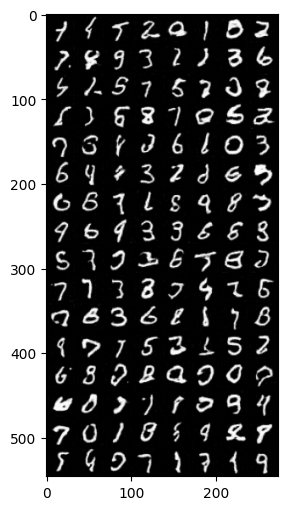

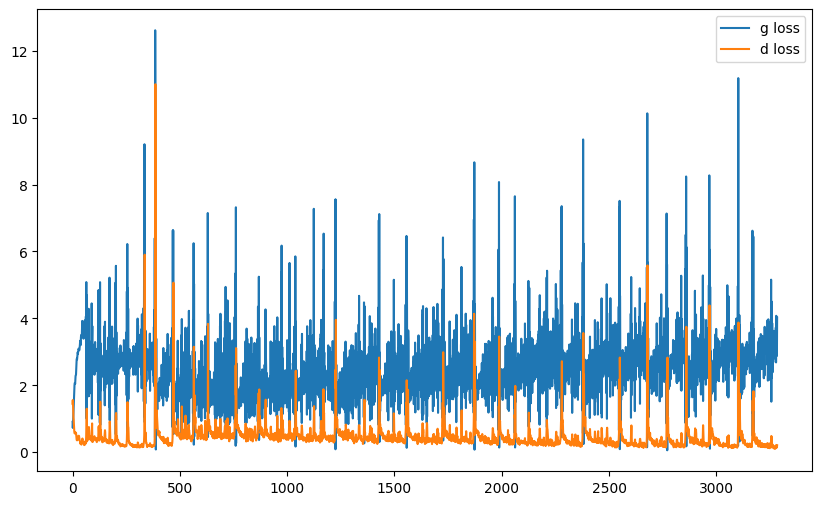

it: 3483; g_loss: 4.180595874786377; d_loss: 0.284066766500473; avg_real_score: 0.9913420677185059; avg_fake_score: 0.0260785985738039: : 200it [00:24,  8.27it/s]   

generated images


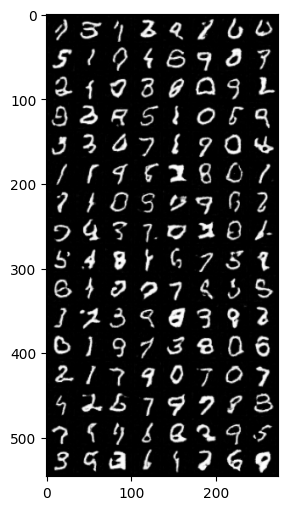

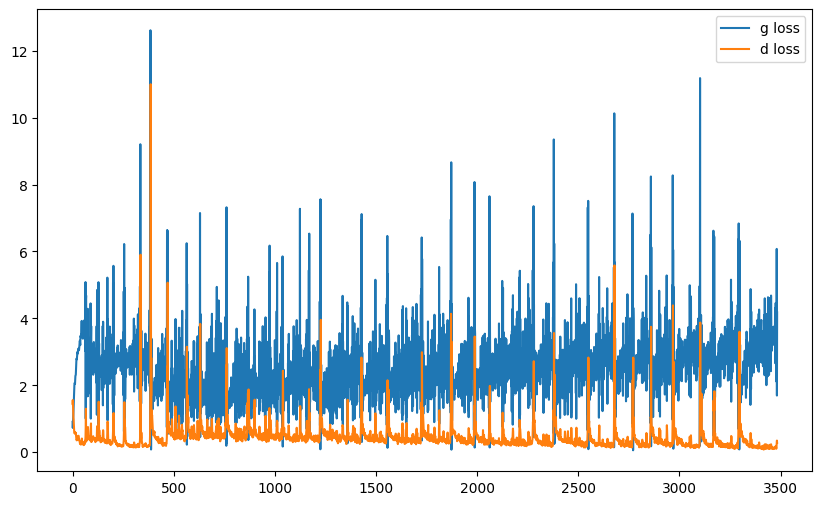

it: 3683; g_loss: 2.531871795654297; d_loss: 0.3301506042480469; avg_real_score: 0.8265189528465271; avg_fake_score: 0.1079932153224945: : 400it [00:48,  7.14it/s]  

generated images


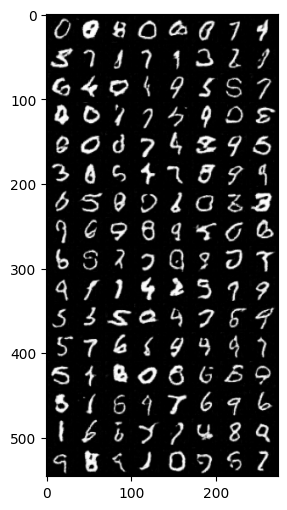

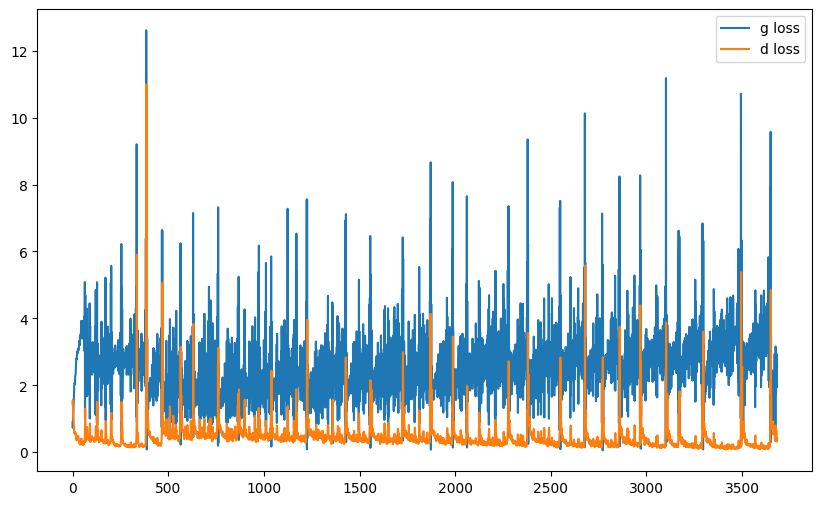

it: 3751; g_loss: 2.4645767211914062; d_loss: 0.20764228701591492; avg_real_score: 0.8766857981681824; avg_fake_score: 0.11441376060247421: : 469it [00:57,  8.13it/s]
it: 3752; g_loss: 3.958505153656006; d_loss: 0.1280350685119629; avg_real_score: 0.9723144769668579; avg_fake_score: 0.03157470002770424: : 0it [00:00, ?it/s]

generated images


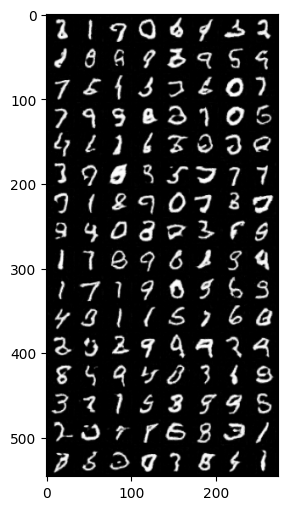

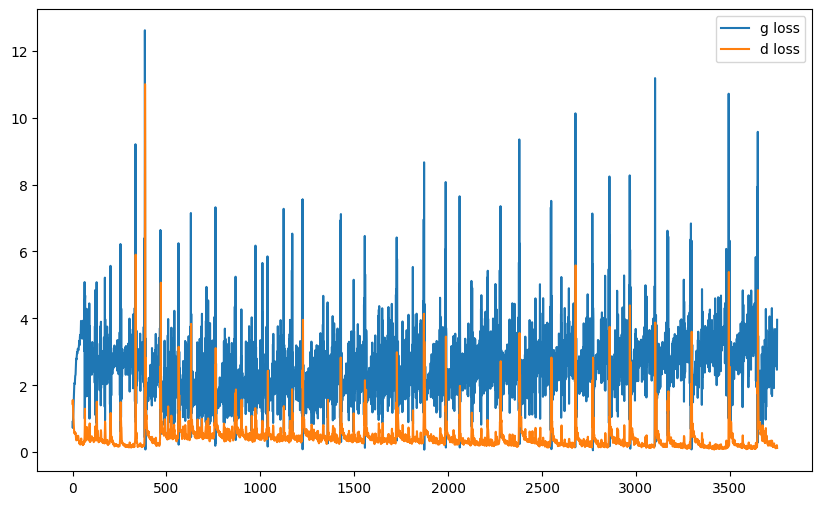

it: 3952; g_loss: 3.8663675785064697; d_loss: 0.13092771172523499; avg_real_score: 0.9632143974304199; avg_fake_score: 0.03150187432765961: : 200it [00:25,  8.99it/s]

generated images


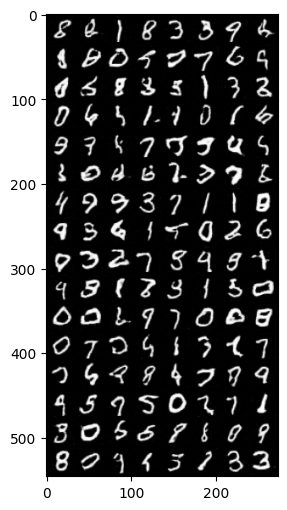

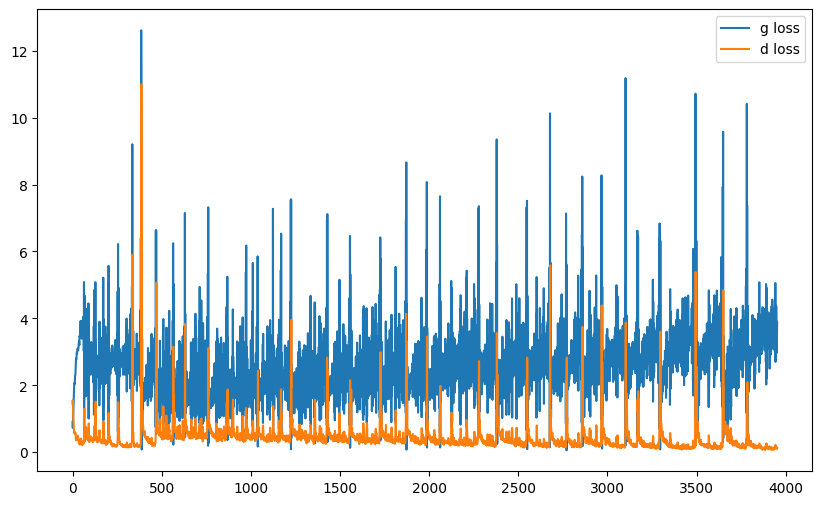

it: 4152; g_loss: 2.519399404525757; d_loss: 0.19659341871738434; avg_real_score: 0.8952100872993469; avg_fake_score: 0.11320962756872177: : 400it [00:49,  7.52it/s] 

generated images


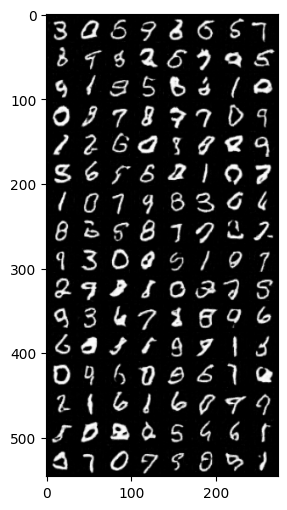

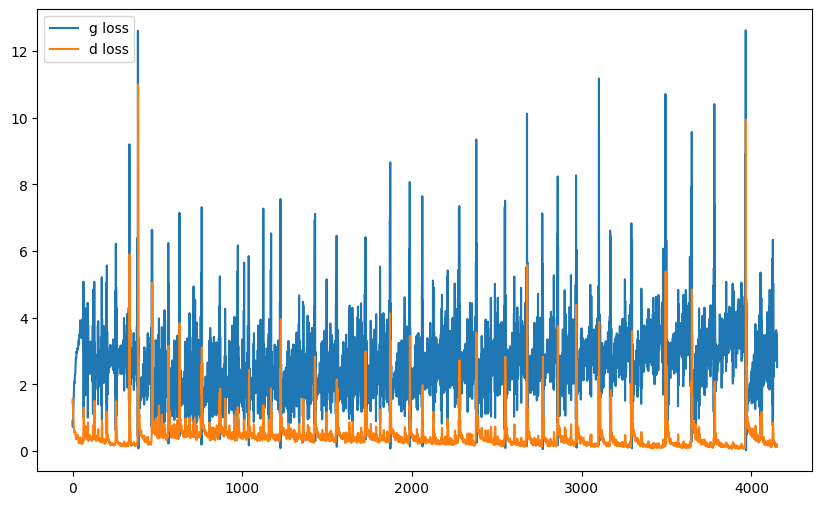

it: 4220; g_loss: 3.0897796154022217; d_loss: 0.18077178299427032; avg_real_score: 0.9292840361595154; avg_fake_score: 0.06977266818284988: : 469it [00:58,  8.04it/s]
it: 4221; g_loss: 4.190966606140137; d_loss: 0.11869361251592636; avg_real_score: 0.9696716666221619; avg_fake_score: 0.02552010677754879: : 0it [00:00, ?it/s]

generated images


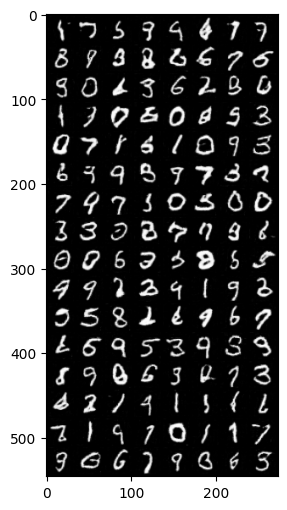

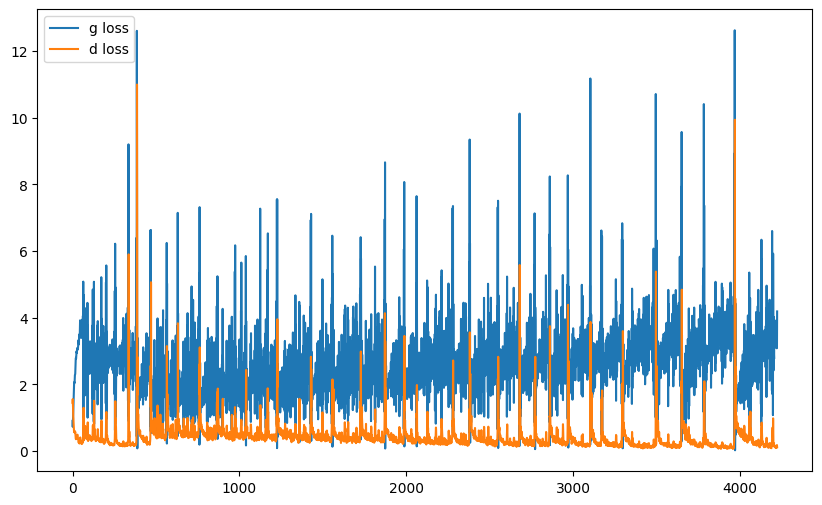

it: 4421; g_loss: 3.6671862602233887; d_loss: 0.09136390686035156; avg_real_score: 0.9555487036705017; avg_fake_score: 0.044278666377067566: : 200it [00:24,  8.64it/s]

generated images


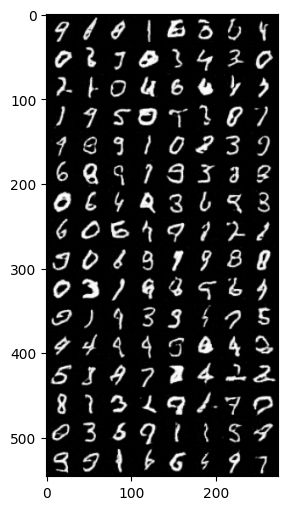

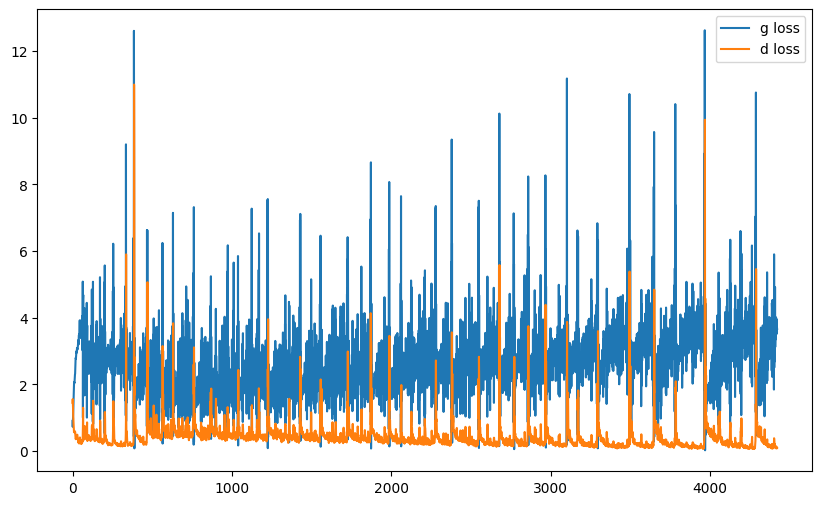

it: 4621; g_loss: 2.852978229522705; d_loss: 0.22956329584121704; avg_real_score: 0.911549985408783; avg_fake_score: 0.08353224396705627: : 400it [00:50,  8.85it/s]

generated images


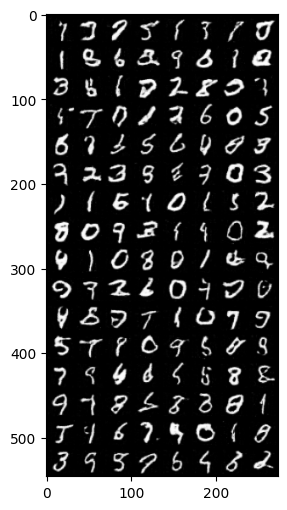

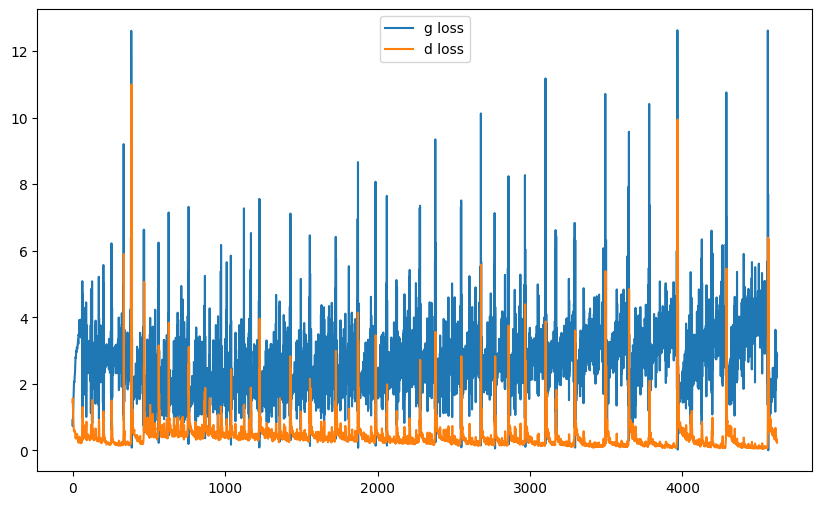

it: 4689; g_loss: 3.5911431312561035; d_loss: 0.20455147325992584; avg_real_score: 0.8491630554199219; avg_fake_score: 0.04184839129447937: : 469it [00:58,  8.01it/s]
it: 4690; g_loss: 3.3009657859802246; d_loss: 0.09092996269464493; avg_real_score: 0.958206832408905; avg_fake_score: 0.06178809702396393: : 0it [00:00, ?it/s]

generated images


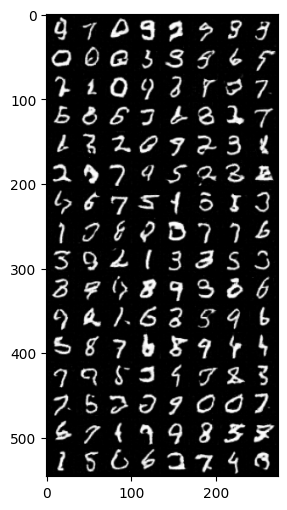

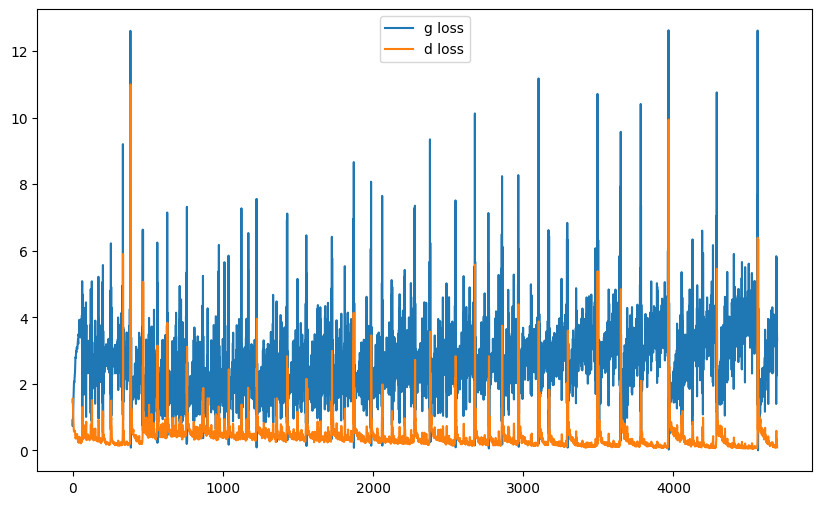

it: 4890; g_loss: 3.0453405380249023; d_loss: 0.14236736297607422; avg_real_score: 0.9257820844650269; avg_fake_score: 0.07232337445020676: : 200it [00:24,  8.79it/s]

generated images


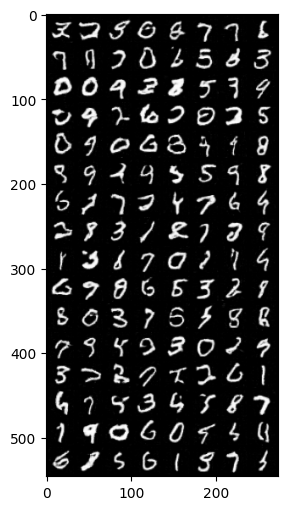

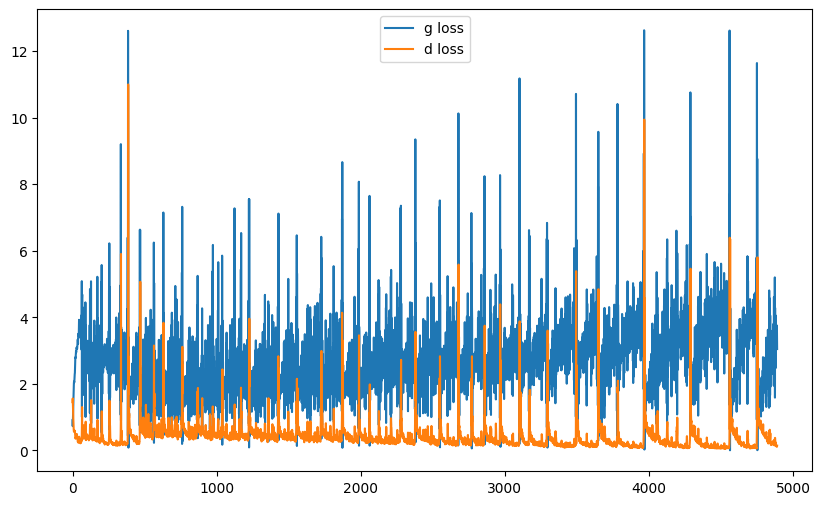

it: 5090; g_loss: 2.765117645263672; d_loss: 0.28216004371643066; avg_real_score: 0.8424092531204224; avg_fake_score: 0.102934330701828: : 400it [00:48,  8.70it/s] 

generated images


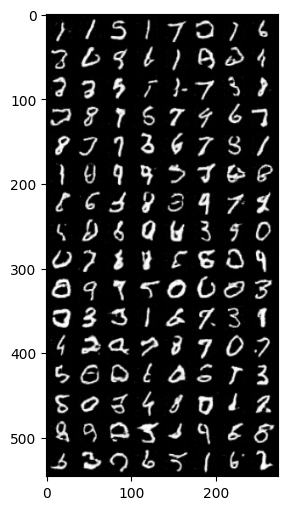

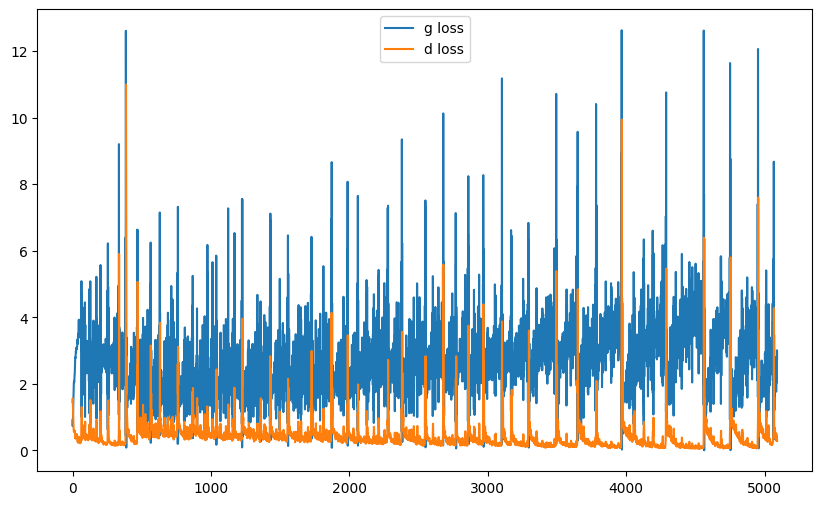

it: 5158; g_loss: 3.615363836288452; d_loss: 0.08470599353313446; avg_real_score: 0.9709483981132507; avg_fake_score: 0.043542712926864624: : 469it [00:57,  8.23it/s]
it: 5159; g_loss: 4.283453464508057; d_loss: 0.08564245700836182; avg_real_score: 0.9727174043655396; avg_fake_score: 0.025057177990674973: : 0it [00:00, ?it/s]

generated images


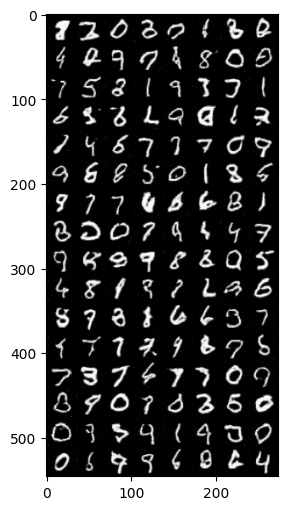

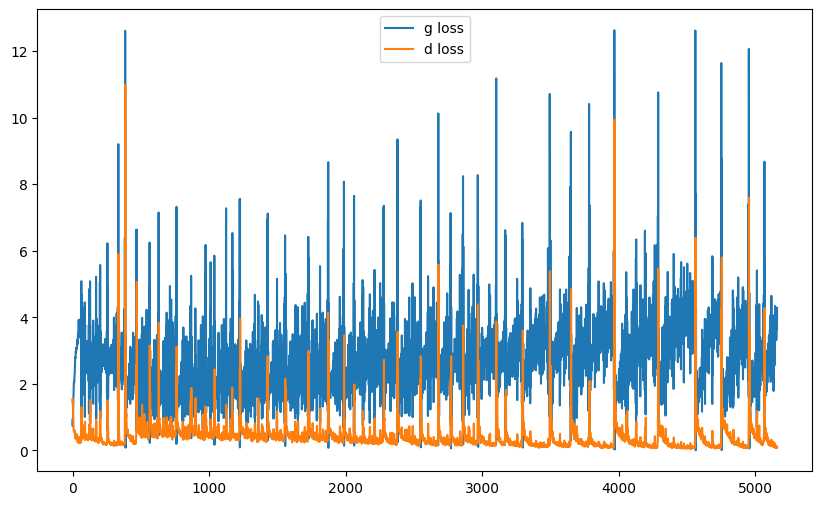

it: 5359; g_loss: 4.60153865814209; d_loss: 0.06431688368320465; avg_real_score: 0.9748477935791016; avg_fake_score: 0.018164046108722687: : 200it [00:24,  8.84it/s]

generated images


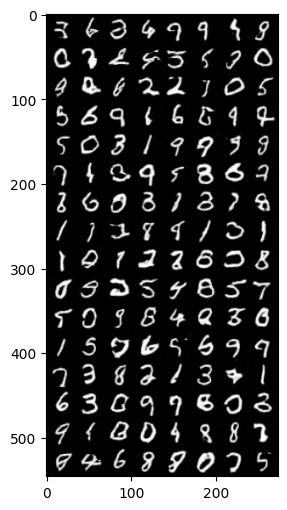

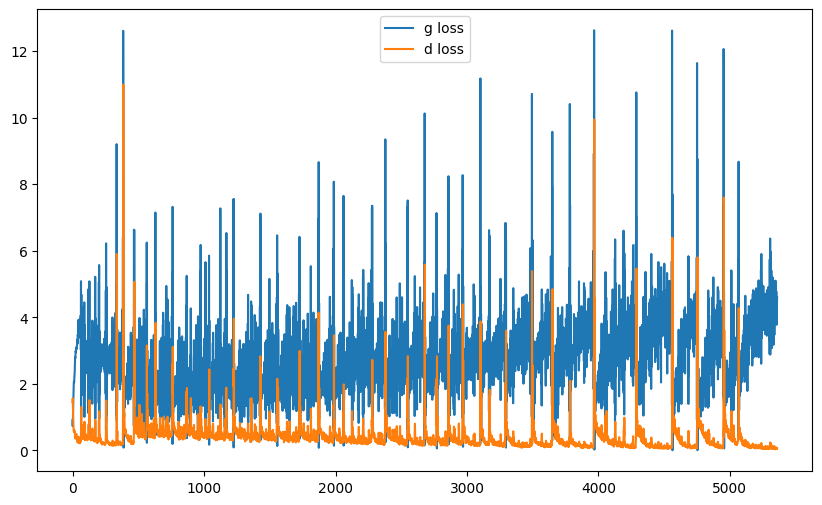

it: 5559; g_loss: 5.831860542297363; d_loss: 0.21945378184318542; avg_real_score: 0.9855663776397705; avg_fake_score: 0.005776166450232267: : 400it [00:48,  8.44it/s]

generated images


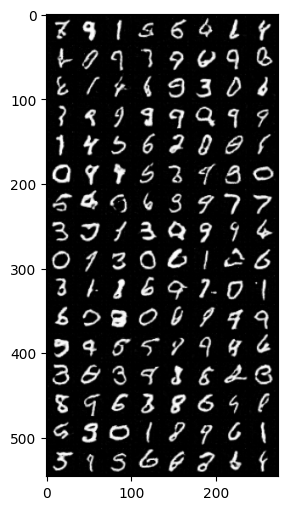

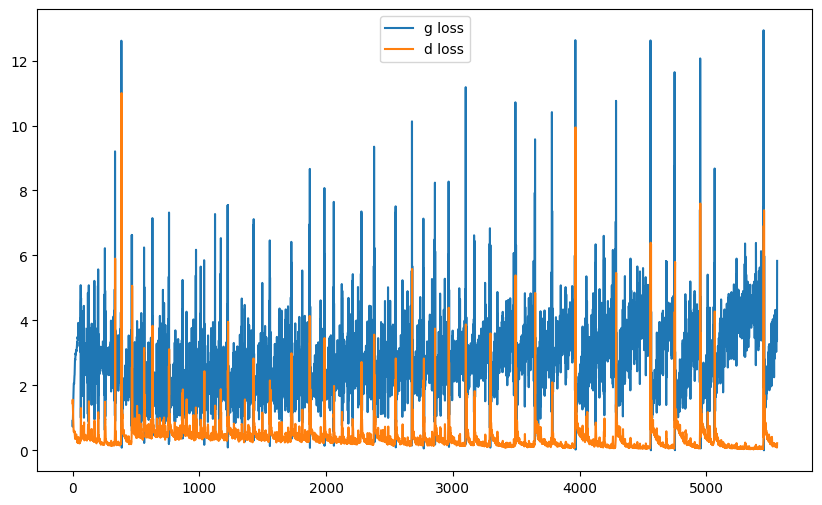

it: 5627; g_loss: 3.8140313625335693; d_loss: 0.07158347964286804; avg_real_score: 0.9606778025627136; avg_fake_score: 0.039253443479537964: : 469it [00:57,  8.09it/s]
it: 5628; g_loss: 4.829754829406738; d_loss: 0.13169924914836884; avg_real_score: 0.9813978672027588; avg_fake_score: 0.013221142813563347: : 0it [00:00, ?it/s]

generated images


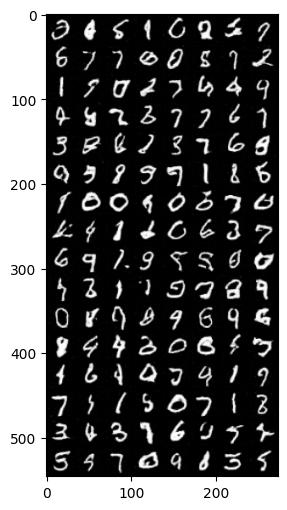

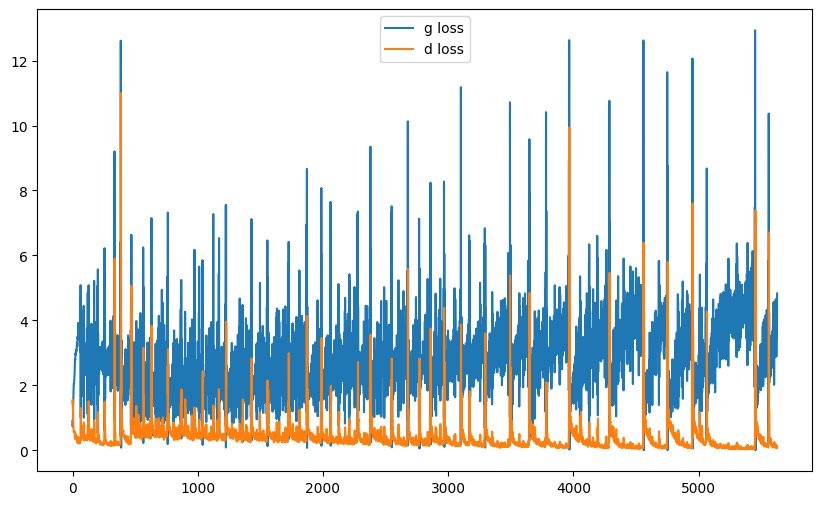

it: 5828; g_loss: 3.922691822052002; d_loss: 0.07536298036575317; avg_real_score: 0.9806466102600098; avg_fake_score: 0.03420356661081314: : 200it [00:24,  6.86it/s] 

generated images


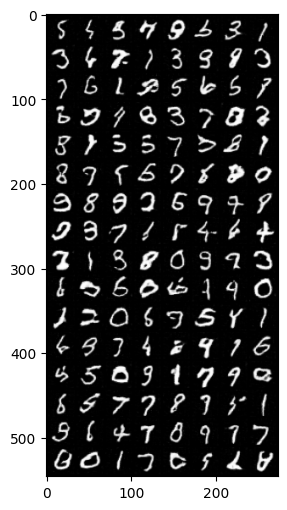

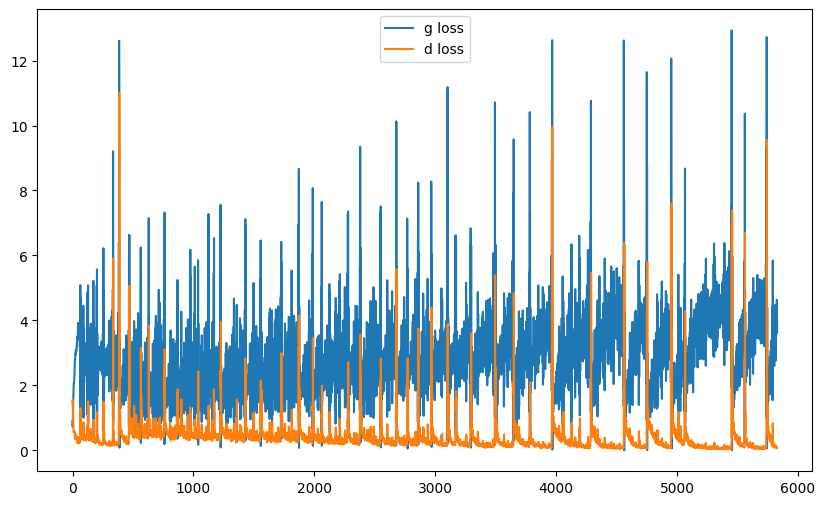

it: 6028; g_loss: 2.3400564193725586; d_loss: 0.39413267374038696; avg_real_score: 0.8247121572494507; avg_fake_score: 0.1396355926990509: : 400it [00:49,  9.16it/s]

generated images


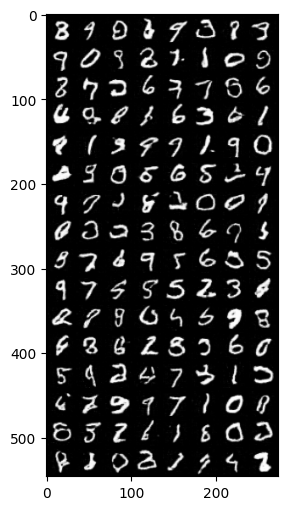

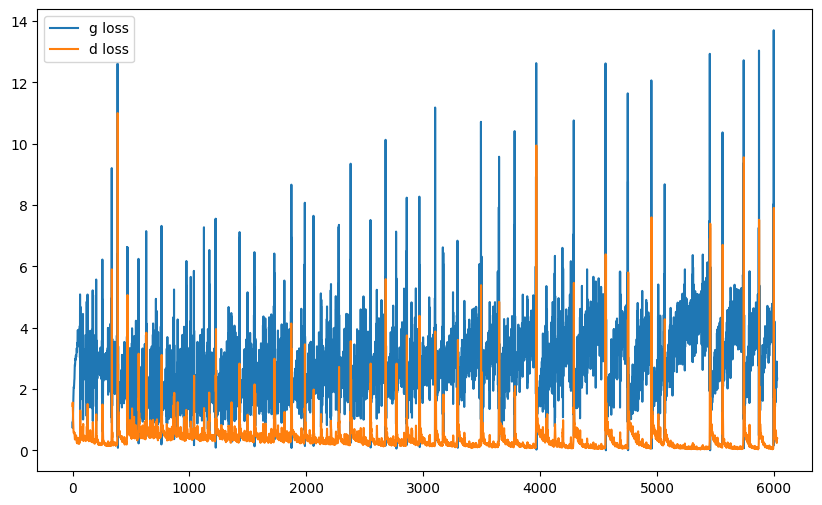

it: 6096; g_loss: 4.258922576904297; d_loss: 0.07788537442684174; avg_real_score: 0.9612979292869568; avg_fake_score: 0.02846667170524597: : 469it [00:58,  8.07it/s]
it: 6097; g_loss: 4.1538615226745605; d_loss: 0.057981520891189575; avg_real_score: 0.9660520553588867; avg_fake_score: 0.0267197173088789: : 0it [00:00, ?it/s]

generated images


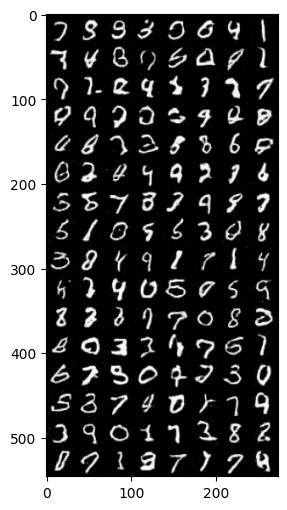

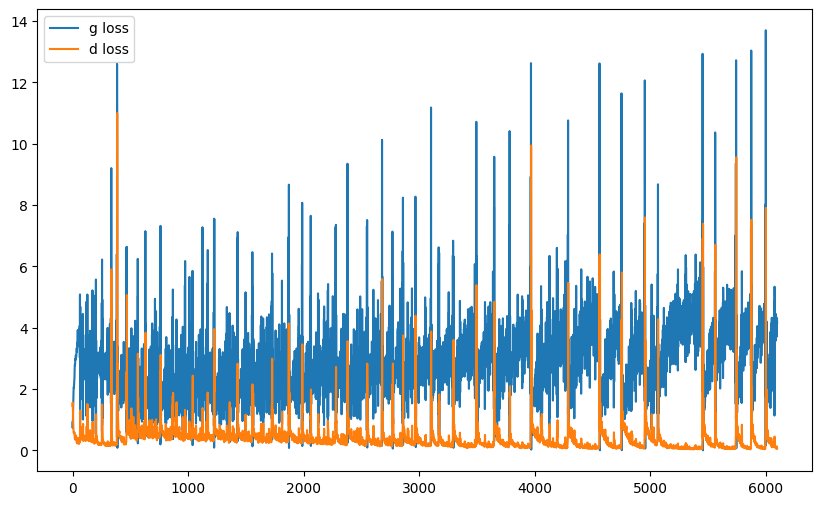

it: 6297; g_loss: 4.103241920471191; d_loss: 0.049194201827049255; avg_real_score: 0.9655952453613281; avg_fake_score: 0.03201078623533249: : 200it [00:24,  7.79it/s]

generated images


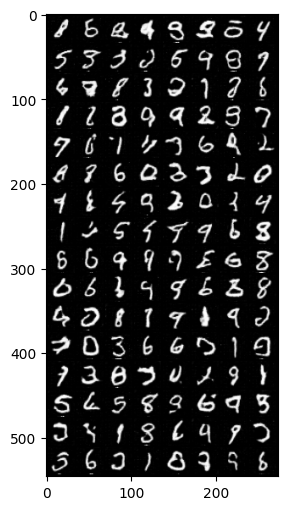

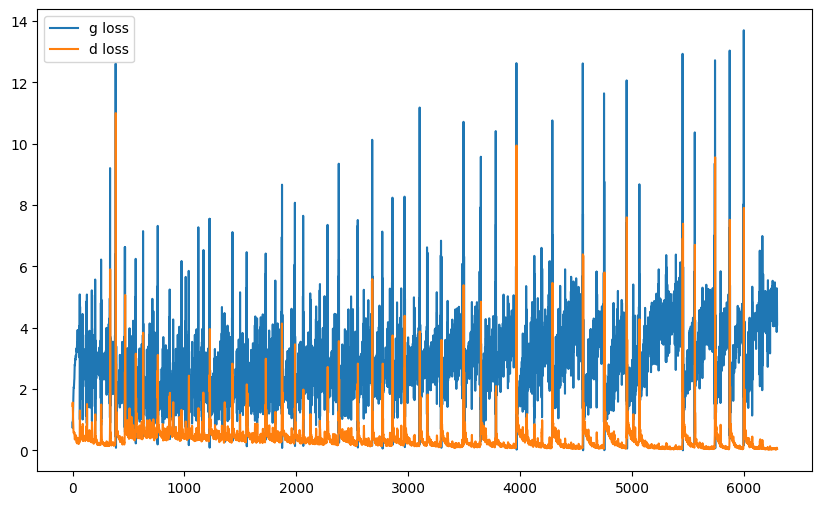

it: 6497; g_loss: 1.5713765621185303; d_loss: 0.7151761651039124; avg_real_score: 0.6614086031913757; avg_fake_score: 0.2602258324623108: : 400it [00:48,  8.06it/s]

generated images


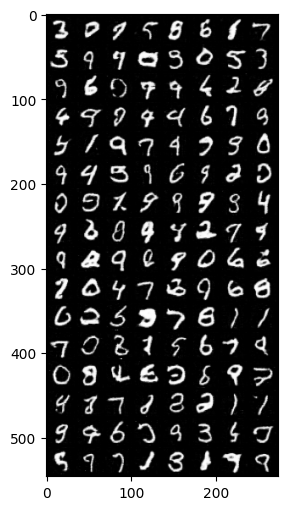

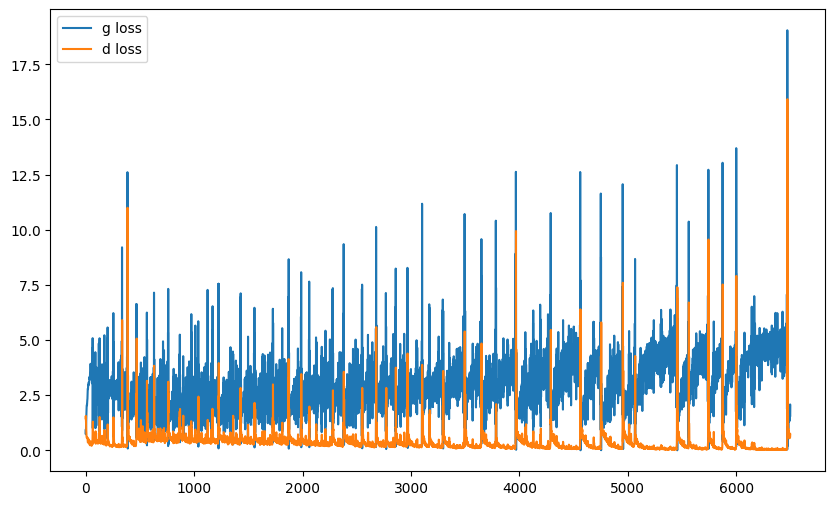

it: 6565; g_loss: 2.3422274589538574; d_loss: 0.32550305128097534; avg_real_score: 0.7765350341796875; avg_fake_score: 0.14236491918563843: : 469it [00:57,  8.12it/s]
it: 6566; g_loss: 1.8128385543823242; d_loss: 0.2750847339630127; avg_real_score: 0.8607990741729736; avg_fake_score: 0.2208603322505951: : 0it [00:00, ?it/s]

generated images


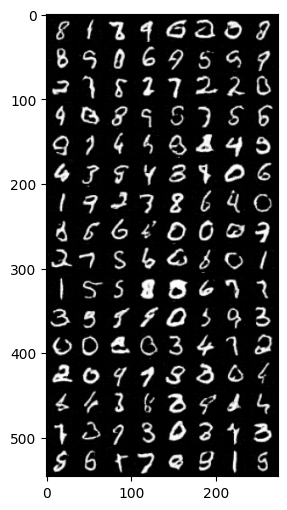

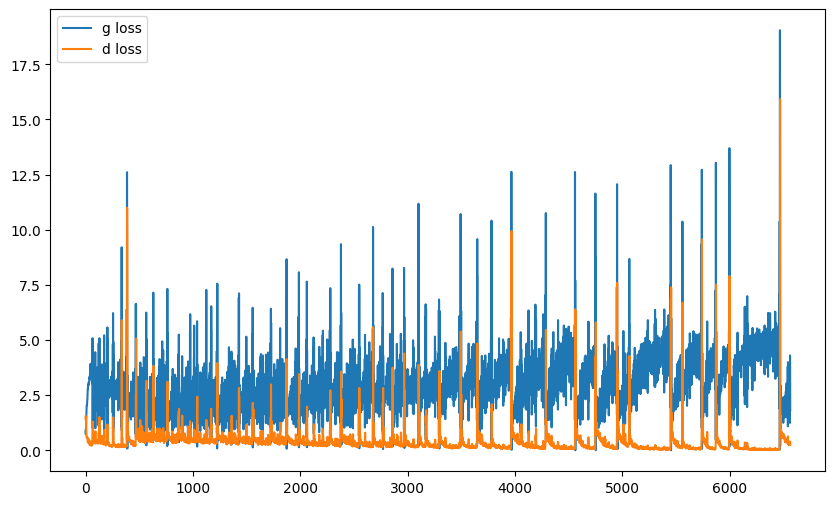

it: 6766; g_loss: 4.107948303222656; d_loss: 0.08707772195339203; avg_real_score: 0.9829143285751343; avg_fake_score: 0.027311621233820915: : 200it [00:24,  8.51it/s]

generated images


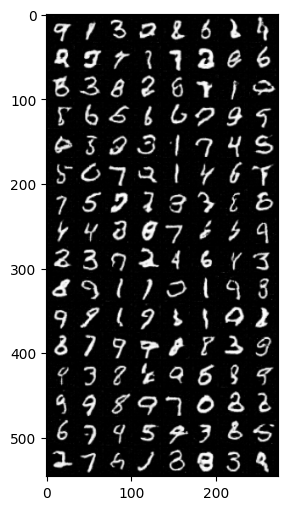

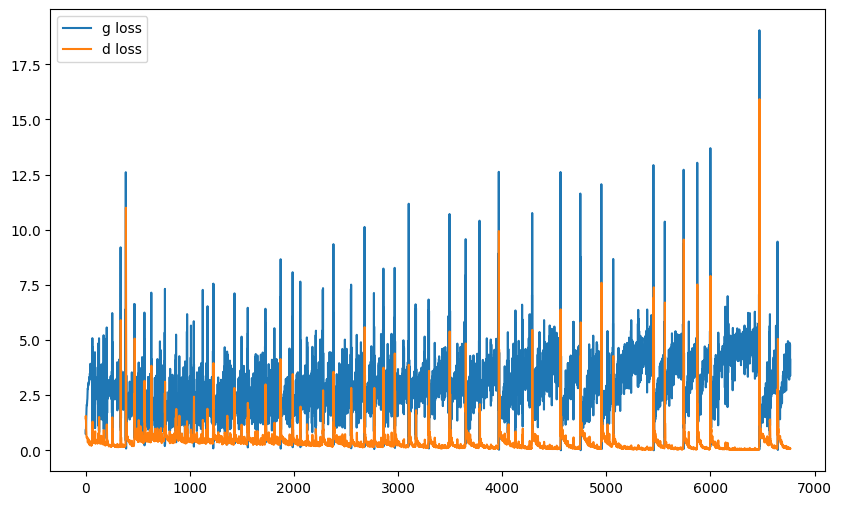

it: 6966; g_loss: 4.200398921966553; d_loss: 0.07966534048318863; avg_real_score: 0.9728183746337891; avg_fake_score: 0.027699735015630722: : 400it [00:49,  6.47it/s]

generated images


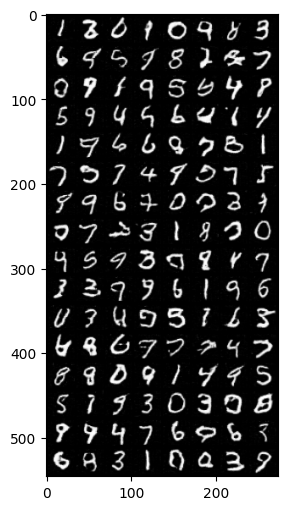

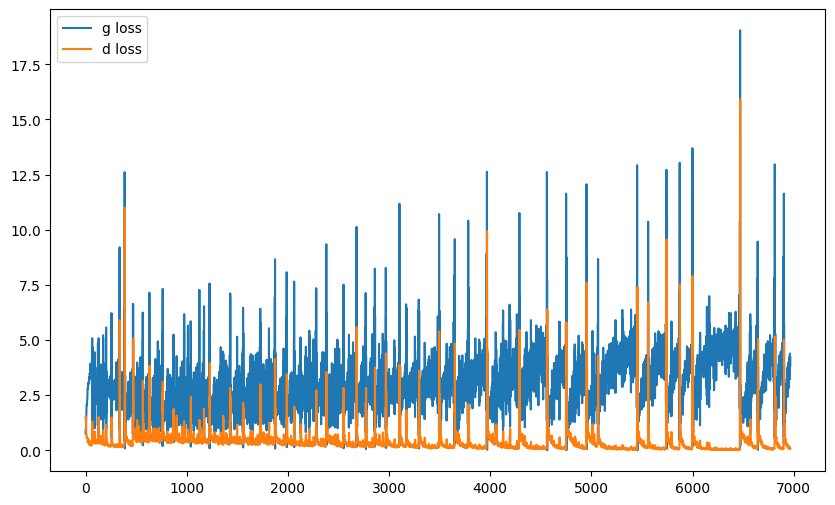

it: 7034; g_loss: 2.1233034133911133; d_loss: 0.4520237445831299; avg_real_score: 0.6723753809928894; avg_fake_score: 0.174686461687088: : 469it [00:58,  8.04it/s]
it: 7035; g_loss: 3.6756436824798584; d_loss: 0.29596027731895447; avg_real_score: 0.9896465539932251; avg_fake_score: 0.03981318697333336: : 0it [00:00, ?it/s]

generated images


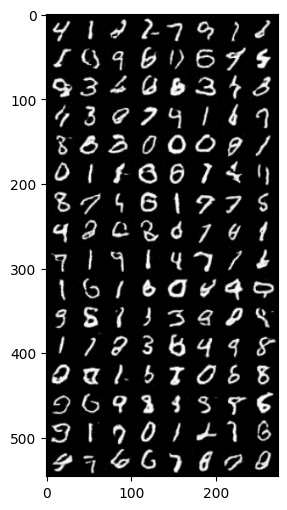

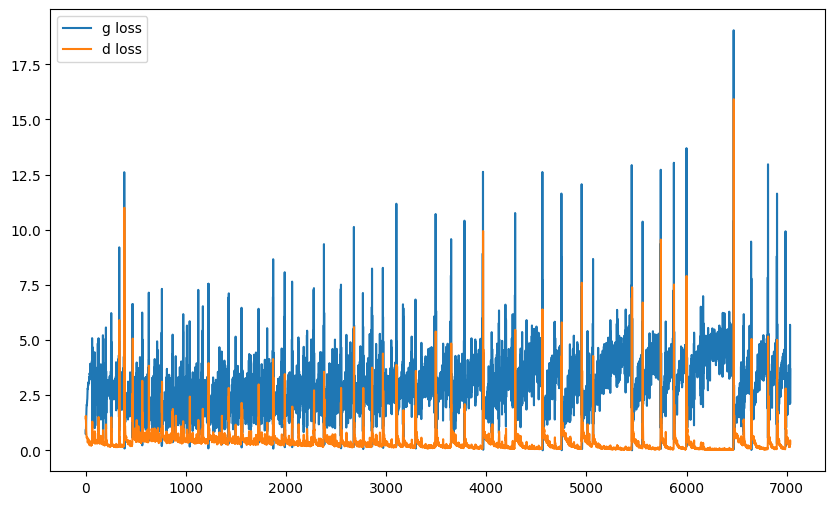

it: 7235; g_loss: 4.854071617126465; d_loss: 0.03393673151731491; avg_real_score: 0.9774264097213745; avg_fake_score: 0.015324284322559834: : 200it [00:24,  8.69it/s]

generated images


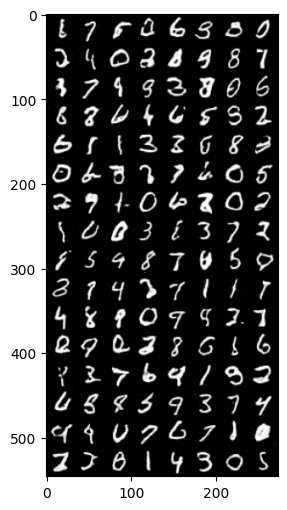

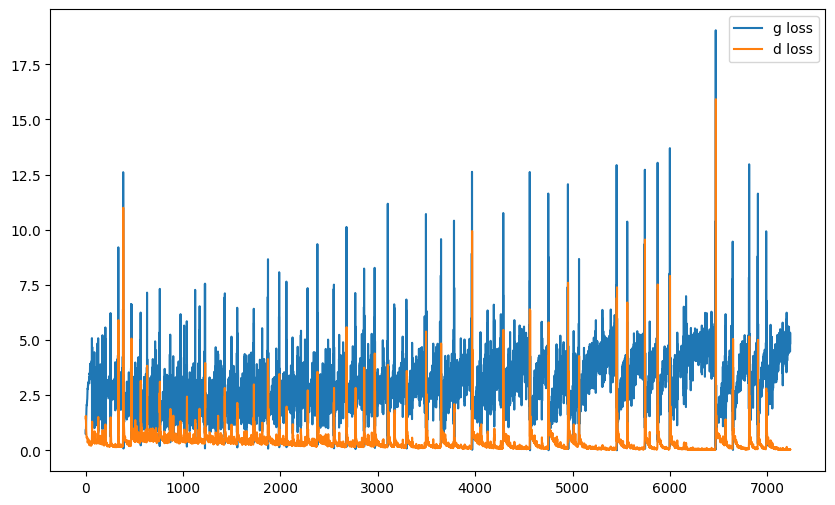

it: 7435; g_loss: 5.4034342765808105; d_loss: 0.023822730407118797; avg_real_score: 0.9916219711303711; avg_fake_score: 0.009073419496417046: : 400it [00:49,  9.04it/s]

generated images


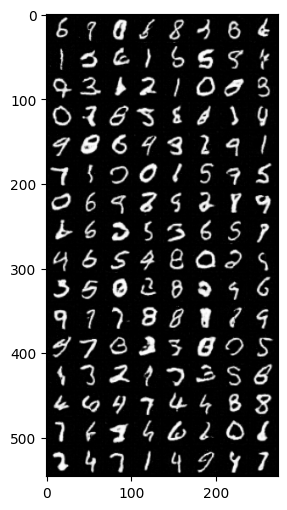

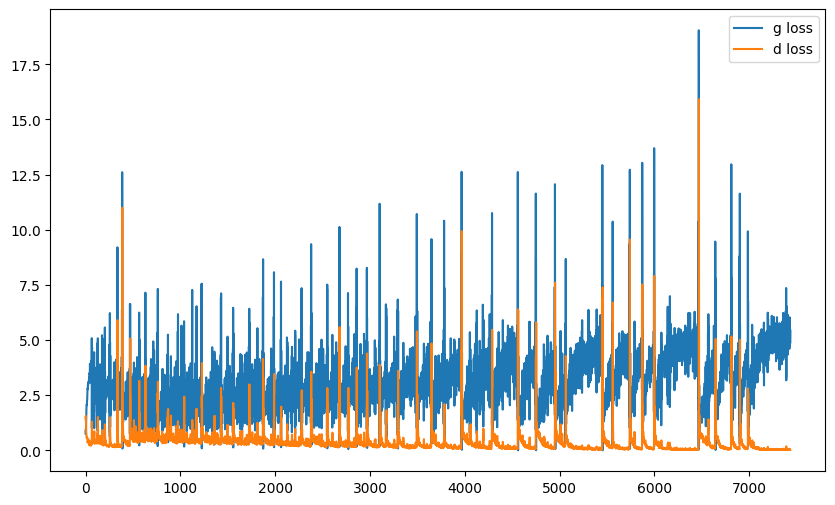

it: 7503; g_loss: 0.7661918997764587; d_loss: 0.9822139739990234; avg_real_score: 0.5187322497367859; avg_fake_score: 0.5042203664779663: : 469it [00:57,  8.15it/s]
it: 7504; g_loss: 1.9109385013580322; d_loss: 1.0627548694610596; avg_real_score: 0.8636786937713623; avg_fake_score: 0.1952848732471466: : 0it [00:00, ?it/s]

generated images


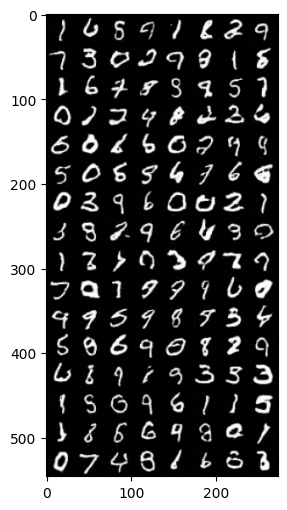

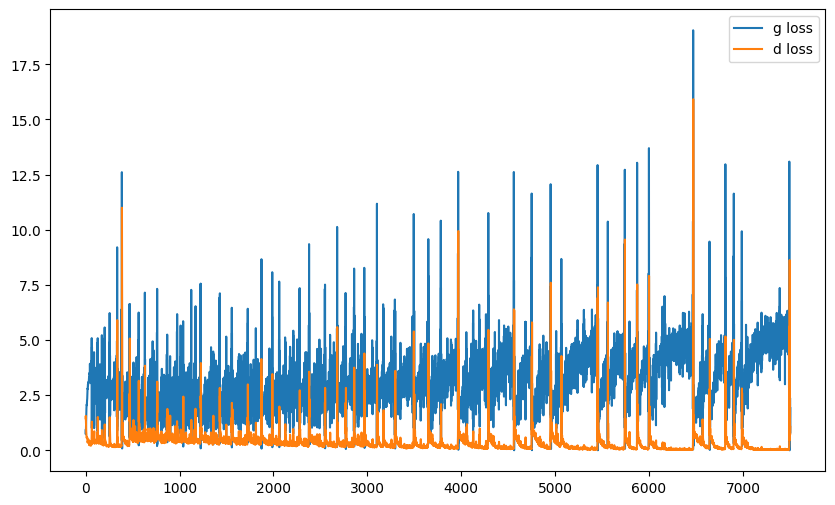

it: 7704; g_loss: 4.090188503265381; d_loss: 0.1450224220752716; avg_real_score: 0.8805270791053772; avg_fake_score: 0.02972724847495556: : 200it [00:24,  9.17it/s] 

generated images


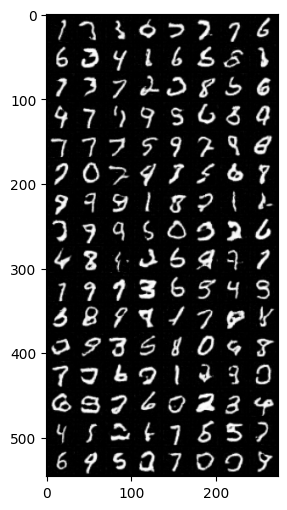

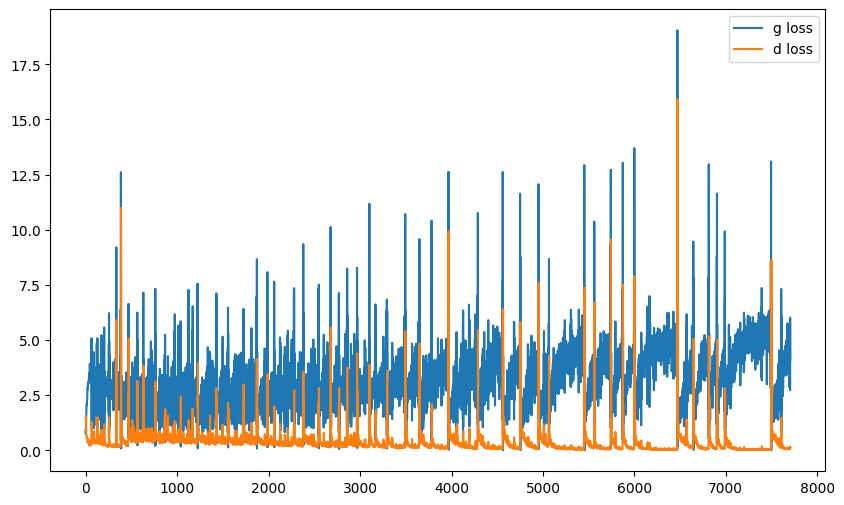

it: 7904; g_loss: 3.5464329719543457; d_loss: 0.12597927451133728; avg_real_score: 0.9423246383666992; avg_fake_score: 0.04308714717626572: : 400it [00:48,  8.91it/s]

generated images


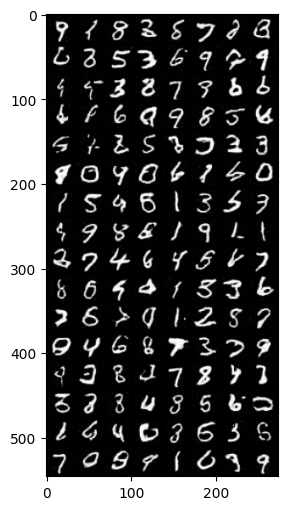

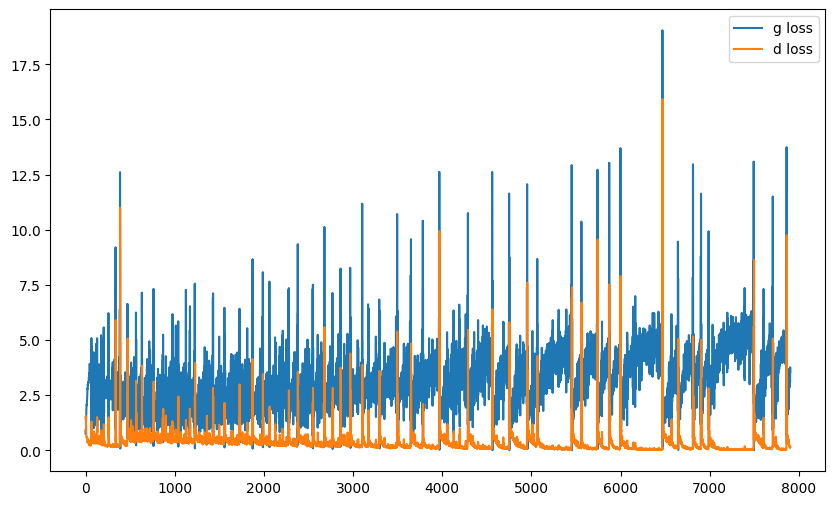

it: 7972; g_loss: 5.262574195861816; d_loss: 0.07106761634349823; avg_real_score: 0.9957449436187744; avg_fake_score: 0.010450322180986404: : 469it [00:57,  8.18it/s]
it: 7973; g_loss: 2.912972927093506; d_loss: 0.12074753642082214; avg_real_score: 0.8986520767211914; avg_fake_score: 0.0871114581823349: : 0it [00:00, ?it/s]

generated images


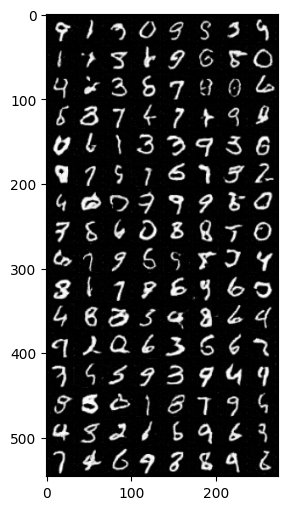

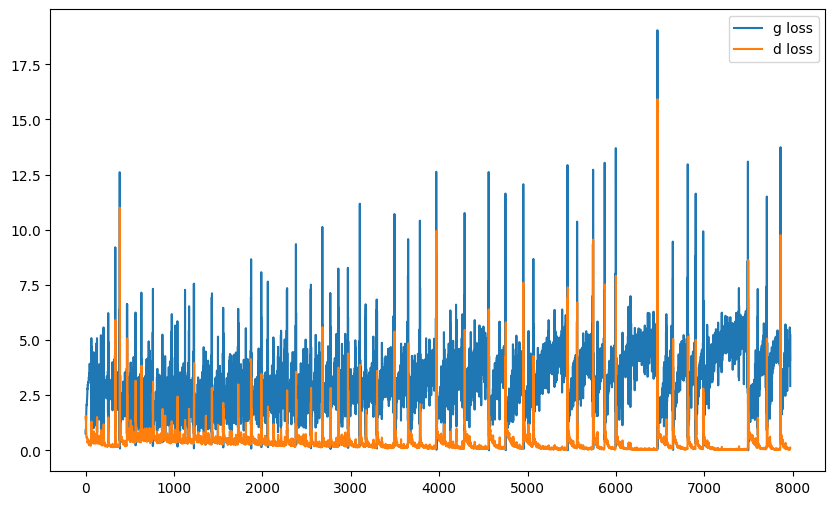

it: 8173; g_loss: 2.1756083965301514; d_loss: 0.810553252696991; avg_real_score: 0.8286682367324829; avg_fake_score: 0.1496412307024002: : 200it [00:24,  8.38it/s] 

generated images


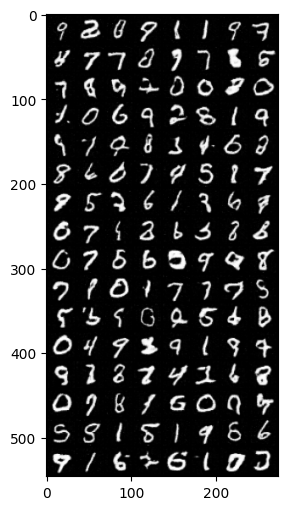

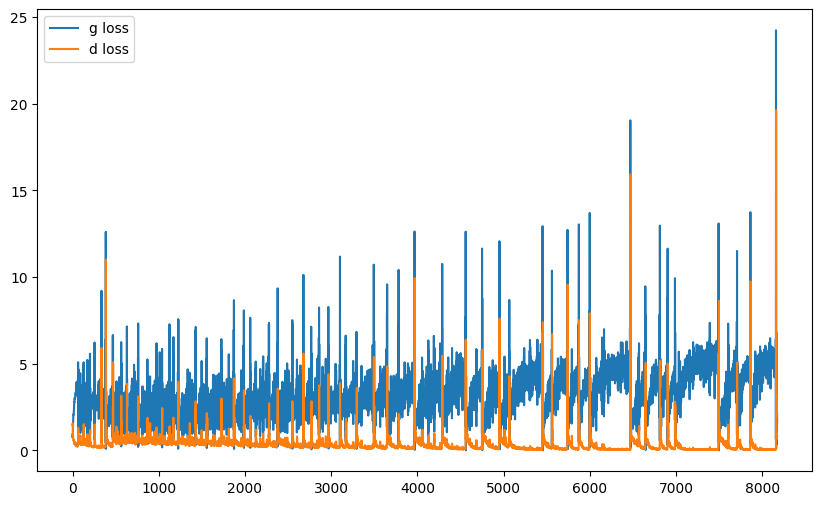

it: 8373; g_loss: 5.10521936416626; d_loss: 0.02436871826648712; avg_real_score: 0.9853858351707458; avg_fake_score: 0.01234424952417612: : 400it [00:49,  9.16it/s]   

generated images


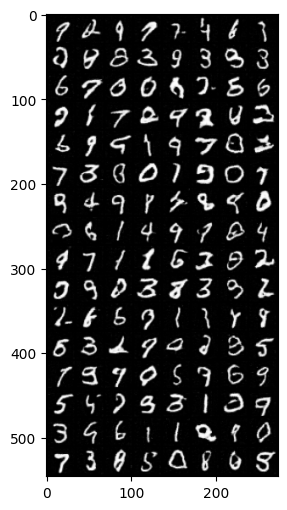

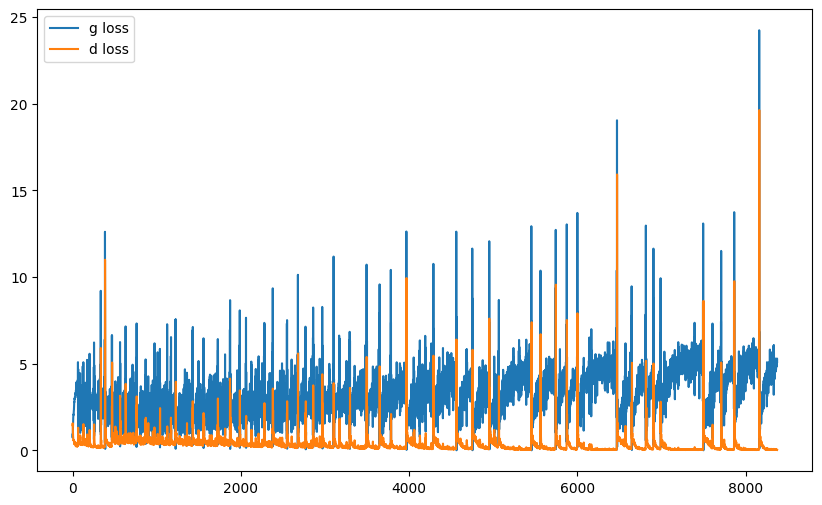

it: 8441; g_loss: 5.242455959320068; d_loss: 0.02074604108929634; avg_real_score: 0.9931424856185913; avg_fake_score: 0.010339831002056599: : 469it [00:58,  8.08it/s]
it: 8442; g_loss: 4.907779693603516; d_loss: 0.04305930435657501; avg_real_score: 0.9818249940872192; avg_fake_score: 0.015811750665307045: : 0it [00:00, ?it/s]

generated images


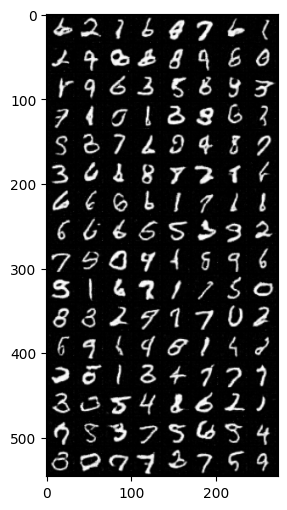

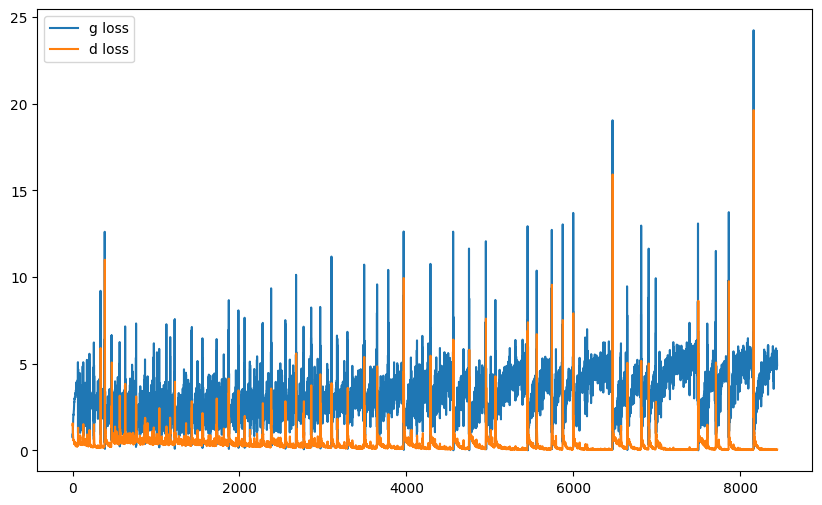

it: 8642; g_loss: 4.987725734710693; d_loss: 0.025386998429894447; avg_real_score: 0.9845290780067444; avg_fake_score: 0.013023139908909798: : 200it [00:24,  9.06it/s]

generated images


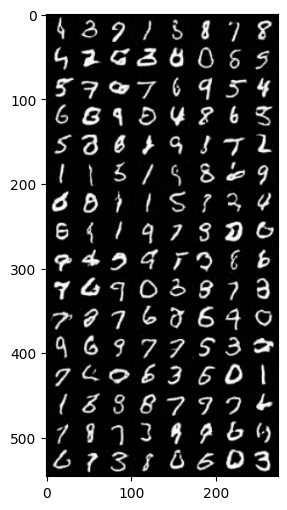

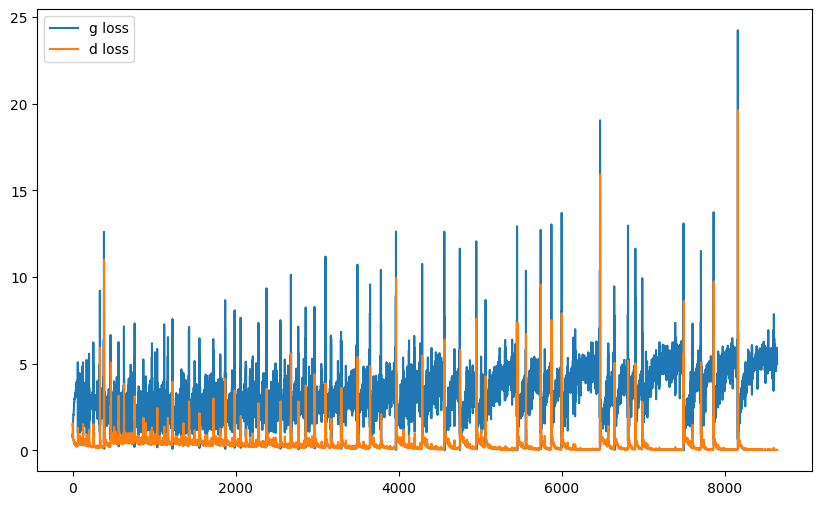

it: 8842; g_loss: 1.8732086420059204; d_loss: 0.5446823835372925; avg_real_score: 0.8179357051849365; avg_fake_score: 0.1902848482131958: : 400it [00:49,  9.07it/s]

generated images


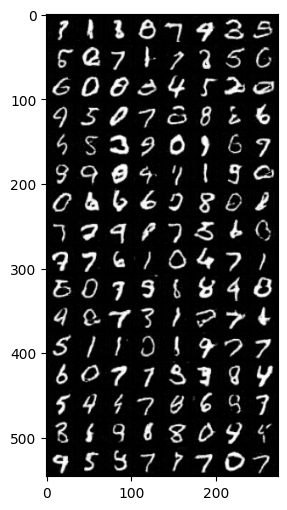

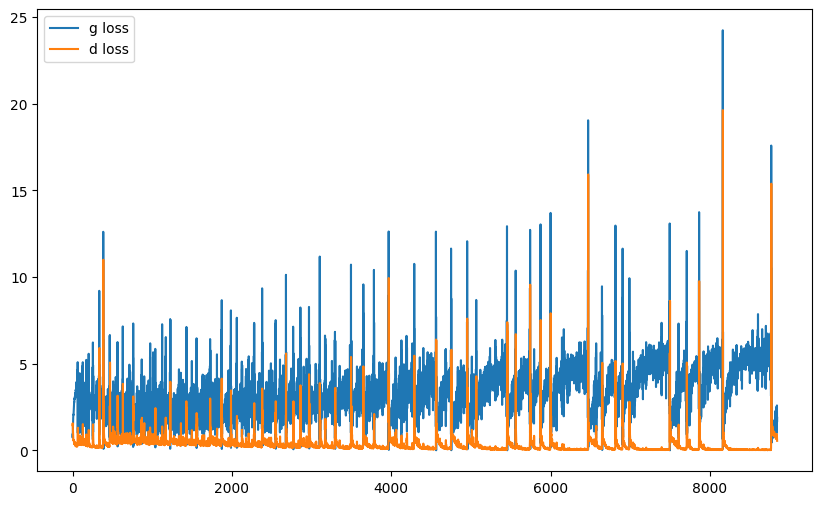

it: 8910; g_loss: 2.5779542922973633; d_loss: 0.29551661014556885; avg_real_score: 0.8554953336715698; avg_fake_score: 0.11153824627399445: : 469it [00:58,  8.01it/s]
it: 8911; g_loss: 2.698319435119629; d_loss: 0.33639100193977356; avg_real_score: 0.8790171146392822; avg_fake_score: 0.104837566614151: : 0it [00:00, ?it/s]

generated images


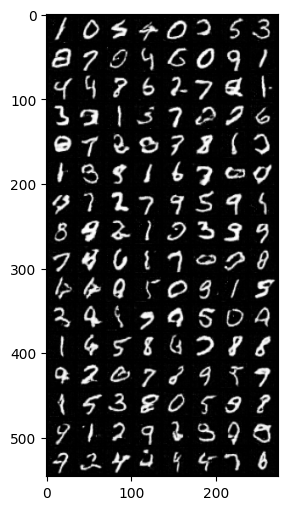

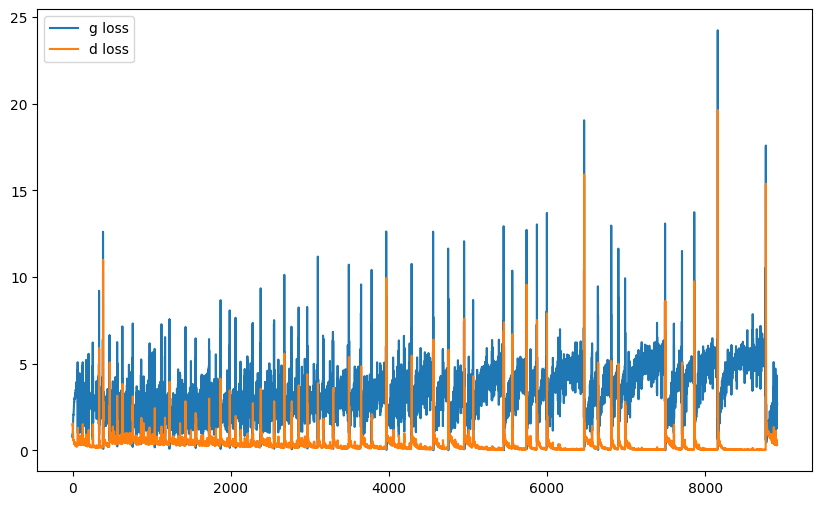

it: 9111; g_loss: 1.6832072734832764; d_loss: 0.5502707958221436; avg_real_score: 0.7677726745605469; avg_fake_score: 0.2419813871383667: : 200it [00:24,  7.13it/s] 

generated images


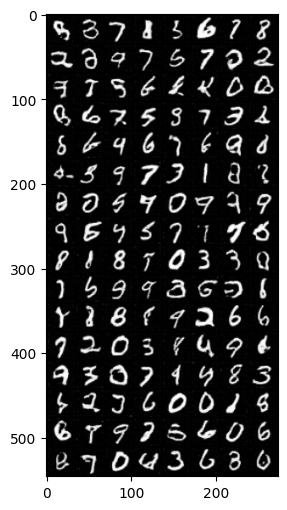

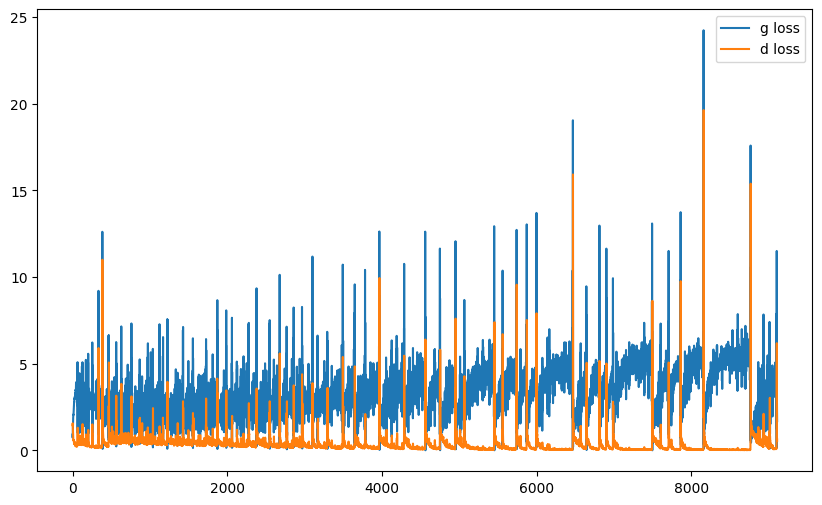

it: 9311; g_loss: 5.414978504180908; d_loss: 0.025417514145374298; avg_real_score: 0.9896303415298462; avg_fake_score: 0.009734511375427246: : 400it [00:48,  8.99it/s]

generated images


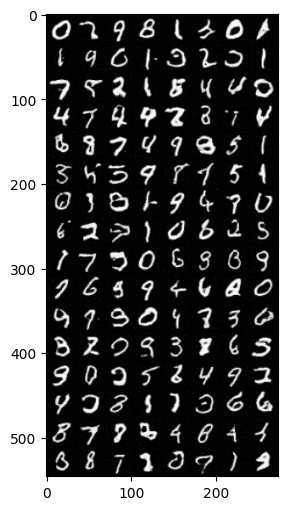

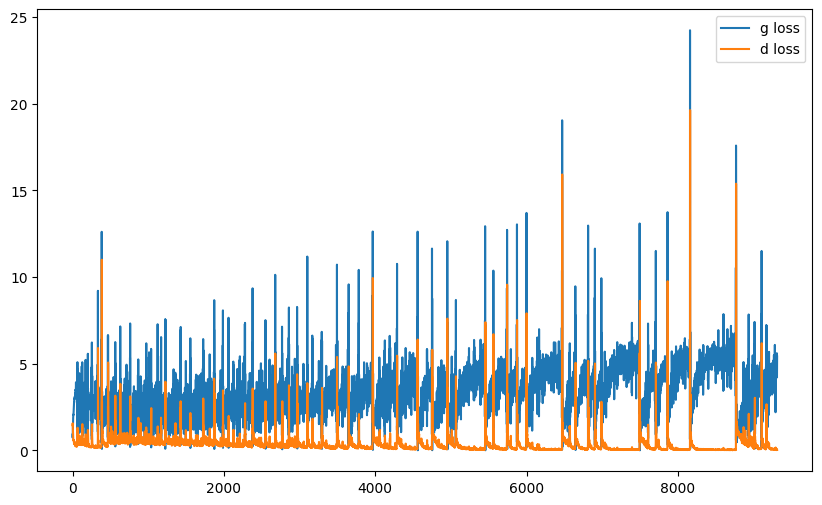

it: 9379; g_loss: 5.02143669128418; d_loss: 0.06633282452821732; avg_real_score: 0.9442879557609558; avg_fake_score: 0.017686791718006134: : 469it [00:57,  8.15it/s]
it: 9380; g_loss: 4.819342613220215; d_loss: 0.025554921478033066; avg_real_score: 0.9917956590652466; avg_fake_score: 0.016049256548285484: : 0it [00:00, ?it/s]

generated images


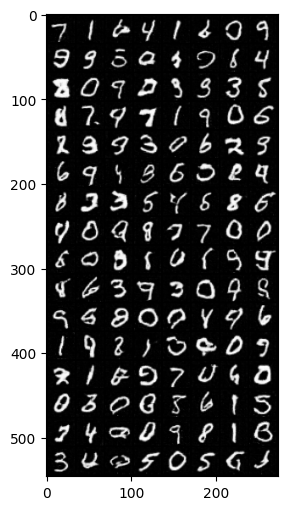

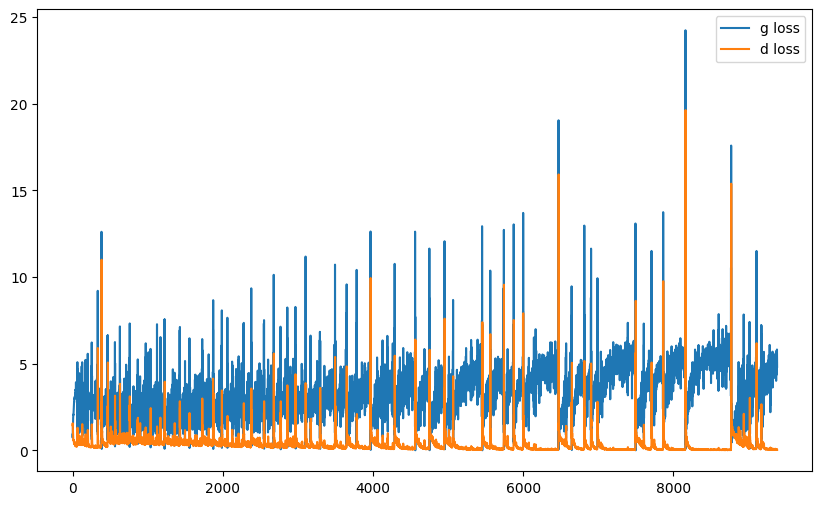

it: 9580; g_loss: 2.709383964538574; d_loss: 0.2782805860042572; avg_real_score: 0.8906082510948181; avg_fake_score: 0.0962674617767334: : 200it [00:25,  8.60it/s]  

generated images


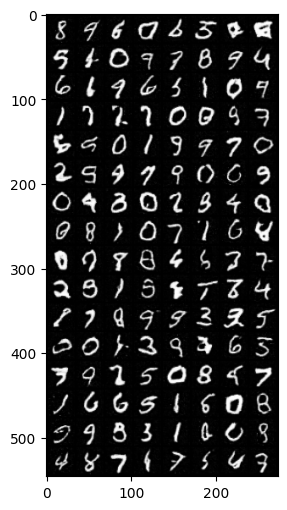

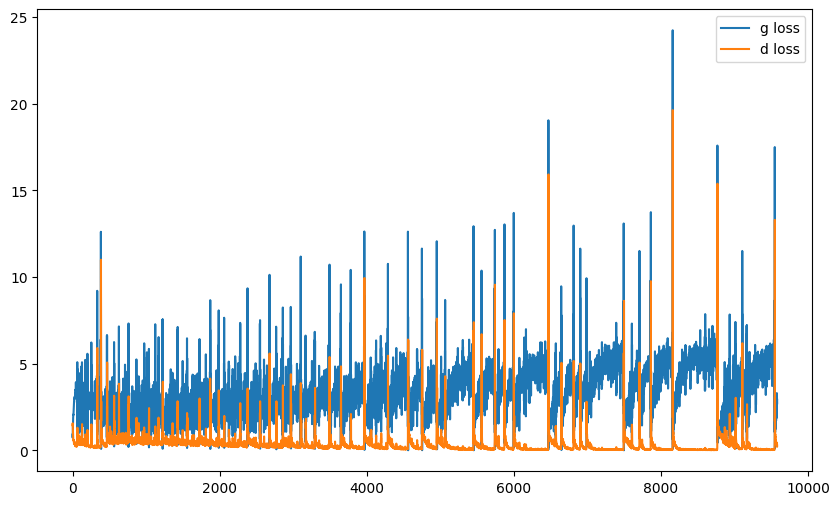

it: 9780; g_loss: 5.383390426635742; d_loss: 0.02537449076771736; avg_real_score: 0.9955276250839233; avg_fake_score: 0.010016314685344696: : 400it [00:48,  6.91it/s]

generated images


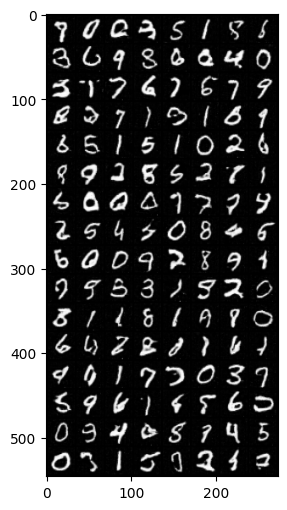

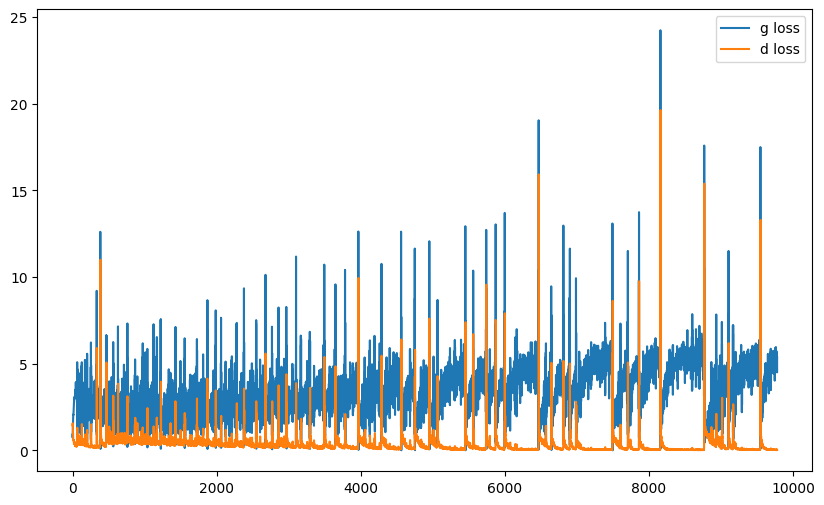

it: 9848; g_loss: 5.951173782348633; d_loss: 0.013775513507425785; avg_real_score: 0.9906746745109558; avg_fake_score: 0.0051848697476089: : 469it [00:57,  8.10it/s]
it: 9849; g_loss: 5.607656002044678; d_loss: 0.013898583129048347; avg_real_score: 0.9918468594551086; avg_fake_score: 0.007017148658633232: : 0it [00:00, ?it/s]

generated images


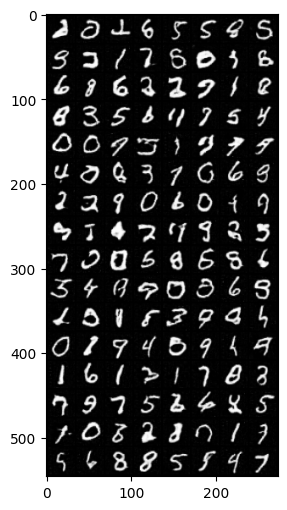

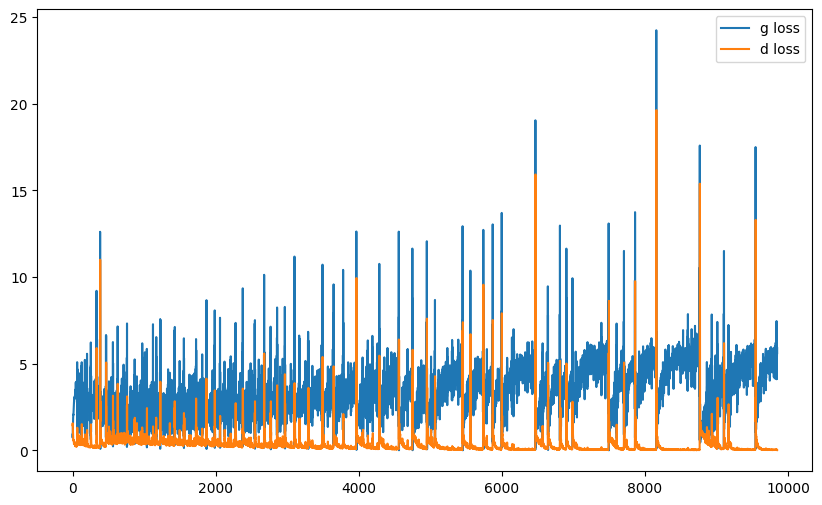

it: 10049; g_loss: 4.694638729095459; d_loss: 0.02386970818042755; avg_real_score: 0.9852844476699829; avg_fake_score: 0.018415361642837524: : 200it [00:25,  9.04it/s]

generated images


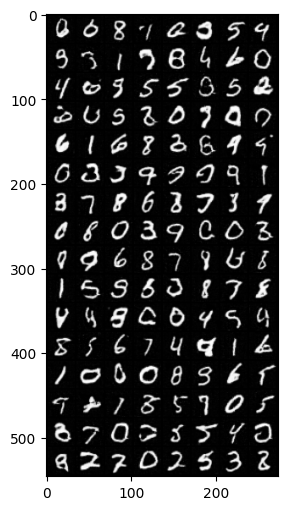

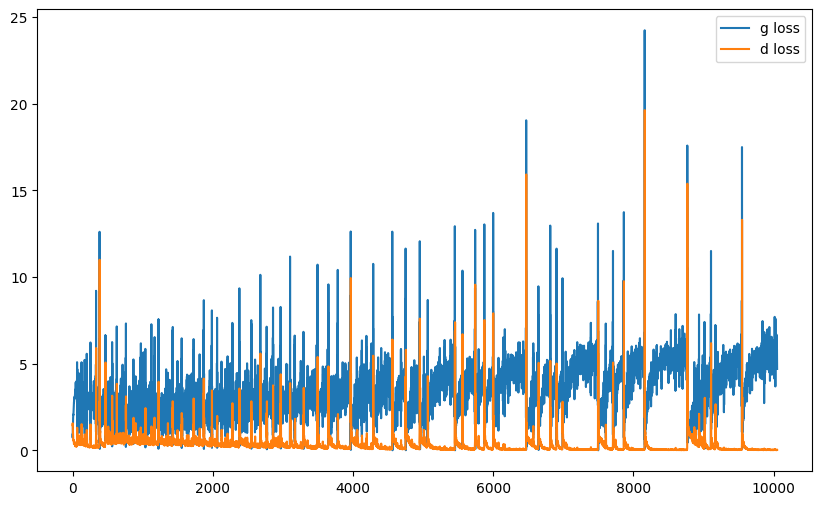

it: 10249; g_loss: 3.014784097671509; d_loss: 0.34374815225601196; avg_real_score: 0.8673176765441895; avg_fake_score: 0.0862746611237526: : 400it [00:50,  8.46it/s] 

generated images


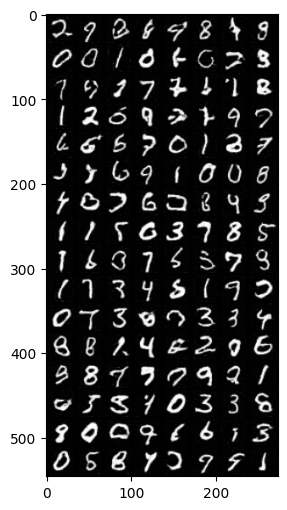

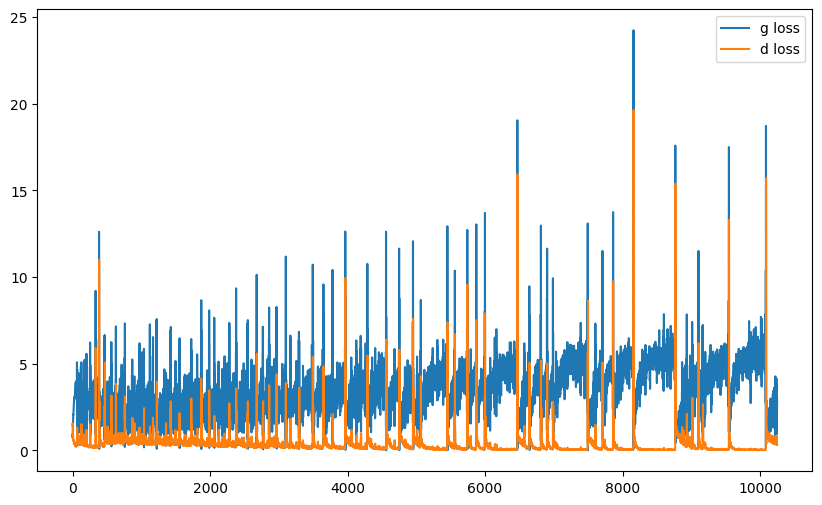

it: 10317; g_loss: 1.735247015953064; d_loss: 0.5219283699989319; avg_real_score: 0.6678506731987; avg_fake_score: 0.27288660407066345: : 469it [00:59,  7.94it/s]
it: 10318; g_loss: 3.516671657562256; d_loss: 0.3162314295768738; avg_real_score: 0.9515852332115173; avg_fake_score: 0.04594902694225311: : 0it [00:00, ?it/s]

generated images


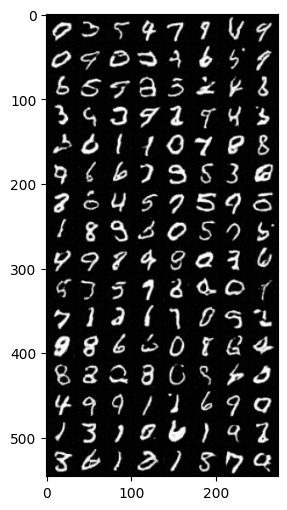

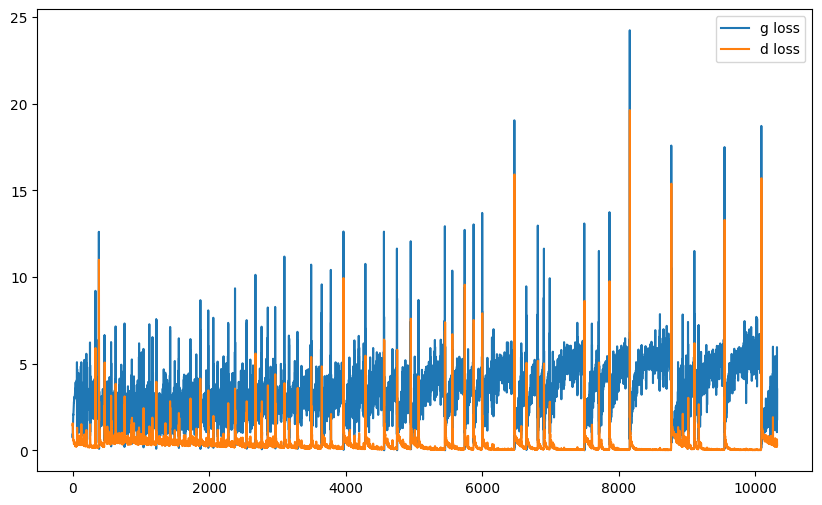

it: 10518; g_loss: 4.122455596923828; d_loss: 0.06288626790046692; avg_real_score: 0.9656426906585693; avg_fake_score: 0.03649718686938286: : 200it [00:25,  8.31it/s]  

generated images


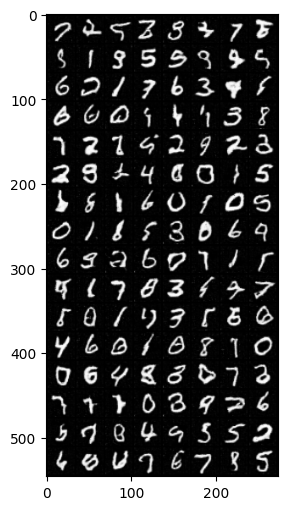

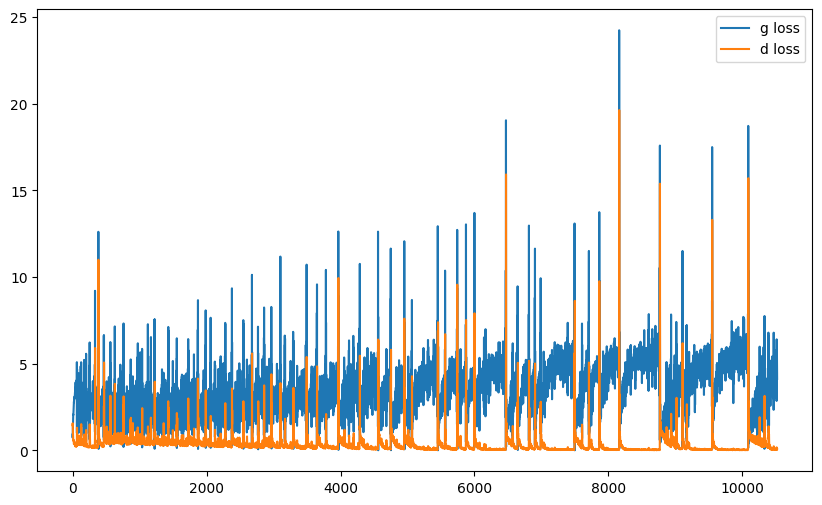

it: 10718; g_loss: 2.7162320613861084; d_loss: 0.5780395269393921; avg_real_score: 0.8603333234786987; avg_fake_score: 0.09476075321435928: : 400it [00:50,  8.76it/s] 

generated images


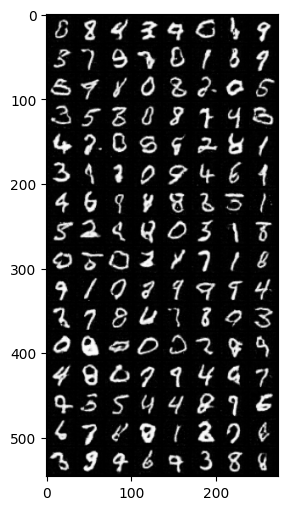

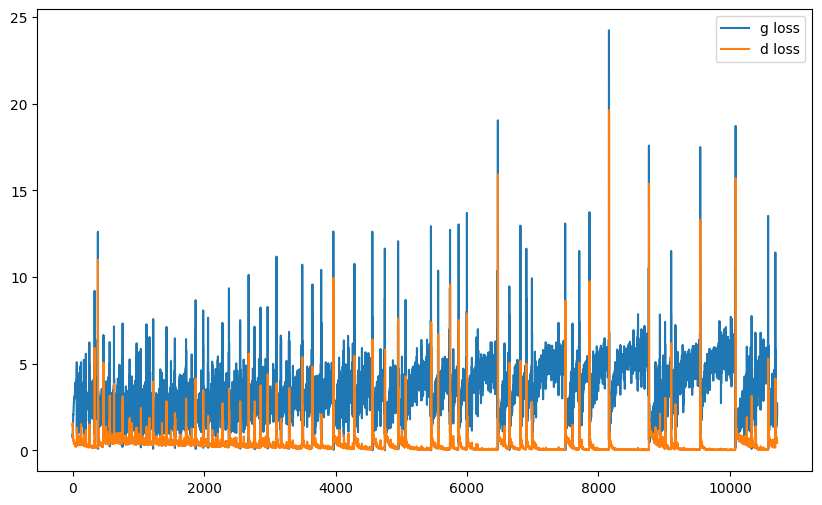

it: 10786; g_loss: 5.431870460510254; d_loss: 0.215923473238945; avg_real_score: 0.9867006540298462; avg_fake_score: 0.008059932850301266: : 469it [00:59,  7.85it/s]
it: 10787; g_loss: 1.6799089908599854; d_loss: 0.2579706311225891; avg_real_score: 0.8020554780960083; avg_fake_score: 0.28310927748680115: : 0it [00:00, ?it/s]

generated images


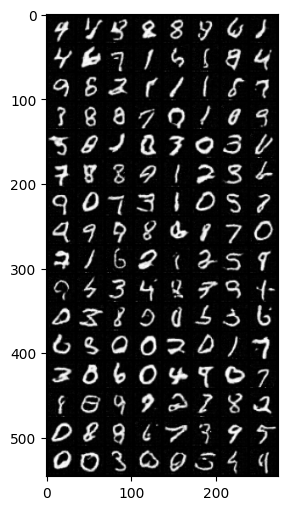

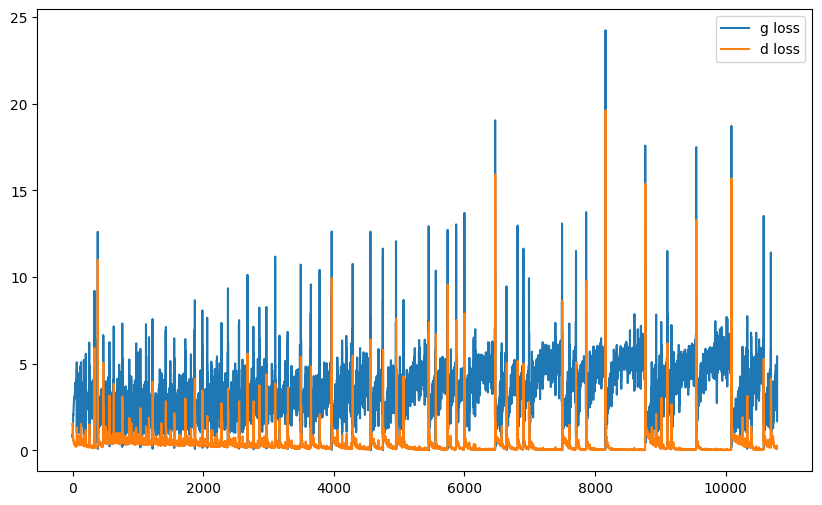

it: 10987; g_loss: 4.392304420471191; d_loss: 0.043418802320957184; avg_real_score: 0.9903838634490967; avg_fake_score: 0.027043143287301064: : 200it [00:24,  7.90it/s]

generated images


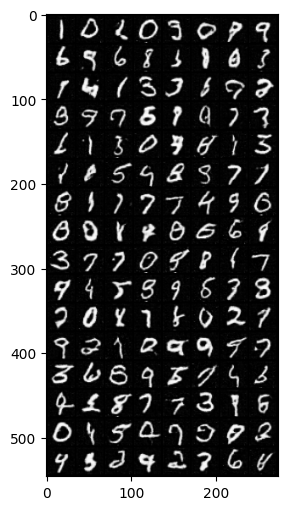

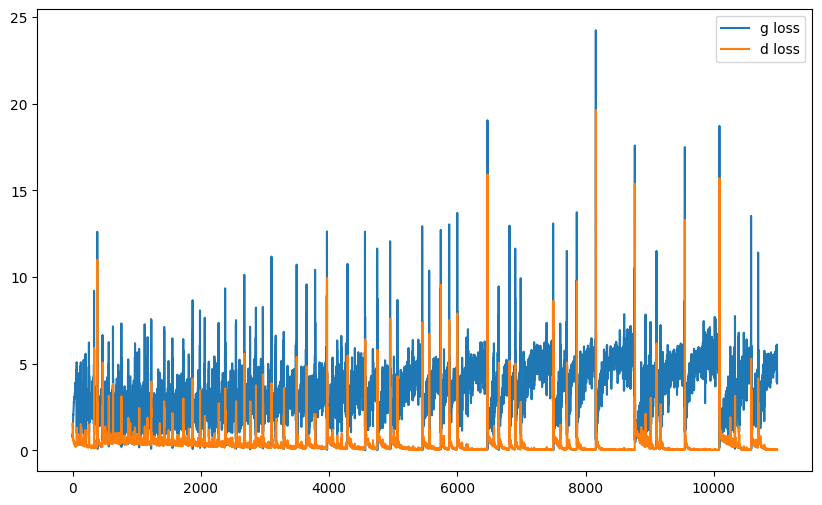

it: 11187; g_loss: 2.0967445373535156; d_loss: 0.3008955717086792; avg_real_score: 0.8455848693847656; avg_fake_score: 0.18677395582199097: : 400it [00:49,  8.45it/s]

generated images


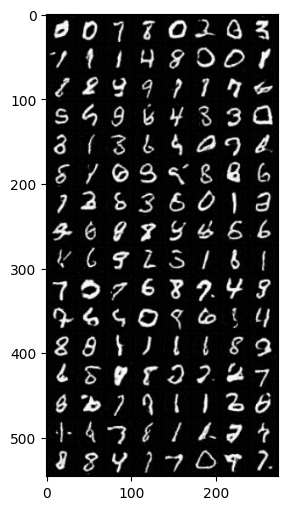

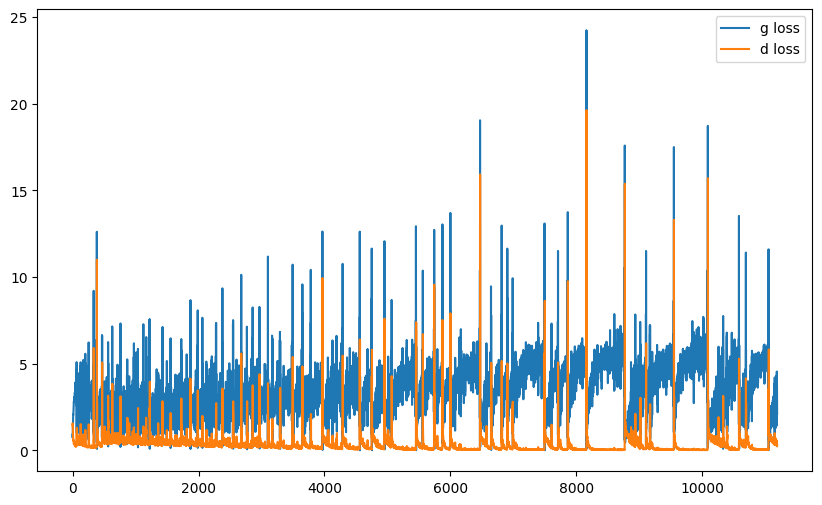

it: 11255; g_loss: 2.5001723766326904; d_loss: 0.1959700882434845; avg_real_score: 0.8857561945915222; avg_fake_score: 0.12382245063781738: : 469it [00:59,  7.94it/s]
it: 11256; g_loss: 4.807126045227051; d_loss: 0.2949599325656891; avg_real_score: 0.9720796346664429; avg_fake_score: 0.014378506690263748: : 0it [00:00, ?it/s]

generated images


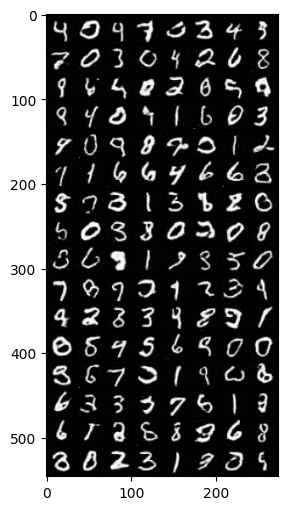

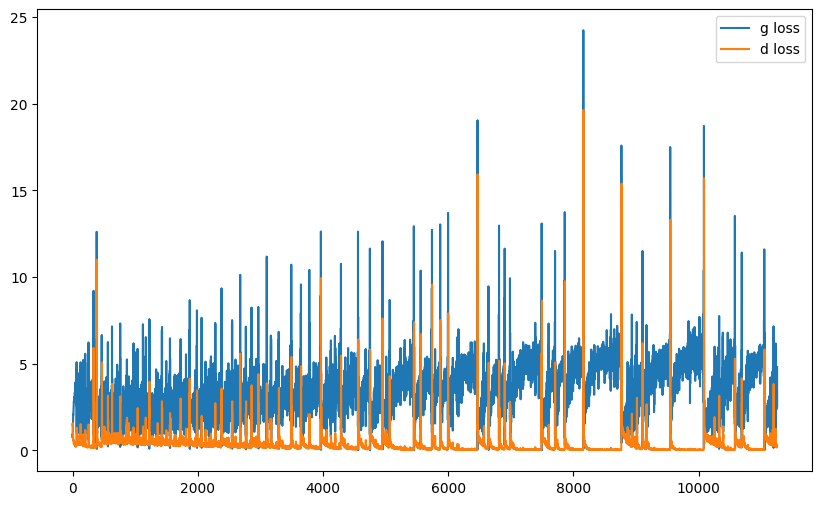

it: 11456; g_loss: 4.526295185089111; d_loss: 0.09354979544878006; avg_real_score: 0.9833419322967529; avg_fake_score: 0.02118685655295849: : 200it [00:24,  8.18it/s] 

generated images


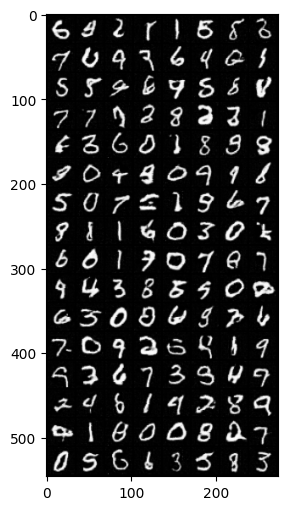

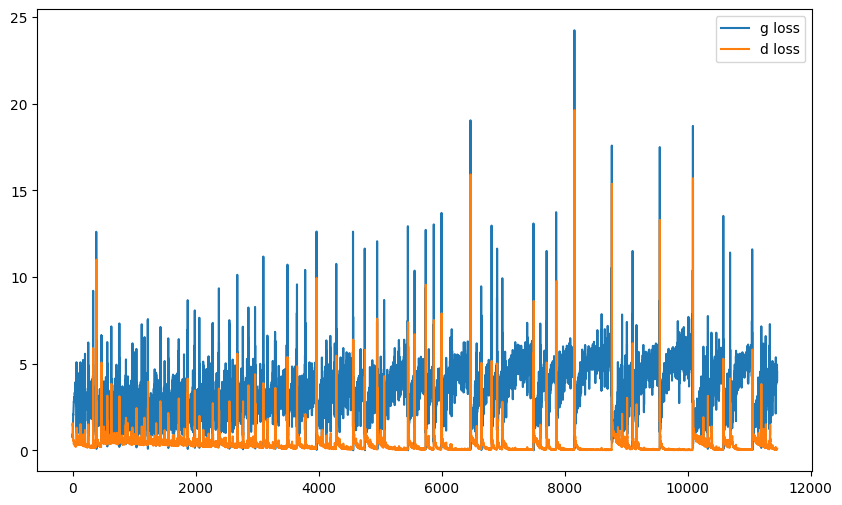

it: 11656; g_loss: 4.7433061599731445; d_loss: 0.027611035853624344; avg_real_score: 0.9900938272476196; avg_fake_score: 0.017325472086668015: : 400it [00:48,  7.36it/s]

generated images


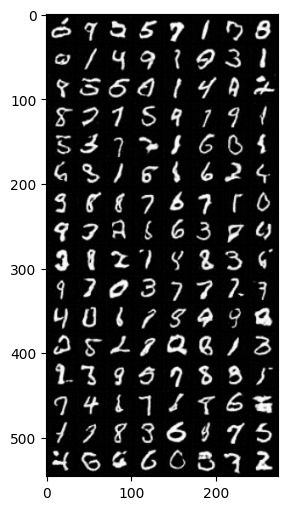

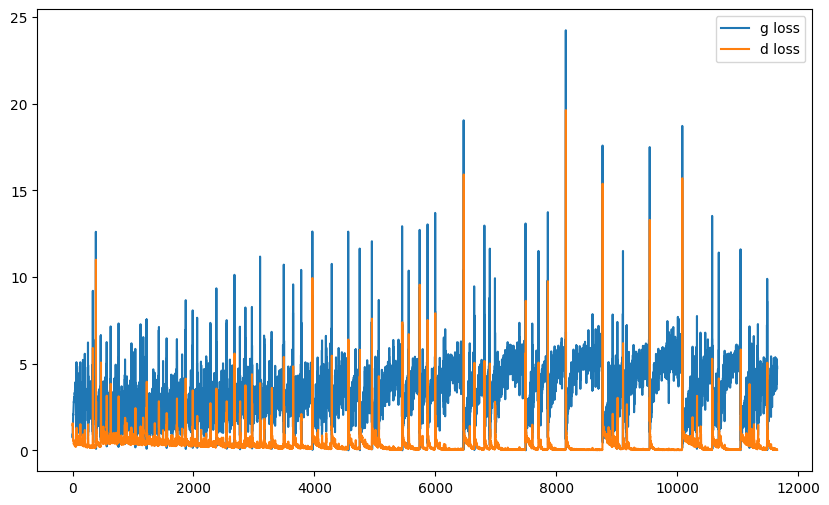

it: 11724; g_loss: 2.8161864280700684; d_loss: 0.26165327429771423; avg_real_score: 0.8812729120254517; avg_fake_score: 0.09454929083585739: : 469it [00:57,  8.13it/s]
it: 11725; g_loss: 2.9064908027648926; d_loss: 0.16381490230560303; avg_real_score: 0.9086558222770691; avg_fake_score: 0.08090472966432571: : 0it [00:00, ?it/s]

generated images


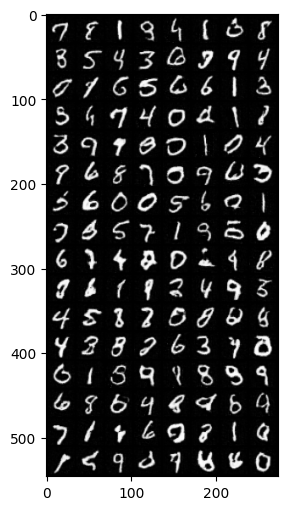

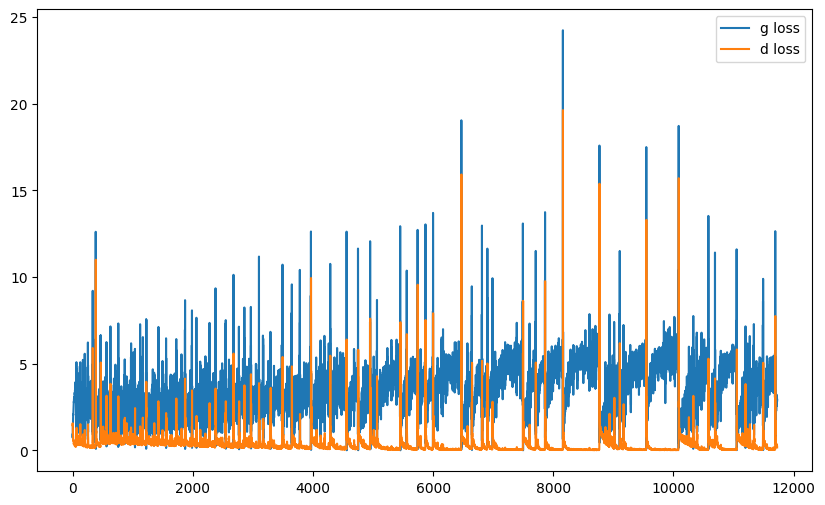

it: 11925; g_loss: 5.683396339416504; d_loss: 0.028005853295326233; avg_real_score: 0.9848150014877319; avg_fake_score: 0.00861293077468872: : 200it [00:24,  8.84it/s]

generated images


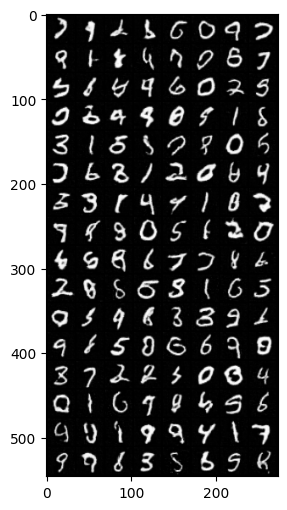

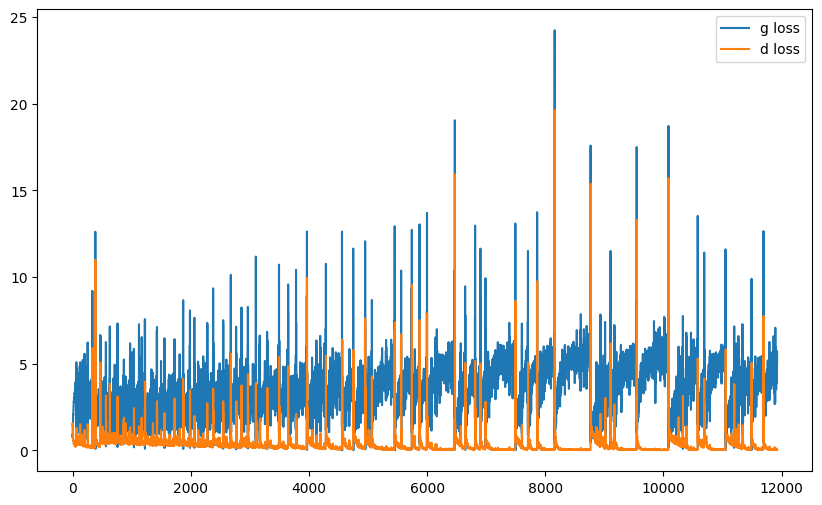

it: 12125; g_loss: 5.2427849769592285; d_loss: 0.01850689947605133; avg_real_score: 0.9902232885360718; avg_fake_score: 0.010438798926770687: : 400it [00:48,  6.63it/s]

generated images


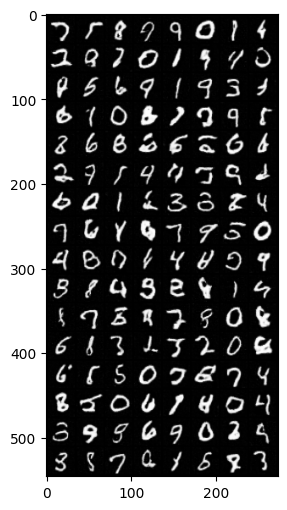

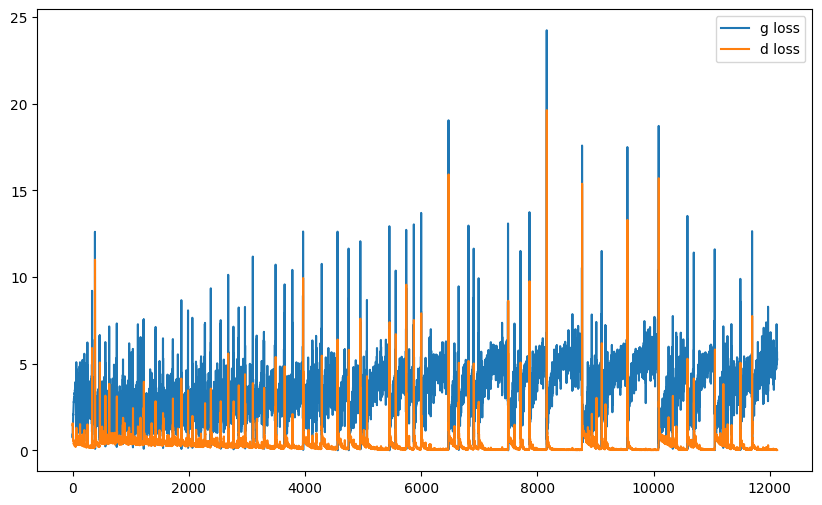

it: 12193; g_loss: 3.42758846282959; d_loss: 0.130814328789711; avg_real_score: 0.8884252309799194; avg_fake_score: 0.059218864887952805: : 469it [00:56,  8.24it/s]
it: 12194; g_loss: 5.443202018737793; d_loss: 0.09783805906772614; avg_real_score: 0.9935650825500488; avg_fake_score: 0.009136069566011429: : 0it [00:00, ?it/s]

generated images


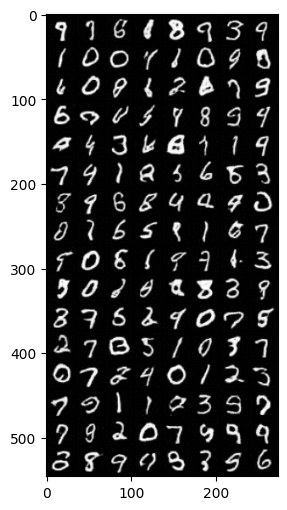

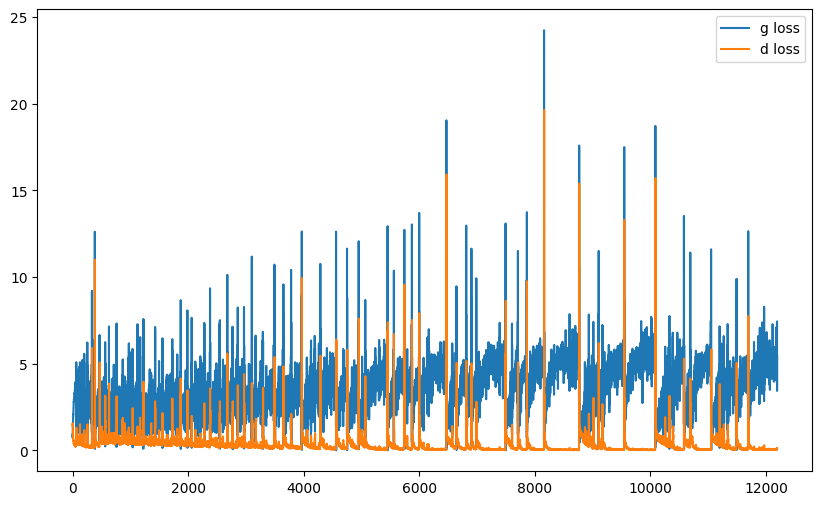

it: 12394; g_loss: 3.0290894508361816; d_loss: 0.14608266949653625; avg_real_score: 0.9247314929962158; avg_fake_score: 0.07846468687057495: : 200it [00:24,  9.23it/s]

generated images


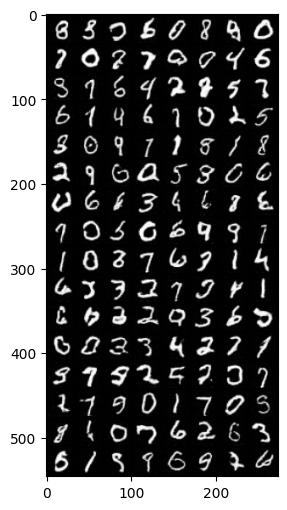

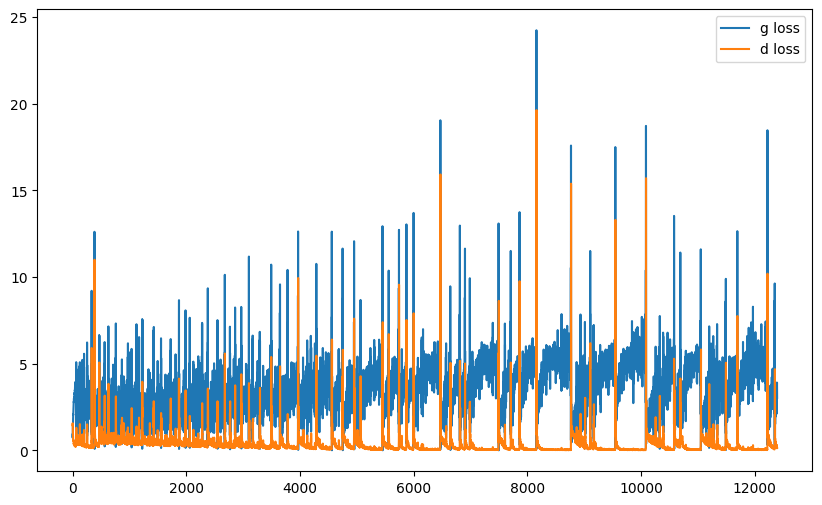

it: 12594; g_loss: 3.031526803970337; d_loss: 0.23509535193443298; avg_real_score: 0.9172219038009644; avg_fake_score: 0.08464549481868744: : 400it [00:49,  7.21it/s]

generated images


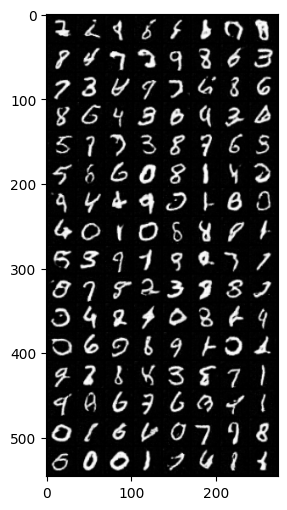

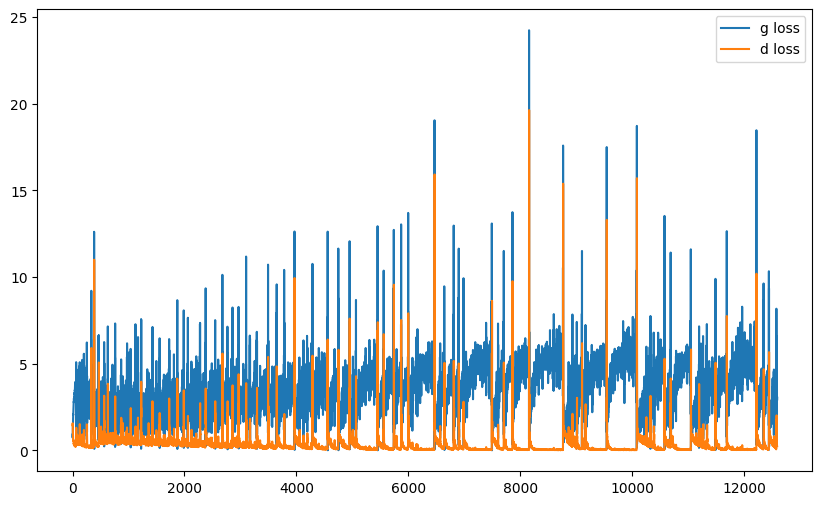

it: 12662; g_loss: 4.645541191101074; d_loss: 0.04896242171525955; avg_real_score: 0.9630494117736816; avg_fake_score: 0.01644708216190338: : 469it [00:58,  8.05it/s]
it: 12663; g_loss: 4.714792251586914; d_loss: 0.034102439880371094; avg_real_score: 0.9767282605171204; avg_fake_score: 0.01790984906256199: : 0it [00:00, ?it/s]

generated images


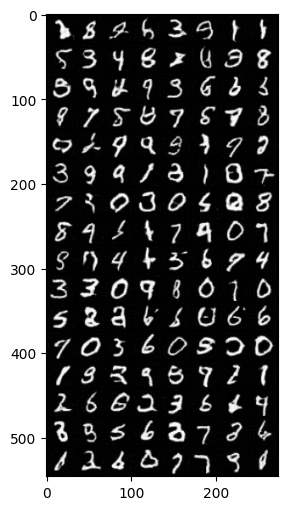

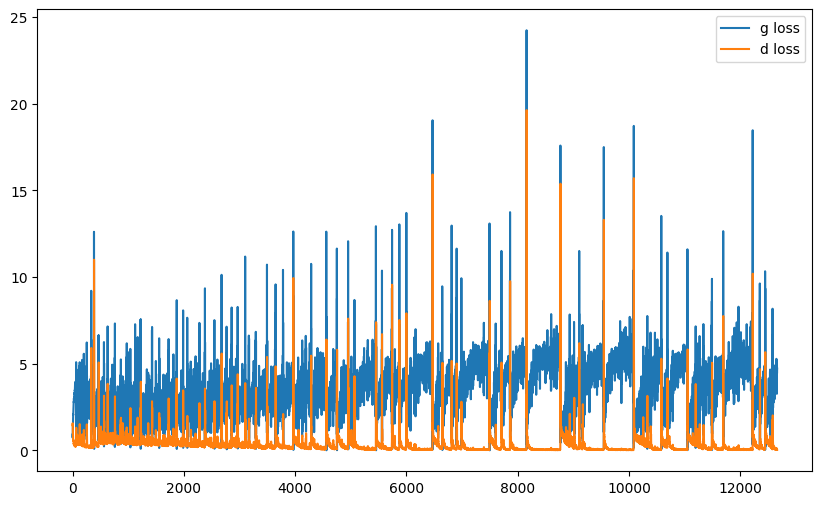

it: 12863; g_loss: 5.92205810546875; d_loss: 0.020473679527640343; avg_real_score: 0.9862616658210754; avg_fake_score: 0.005728823132812977: : 200it [00:24,  9.01it/s]

generated images


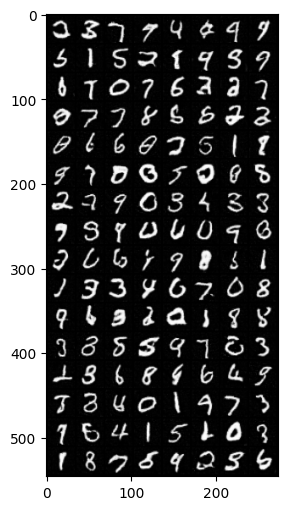

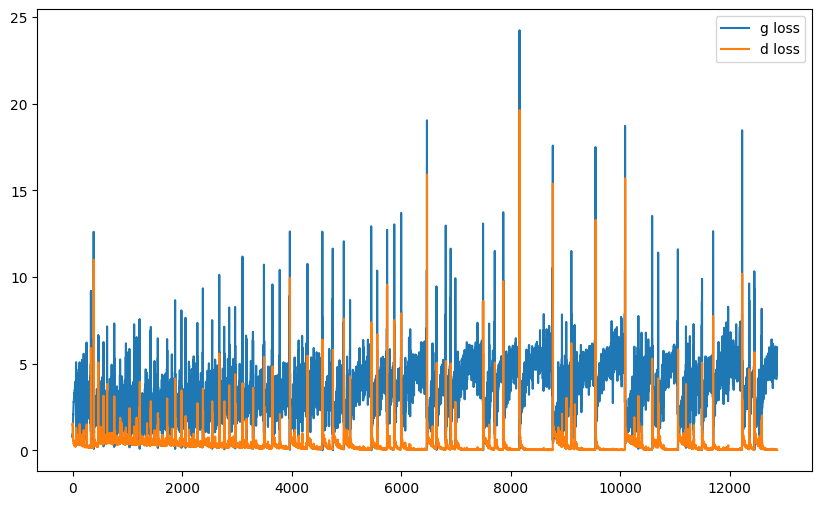

it: 13063; g_loss: 2.454313039779663; d_loss: 0.37806570529937744; avg_real_score: 0.8551709651947021; avg_fake_score: 0.12529505789279938: : 400it [00:48,  8.84it/s]

generated images


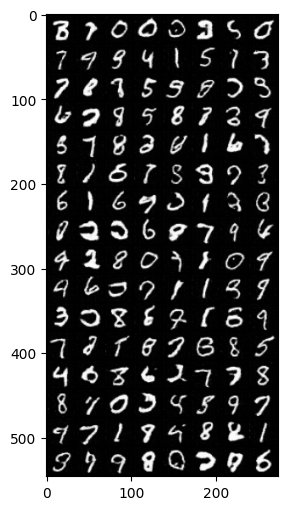

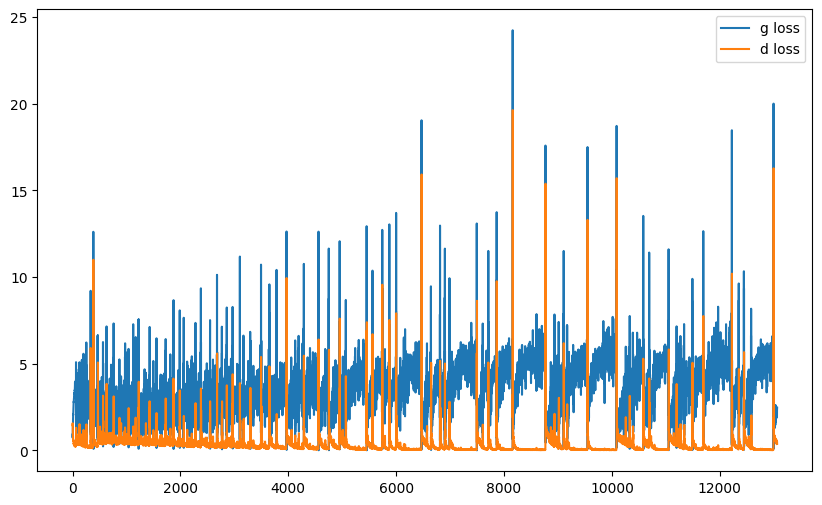

it: 13131; g_loss: 2.398357391357422; d_loss: 0.2893461585044861; avg_real_score: 0.834004282951355; avg_fake_score: 0.13119500875473022: : 469it [00:57,  8.18it/s]
it: 13132; g_loss: 3.0770466327667236; d_loss: 0.3159320652484894; avg_real_score: 0.9120944738388062; avg_fake_score: 0.07968397438526154: : 0it [00:00, ?it/s]

generated images


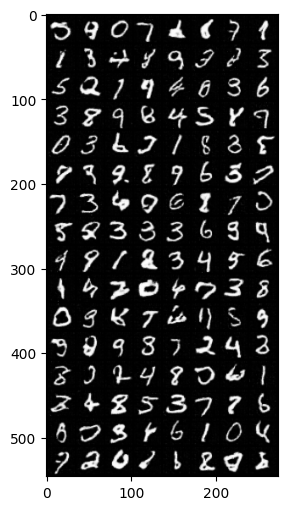

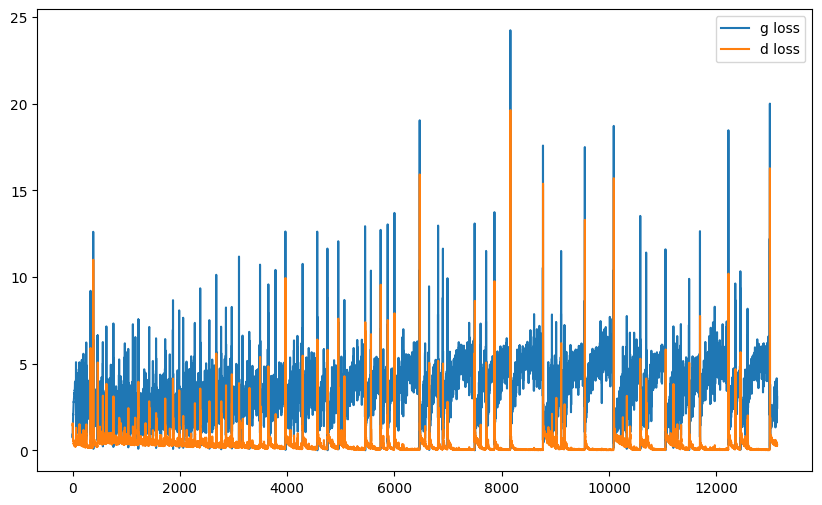

it: 13332; g_loss: 4.863556385040283; d_loss: 0.0538531057536602; avg_real_score: 0.9601918458938599; avg_fake_score: 0.014578263275325298: : 200it [00:24,  8.55it/s] 

generated images


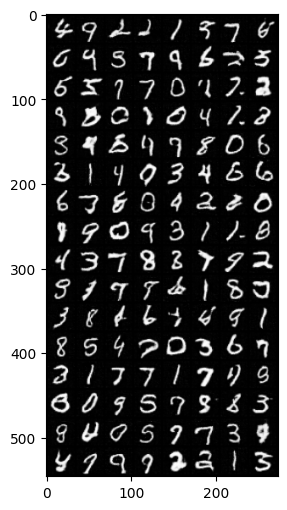

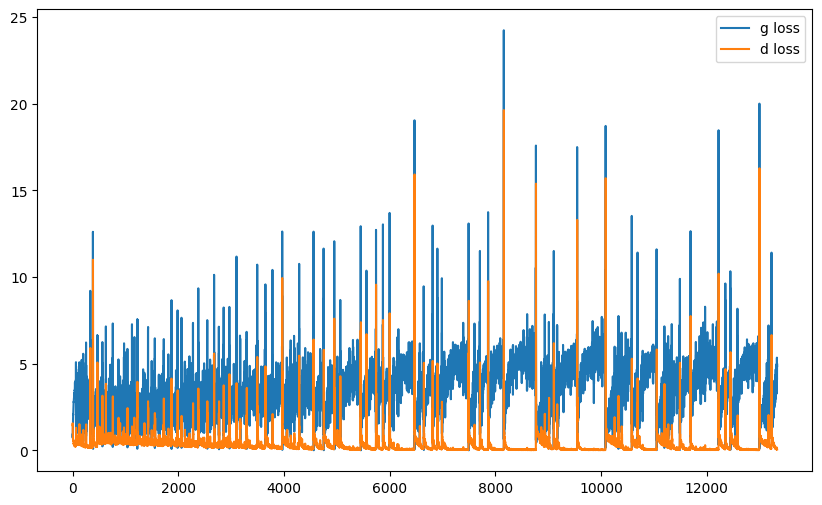

it: 13532; g_loss: 6.0389084815979; d_loss: 0.023487642407417297; avg_real_score: 0.9973945617675781; avg_fake_score: 0.006999599281698465: : 400it [00:49,  8.95it/s]  

generated images


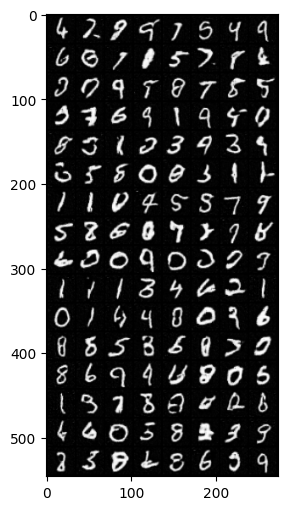

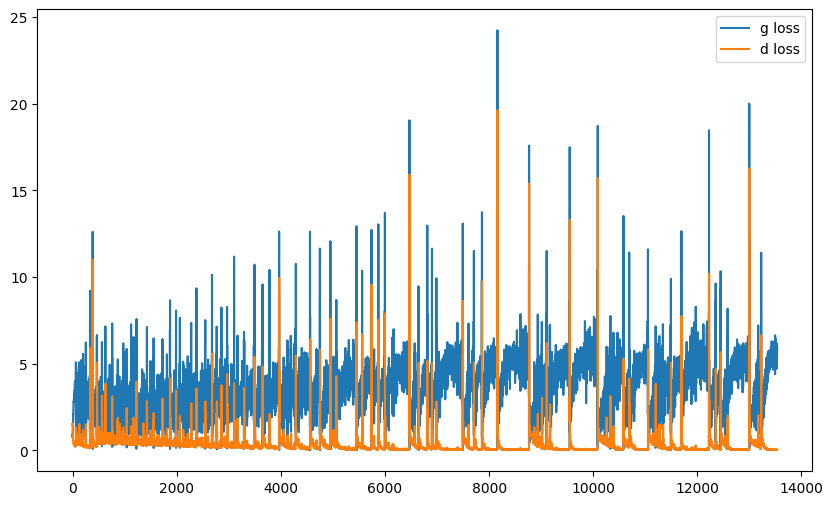

it: 13600; g_loss: 6.7189249992370605; d_loss: 0.023363880813121796; avg_real_score: 0.9786667227745056; avg_fake_score: 0.0023875932674854994: : 469it [00:58,  7.97it/s]
it: 13601; g_loss: 5.091055393218994; d_loss: 0.021919740363955498; avg_real_score: 0.9861339330673218; avg_fake_score: 0.013163705356419086: : 0it [00:00, ?it/s]

generated images


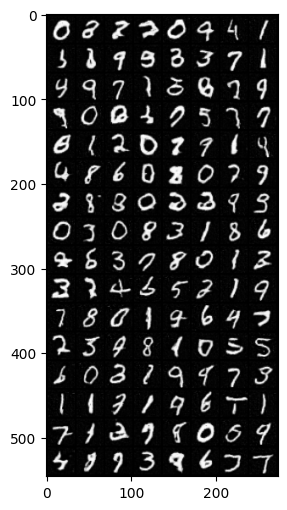

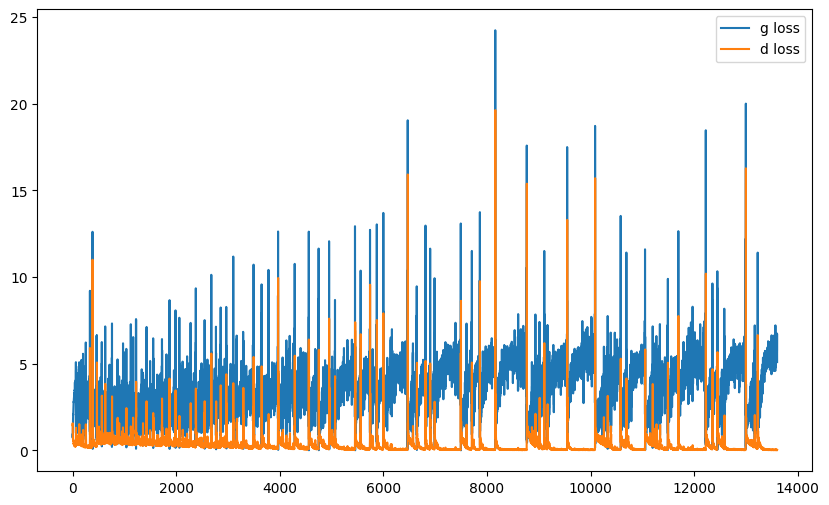

it: 13801; g_loss: 5.793028831481934; d_loss: 0.01297376025468111; avg_real_score: 0.9950229525566101; avg_fake_score: 0.006678013131022453: : 200it [00:24,  8.69it/s]

generated images


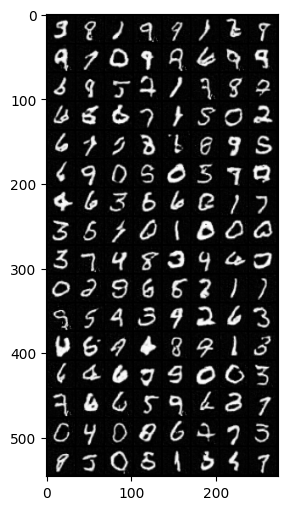

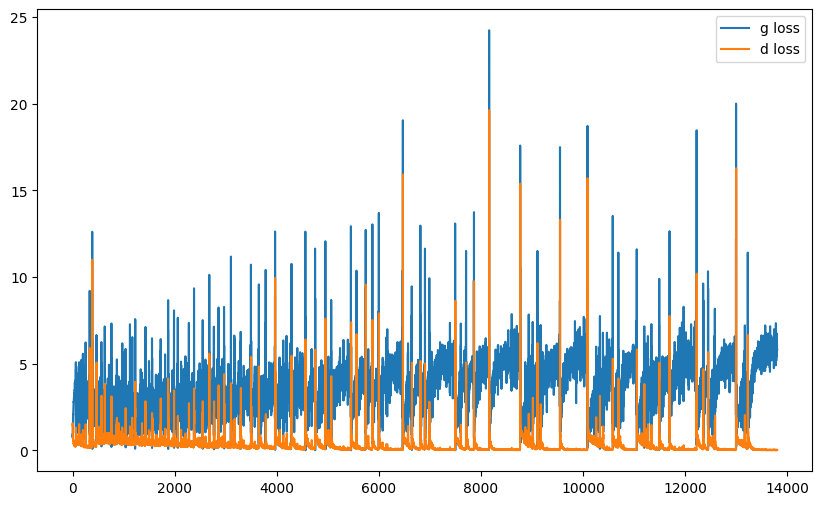

it: 14001; g_loss: 6.104578971862793; d_loss: 0.018437780439853668; avg_real_score: 0.9842865467071533; avg_fake_score: 0.005563355982303619: : 400it [00:49,  9.20it/s]

generated images


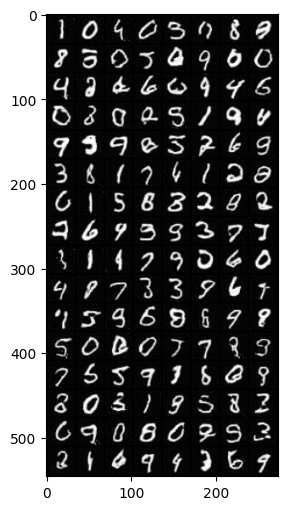

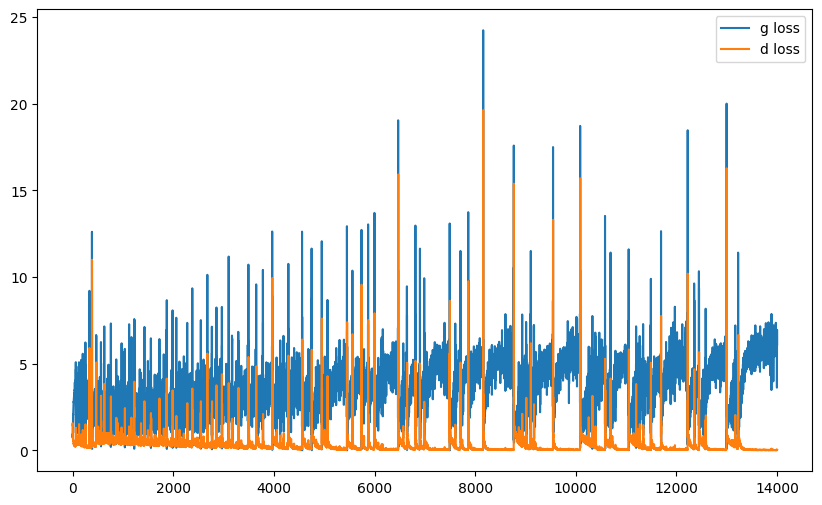

it: 14069; g_loss: 5.862322807312012; d_loss: 0.01463608630001545; avg_real_score: 0.9909049272537231; avg_fake_score: 0.00561649352312088: : 469it [00:58,  8.05it/s]


In [47]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

torch.autograd.set_detect_anomaly(True)

nb_epochs = 30

g_losses = []
d_losses = []


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]

        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im)




        ###
        ### Discriminator
        ###

        d_loss = criterion(yhat_real, get_labels_one(cur_batch_size)) + criterion(yhat_fake, get_labels_zero(cur_batch_size))
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()


        ###
        ### Generator
        ###

        yhat_fake = netD(fake_im)

        g_loss = criterion(yhat_fake, get_labels_one(cur_batch_size))
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            #fake_im = G(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

In this case the generated images are more distinct and refined. Most digits are clearly identifiable, with improved sharpness and fewer malformed examples. Moreover there is greater diversity in the digits produced with representations of all numbers from 0 to 9 being clearly visible.

The generator loss shows here a consistent upward trend interspersed with spikes, indicative of a well-progressing adversarial game. The discriminator loss remains relatively low but fluctuates more frequently as the generator improves, forcing the discriminator to adapt dynamically.

The adversarial training stabilizes too as the generator becomes more capable of producing realistic outputs, evidenced by the relatively smoother cruves and better image quality. While periodic spikes in losses persist (a common characteristic of GANs), the oveall adversarial dynamic appears more balanced.

Hence the longer training time allows the generator and discriminator to better learn and adapt to the data distribution and adversarial dynamics. The generator particu

# 4. Conditional GANs [BONUS]

A simple way to improve training performance and obtain control of the generation is to provide extra information into the Generator and the Discriminator, known as **Conditional GANs**. In this case, we will provide the class label (digit number of MNIST) into both the generator and the discriminator. This will help both of the networks.

## 4.1 Conditional Generator and Discriminator

Complete the ConditionalDiscriminator and ConditionalGenerator classes using your GAN building blocks (`get_upsampling_block` and `get_downsampling_block` functions).


### 4.1.1 Generator

In [72]:
# GENERATOR

'''
The conditional generator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the generator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalGenerator(nn.Module):
    def __init__(self, nz, nc, ngf, nchannels=1):
        super().__init__()

        self.upscaling_z = get_upscaling_block(nz, ngf*8, 4, 1, 0)
        self.upscaling_c = get_upscaling_block(nc, ngf*8, 4, 1, 0)

        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        self.rest_model = nn.Sequential(get_upscaling_block(ngf*16, ngf*8, 4, 2, 1),
                                        get_upscaling_block(ngf*8, ngf*4, 4, 2, 1),
                                        get_upscaling_block(ngf*4, 1, 4, 2, 1, last_layer=True))

        ###################

    def forward(self, x, y):
        x = x.unsqueeze(2).unsqueeze(2)
        y = y.unsqueeze(2).unsqueeze(2)

        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################

        z = self.upscaling_z(x)         #upscale both terms
        y = self.upscaling_c(y)

        #concate the two branches

        x = torch.cat((z, y), dim=1)

        return self.rest_model(x)

### 4.1.2 Discriminator

In [49]:
# Discriminator

'''
The conditional discriminator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the discriminator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalDiscriminator(nn.Module):
    def __init__(self, ndf, nc, nchannels=1):
        super().__init__()
        self.downscale_x = get_downscaling_block(nchannels, ndf*2, 4, 2, 1, use_batch_norm=False)
        self.downscale_y = get_downscaling_block(nc, ndf*2, 4, 2, 1, use_batch_norm=False)

        ###################
        #                 #
        # YOUR CODE HERE  #

        self.rest = nn.Sequential(get_downscaling_block(ndf*4, ndf*8, 4, 2, 1),
                                  get_downscaling_block(ndf*8, ndf*16, 4, 2, 1),
                                  get_downscaling_block(ndf*16, 1, 4, 1, 0, is_last=True))

        #                 #
        ###################

    def forward(self, x, y):
        x = self.downscale_x(x)

        # Exp of y
        y = y.unsqueeze(2).unsqueeze(3).expand(-1, -1, 32, 32)

        # downscale of y
        y = self.downscale_y(y)

        x = torch.cat((x,y), dim=1)

        return self.rest(x).squeeze(1).squeeze(1) # remove spatial dimensions

### 4.1.3 Sanity Checks

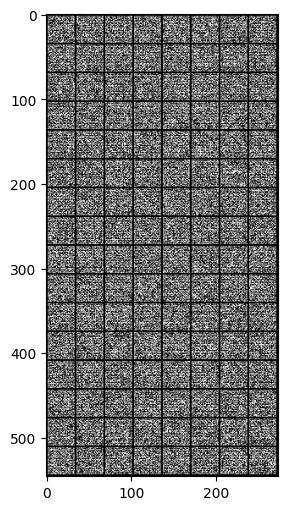

In [73]:
# CONDITIONAL GENERATOR SANITY CHECKING

z = torch.randn(batch_size, nz)
y = F.one_hot(real_labels).float()

cG = ConditionalGenerator(nz=nz, ngf=16, nc=10)
x_fake = cG(z, y)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

In [74]:
# Conditional Discriminator Sanity Checking

cD = ConditionalDiscriminator(ndf=32, nc=10, nchannels=1)
assert cD(real_batch, F.one_hot(real_labels).float()).shape == (real_batch.shape[0], 1)

## 4.2 Training

In [75]:
nz = 100
ndf = 32
ngf = 32
nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

netD = ConditionalDiscriminator(ndf, nc, nchannels=1).to(device)
netG = ConditionalGenerator(nz, nc, ngf).to(device)

netG.apply(weights_init)
netD.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

it: 0; g_loss: 0.19837255775928497; d_loss: 1.745569109916687; avg_real_score: 0.30527204275131226; avg_fake_score: 0.25114279985427856: : 0it [00:00, ?it/s]

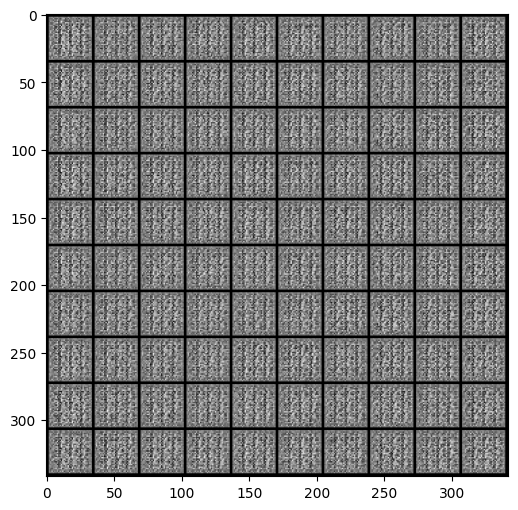

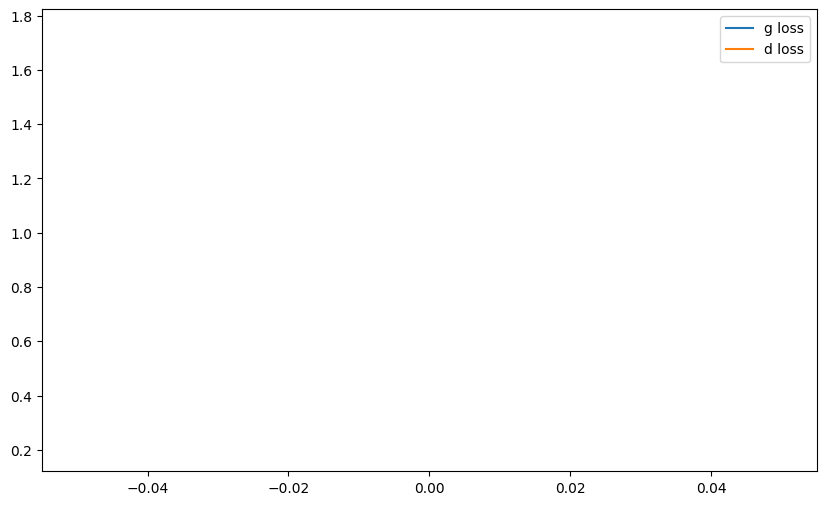

it: 200; g_loss: 2.7497971057891846; d_loss: 0.6162409782409668; avg_real_score: 0.7885501980781555; avg_fake_score: 0.26399722695350647: : 200it [00:39,  5.27it/s]

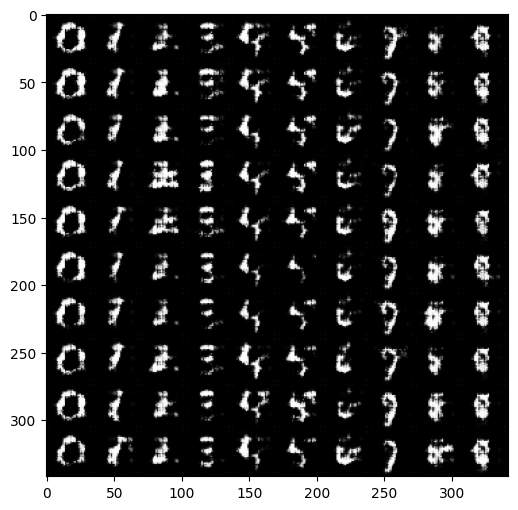

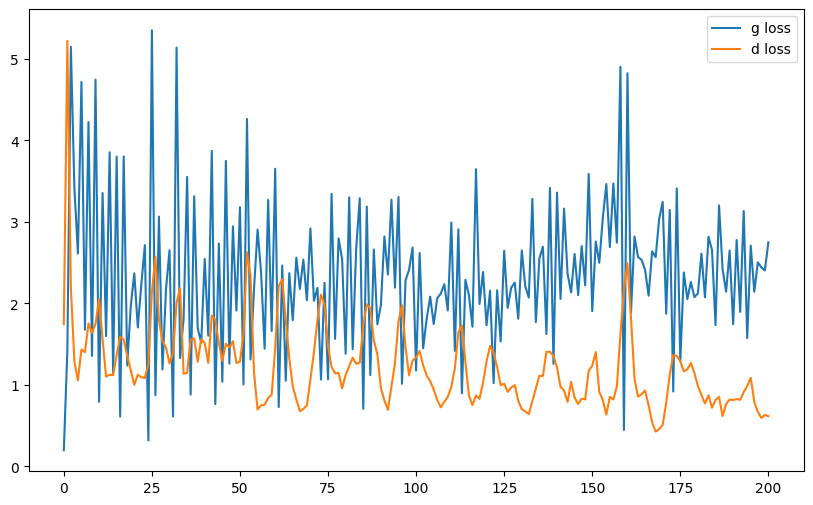

it: 400; g_loss: 2.00238037109375; d_loss: 0.9509323835372925; avg_real_score: 0.6889702081680298; avg_fake_score: 0.35363179445266724: : 400it [01:19,  5.03it/s]

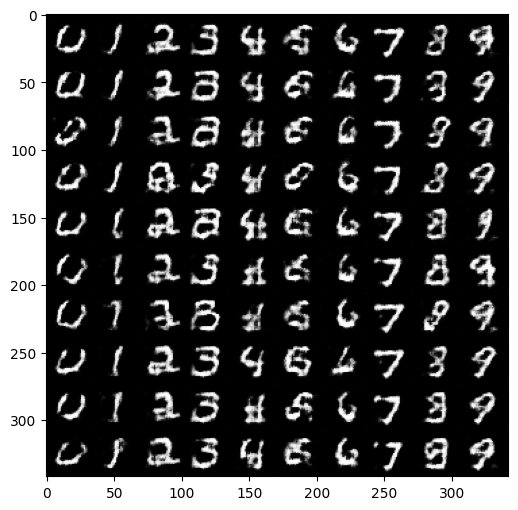

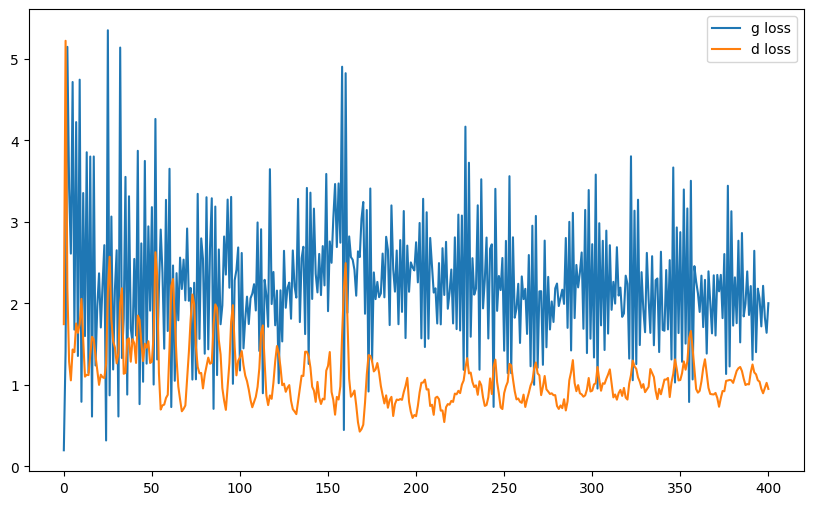

it: 468; g_loss: 1.4480317831039429; d_loss: 1.0327938795089722; avg_real_score: 0.6024409532546997; avg_fake_score: 0.2856936454772949: : 469it [01:34,  4.98it/s]
it: 469; g_loss: 2.2703635692596436; d_loss: 0.9609754681587219; avg_real_score: 0.7397710084915161; avg_fake_score: 0.4139622449874878: : 0it [00:00, ?it/s]

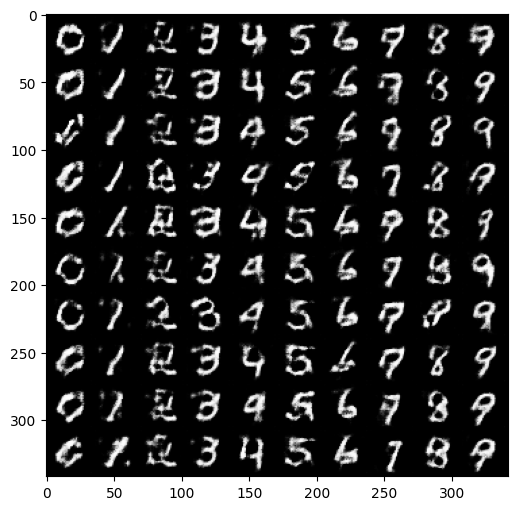

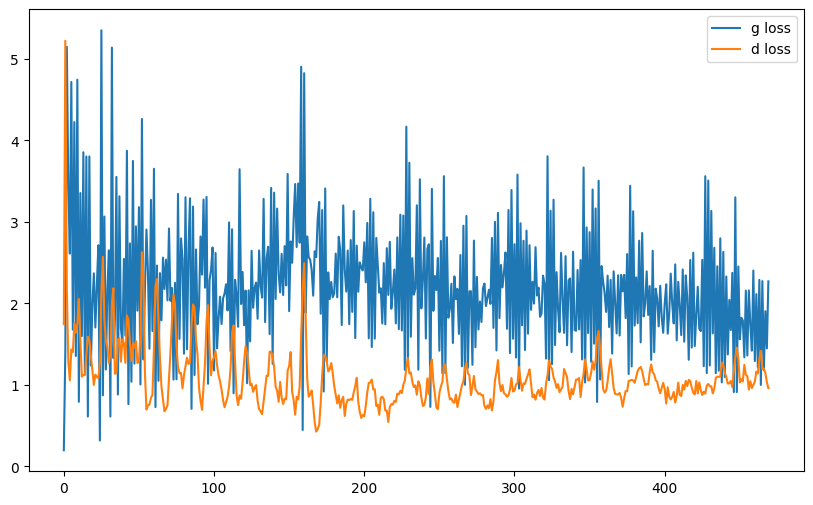

it: 669; g_loss: 1.5886428356170654; d_loss: 1.2201086282730103; avg_real_score: 0.6933884024620056; avg_fake_score: 0.5125576257705688: : 200it [00:41,  4.45it/s] 

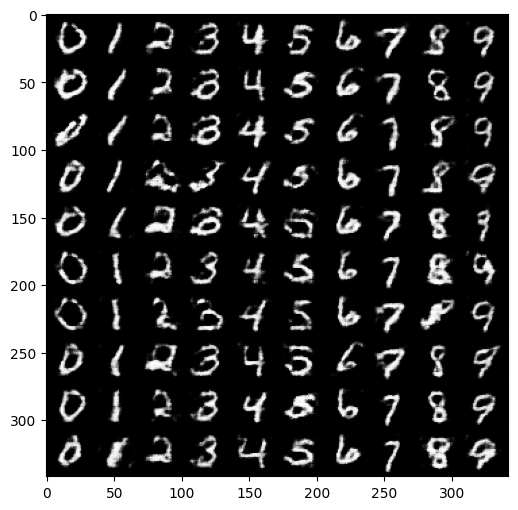

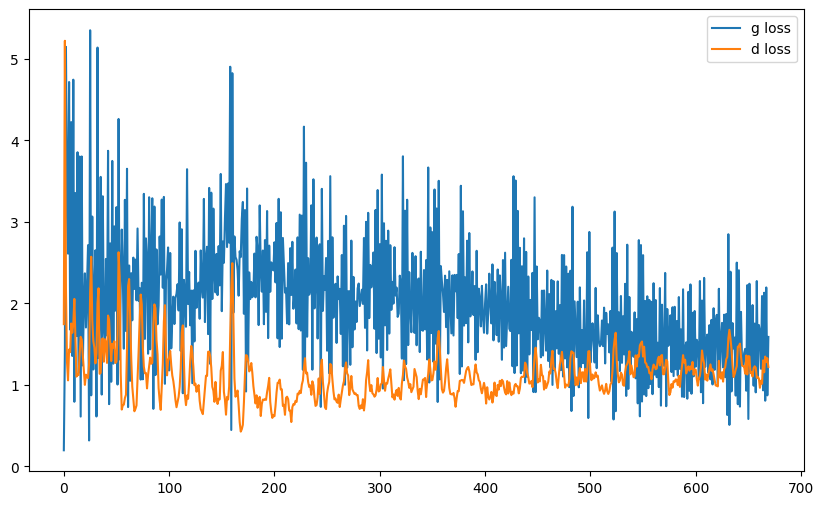

it: 869; g_loss: 1.2350120544433594; d_loss: 1.0861666202545166; avg_real_score: 0.6076387763023376; avg_fake_score: 0.3838757276535034: : 400it [01:23,  5.01it/s]

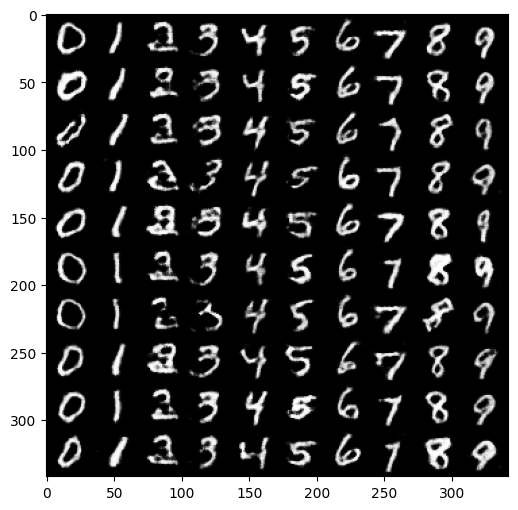

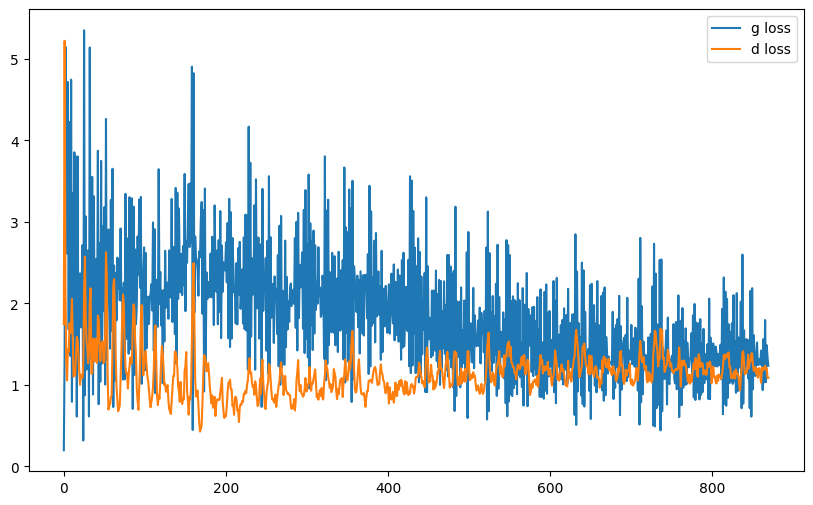

it: 937; g_loss: 1.93778395652771; d_loss: 1.225996494293213; avg_real_score: 0.7434269785881042; avg_fake_score: 0.5673681497573853: : 469it [01:37,  4.81it/s]
it: 938; g_loss: 0.7575184106826782; d_loss: 1.2591981887817383; avg_real_score: 0.4363710880279541; avg_fake_score: 0.2334074079990387: : 0it [00:00, ?it/s]

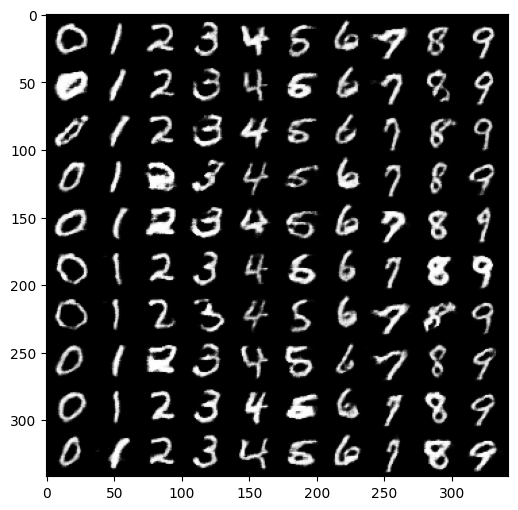

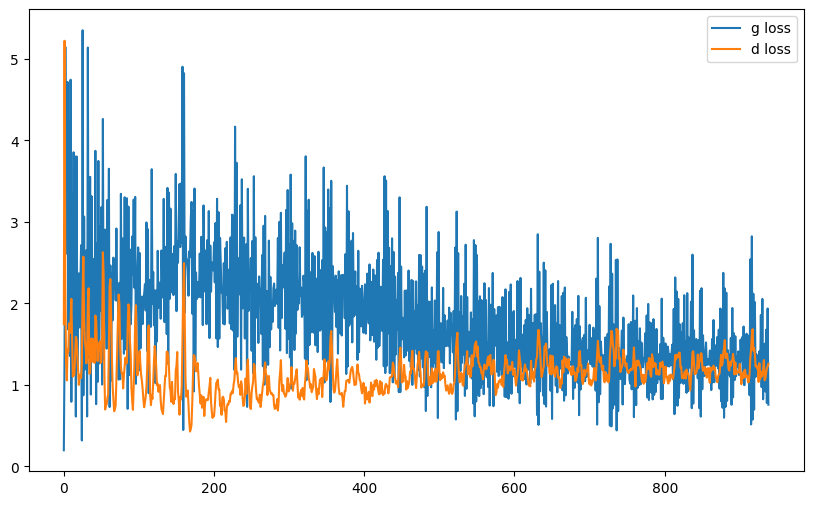

it: 1138; g_loss: 1.4762333631515503; d_loss: 1.2582638263702393; avg_real_score: 0.704656720161438; avg_fake_score: 0.5544090270996094: : 200it [00:41,  4.95it/s]

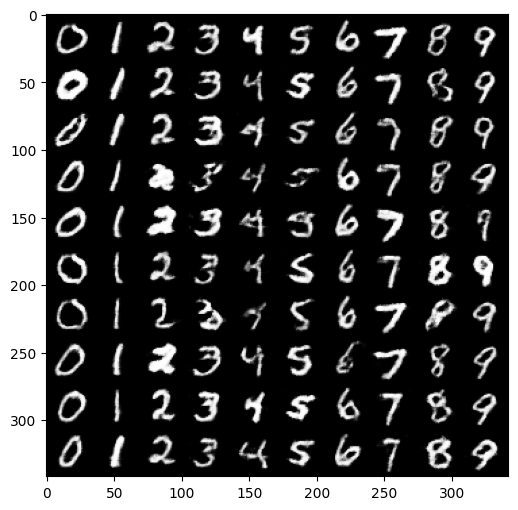

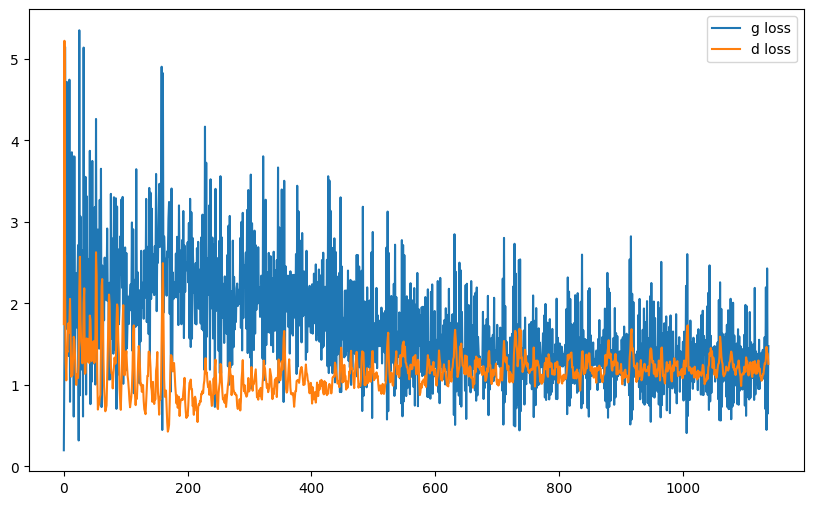

it: 1338; g_loss: 1.6519163846969604; d_loss: 1.241555094718933; avg_real_score: 0.6956770420074463; avg_fake_score: 0.5483393669128418: : 400it [01:23,  4.95it/s]  

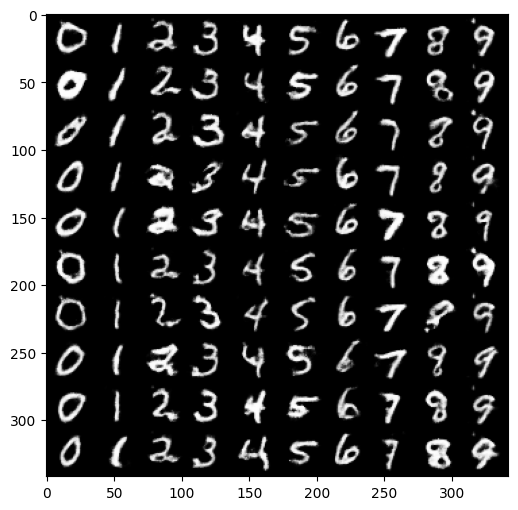

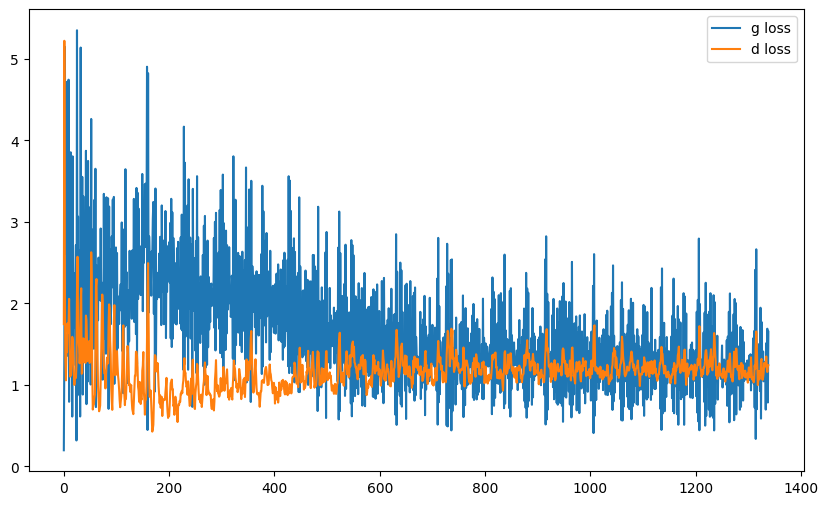

it: 1406; g_loss: 0.9181129932403564; d_loss: 1.2151597738265991; avg_real_score: 0.5398028492927551; avg_fake_score: 0.38677510619163513: : 469it [01:38,  4.78it/s]
it: 1407; g_loss: 1.6420023441314697; d_loss: 1.1404916048049927; avg_real_score: 0.6815919876098633; avg_fake_score: 0.490712970495224: : 0it [00:00, ?it/s]

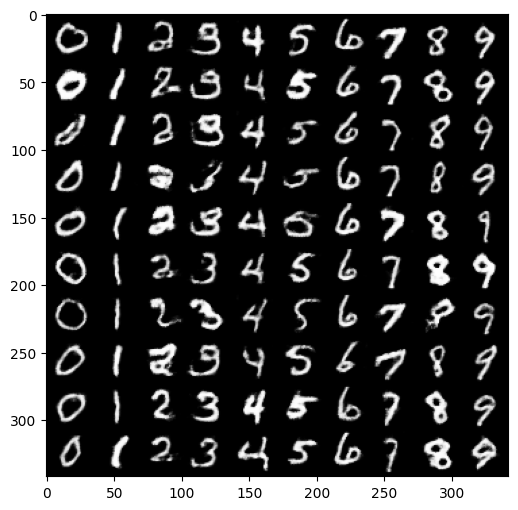

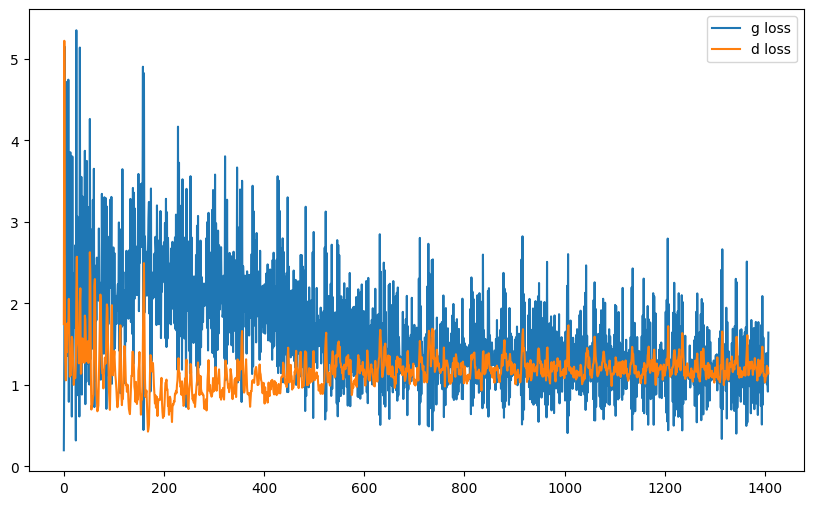

it: 1607; g_loss: 1.3103079795837402; d_loss: 1.0254548788070679; avg_real_score: 0.6325279474258423; avg_fake_score: 0.3957262635231018: : 200it [00:42,  4.56it/s]

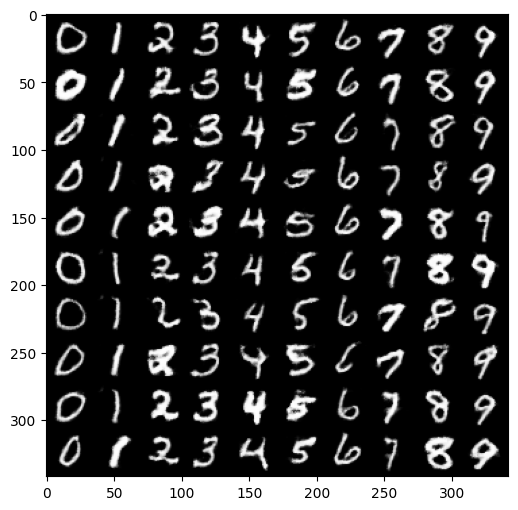

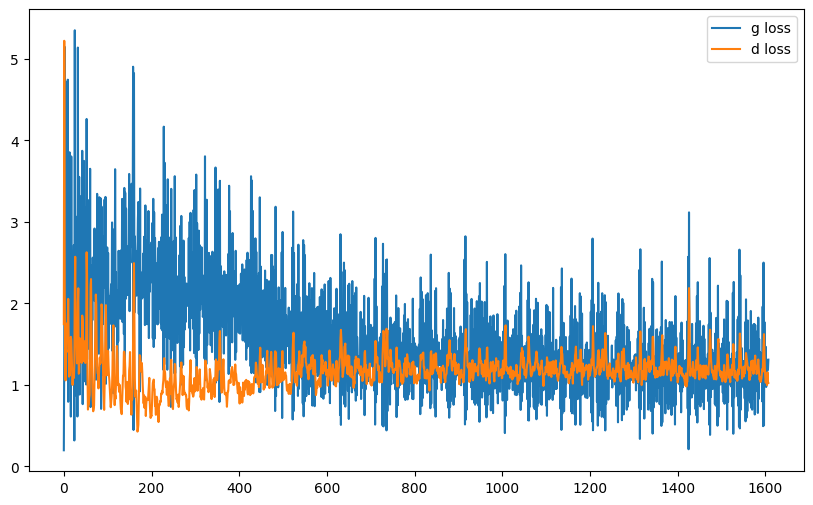

it: 1807; g_loss: 2.041195869445801; d_loss: 1.1648255586624146; avg_real_score: 0.6945704221725464; avg_fake_score: 0.5157300233840942: : 400it [01:25,  4.57it/s] 

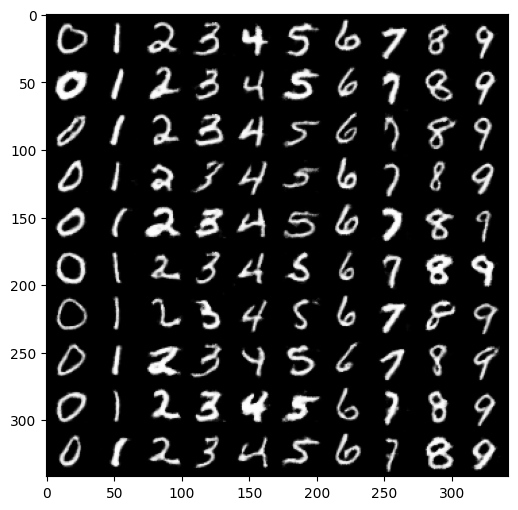

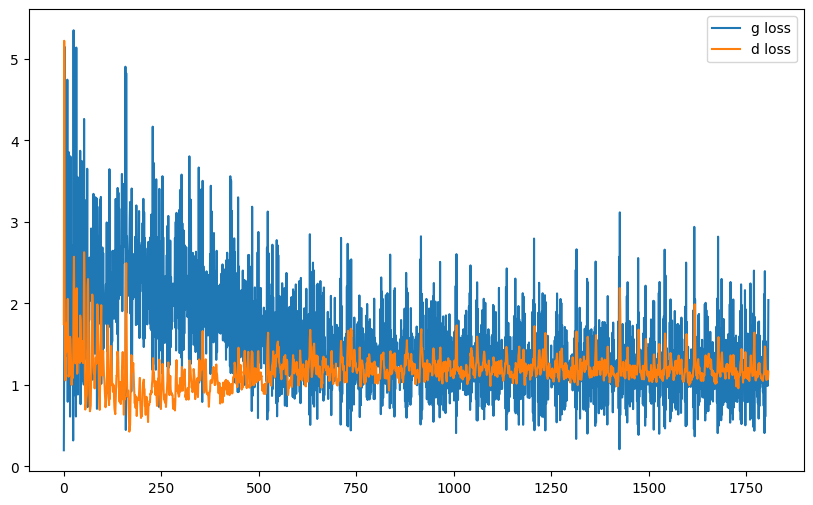

it: 1875; g_loss: 3.306135892868042; d_loss: 1.4355149269104004; avg_real_score: 0.8973590731620789; avg_fake_score: 0.7049829363822937: : 469it [01:39,  4.69it/s]
it: 1876; g_loss: 0.4564386308193207; d_loss: 1.7654368877410889; avg_real_score: 0.22930598258972168; avg_fake_score: 0.08881421387195587: : 0it [00:00, ?it/s]

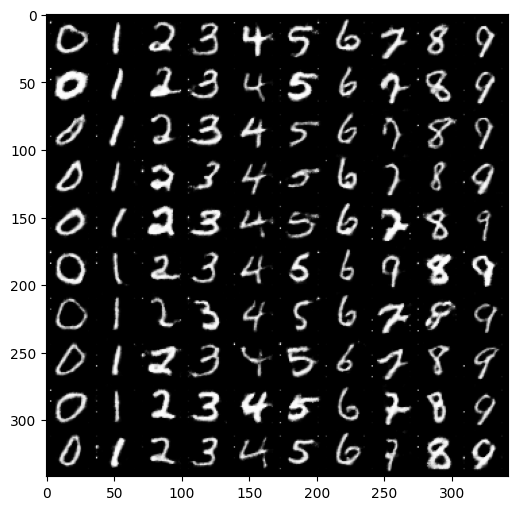

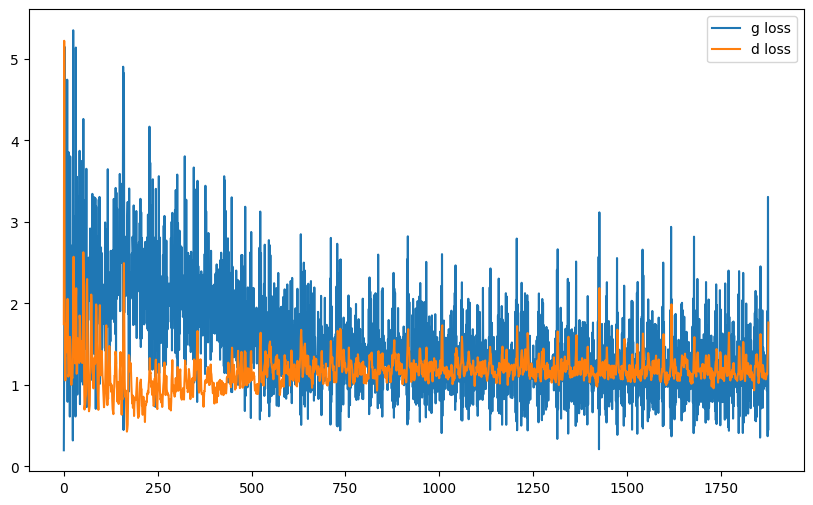

it: 2076; g_loss: 1.5786523818969727; d_loss: 1.0803844928741455; avg_real_score: 0.6755415201187134; avg_fake_score: 0.4596766233444214: : 200it [00:42,  4.93it/s] 

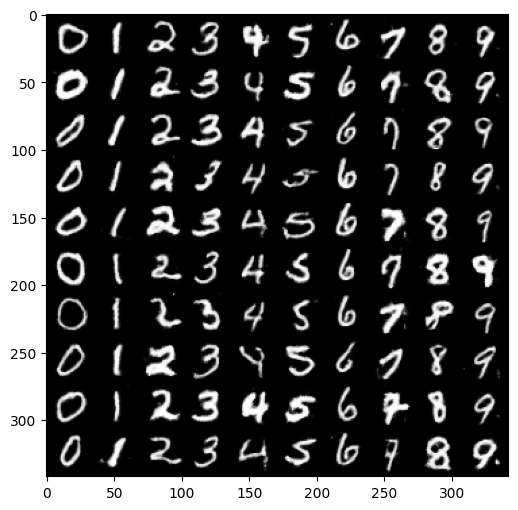

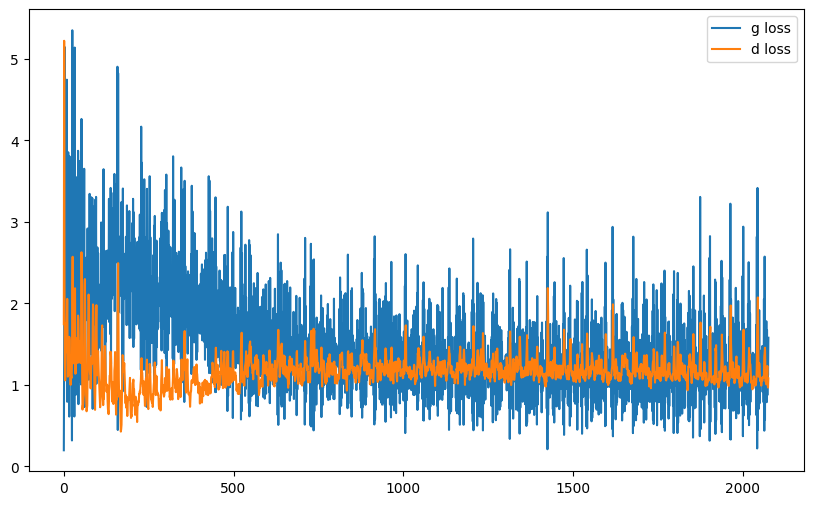

it: 2276; g_loss: 1.5499707460403442; d_loss: 0.9012265205383301; avg_real_score: 0.6674614548683167; avg_fake_score: 0.3549402952194214: : 400it [01:25,  4.95it/s]

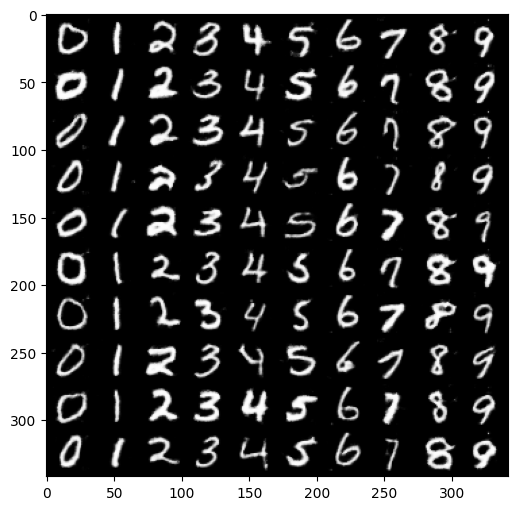

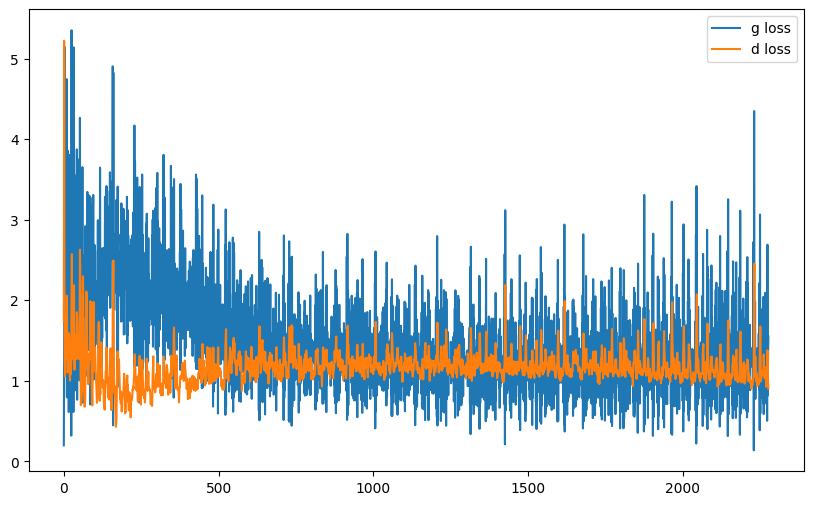

it: 2344; g_loss: 1.6521514654159546; d_loss: 1.0556578636169434; avg_real_score: 0.693741500377655; avg_fake_score: 0.46100521087646484: : 469it [01:40,  4.69it/s]


In [76]:
nb_epochs = 5

g_losses = []
d_losses = []

j = 0

z_test = sample_z(100, nz)  # we generate the noise only once for testing


for epoch in range(nb_epochs):

    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, labels = batch
        im = im.to(device)


        y = F.one_hot(labels).float().to(device)

        cur_batch_size = im.shape[0]


        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################

        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)



        # 2. Generate a fake image
        fake_im = netG(z, y)



        # 3. Classify real image with D
        yhat_real = netD(im,y)
        labels_real = get_labels_one(cur_batch_size)
        d_loss_real = criterion(yhat_real, labels_real)



        # 4. Classify fake image with D
        yhat_fake = netD(fake_im.detach(), y)  # detach() to avoid backpropagating through the generator
        labels_fake = get_labels_zero(cur_batch_size)
        d_loss_fake = criterion(yhat_fake, labels_fake)


        ###
        ### Discriminator
        ###

        d_loss = d_loss_real + d_loss_fake
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()


        ###
        ### Generator
        ###

        # Classify fake image
        yhat_fake_after_update = netD(fake_im, y)
        labels_fake_after_update = get_labels_one(cur_batch_size)

        g_loss = criterion(yhat_fake_after_update, labels_fake_after_update)
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()

        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")

        if i % display_freq == 0:
            labels = torch.arange(0, 10).expand(size=(10, 10)).flatten().to(device)
            y = F.one_hot(labels).float().to(device)
            fake_im = netG(z_test, y)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=10)
            pil_grid = to_pil(grid)

            plt.imshow(pil_grid)
            plt.show()


            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1


## 4.2 Testing
Visualization of the impact of z on generation. All digits in the same column have the same noise vector z.

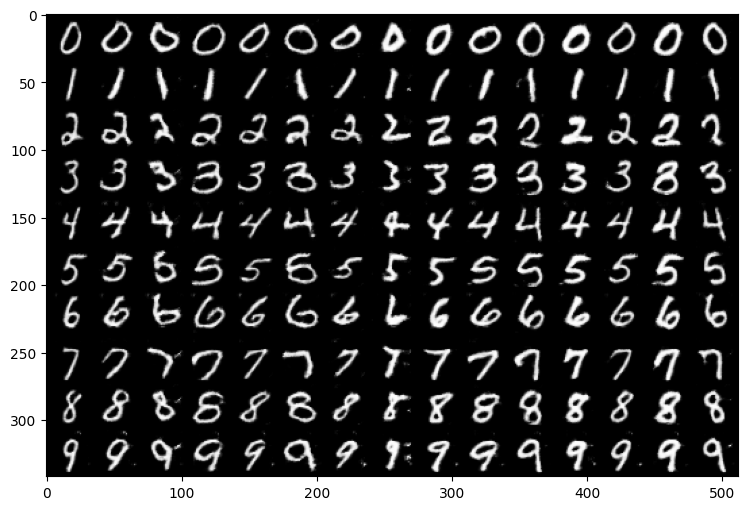

In [77]:
n_ex = 15
n_classes = 10

z = sample_z(n_ex, nz).repeat(n_classes, 1) #.expand(10, nz)

netG.eval()

labels = torch.arange(n_classes).unsqueeze(0).reshape(-1, 1).repeat(1, n_ex).flatten().to(device)

ys = F.one_hot(labels).float()
fake_ims = netG(z, ys)

un_norm= renorm(fake_ims) # for visualization
grid = torchvision.utils.make_grid(un_norm, nrow=n_ex)
pil_grid = to_pil(grid)

plt.imshow(pil_grid)
plt.show()
